imports and txt file readings

In [44]:
import cv2
import sys
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import torch
import re

sys.path.append('models/SuperGlue')
from models.superpoint import SuperPoint
from models.superglue import SuperGlue
from torchvision import transforms 

pathname = input("Please input the path name (for pose estimation)")
# pathname = Path(pathname)

# Open the cam1, cam2 text files
with open(pathname + '\cam1.txt', 'r') as file:
    # Read the content of the file
    content1 = file.read()
    
with open(pathname + '\cam2.txt', 'r') as file:
    # Read the content of the file
    content2 = file.read()

print(content1)
print(content2)


data\cam1_pose\cam1_20240912_120234_0001.png [[296, 81], [299, 75], [290, 72], [266, 71], [289, 133], [245, 120], [298, 196], [238, 184], [314, 240], [222, 248], [301, 244], [268, 247], [298, 342], [266, 345], [292, 429], [266, 446]]
data\cam1_pose\cam1_20240912_120234_0002.png [[296, 81], [299, 75], [290, 72], [266, 71], [290, 133], [246, 119], [298, 195], [237, 183], [315, 240], [220, 248], [301, 245], [267, 249], [298, 344], [266, 346], [292, 429], [267, 447]]
data\cam1_pose\cam1_20240912_120235_0003.png [[295, 80], [298, 75], [289, 71], [266, 71], [289, 132], [245, 119], [298, 195], [236, 184], [316, 240], [218, 248], [302, 246], [266, 252], [299, 344], [266, 346], [292, 429], [267, 447]]
data\cam1_pose\cam1_20240912_120235_0004.png [[293, 80], [296, 74], [288, 71], [263, 70], [288, 132], [244, 119], [297, 193], [234, 185], [317, 240], [217, 249], [302, 247], [266, 253], [298, 345], [265, 348], [292, 429], [267, 447]]
data\cam1_pose\cam1_20240912_120235_0005.png [[292, 78], [295, 7

Pairing (watch the match part logic)

In [45]:
lines_1 = content1.strip().splitlines()
lines_2 = content2.strip().splitlines()

sample = lines_1[0]

init_index = sample.find("cam")
first_index = sample.find("cam", init_index+1) + 5

second_index = first_index + 20


for line_2 in lines_2:
    matching_line_1 = next((line for line in lines_1 if line[first_index:second_index] == line_2[first_index:second_index]), None)
    if matching_line_1:
        # Use regex to split the address and coordinates
        match1 = re.match(r'([^ ]+) (\[\[.*\]\])', matching_line_1) 
        if match1:
            address1 = match1.group(1)
            coordinates1 = eval(match1.group(2))  # Convert the string of coordinates to a list of lists
        match2 = re.match(r'([^ ]+) (\[\[.*\]\])', line_2)
        if match2:
            address2 = match2.group(1)
            coordinates2 = eval(match2.group(2))  # Convert the string of coordinates to a list of lists
        # print(f"{address1, coordinates1}\n with {address2,coordinates2}")
        print(address1, "with", address2)

data\cam1_pose\cam1_20240912_120234_0001.png with data\cam2_pose\cam2_20240912_120234_0001.png
data\cam1_pose\cam1_20240912_120234_0002.png with data\cam2_pose\cam2_20240912_120234_0002.png
data\cam1_pose\cam1_20240912_120235_0003.png with data\cam2_pose\cam2_20240912_120235_0003.png
data\cam1_pose\cam1_20240912_120235_0004.png with data\cam2_pose\cam2_20240912_120235_0004.png
data\cam1_pose\cam1_20240912_120235_0005.png with data\cam2_pose\cam2_20240912_120235_0005.png
data\cam1_pose\cam1_20240912_120235_0006.png with data\cam2_pose\cam2_20240912_120235_0006.png
data\cam1_pose\cam1_20240912_120235_0007.png with data\cam2_pose\cam2_20240912_120235_0007.png
data\cam1_pose\cam1_20240912_120236_0008.png with data\cam2_pose\cam2_20240912_120236_0008.png
data\cam1_pose\cam1_20240912_120236_0009.png with data\cam2_pose\cam2_20240912_120236_0009.png
data\cam1_pose\cam1_20240912_120236_0010.png with data\cam2_pose\cam2_20240912_120236_0010.png
data\cam1_pose\cam1_20240912_120236_0011.png with 

extract the numbers(alternative way)

In [46]:

# matches = re.findall(r'\[\[.*?\]\]', content)
# extracted_lists = [eval(match) for match in matches]

# # Print the result
# for lst in extracted_lists:
#     print(lst)



In [47]:
# initialize the both module
config = {
    'superpoint': {
        'nms_radius': 4,
        'keypoint_threshold': 0.05,  # Adjusted threshold
        'max_keypoints': -1
    },
    'superglue': {
        'weights': 'outdoor',
        'sinkhorn_iterations': 20,
        'match_threshold': 0.05 # Adjusted match_threshold
    }
}

# Load models
def load_models(config):
    """
    load SuperPoint and Superpoint model
    
    :param config: initialize the model
    :return models: superpoint, superglue
    """
    superpoint = SuperPoint(config['superpoint'])
    superpoint.eval()
    superglue = SuperGlue(config['superglue'])
    superglue.eval()
    return superpoint, superglue

In [48]:

# Convert image to tensor
def image_to_tensor(image, device):
    """
    Change image to tensor form

    :param image: input image
    :param device: "cuda" if torch.cuda.is_available() else "cpu"
    :return output image: image with shape (b, c, h, w) which set to device
    """
    transform = transforms.Compose([
        transforms.ToPILImage(),
        transforms.Grayscale(num_output_channels=1),  # Convert to grayscale so the dimension will become 2 [height, weight]
        transforms.ToTensor(),
    ])
    return transform(image).unsqueeze(0).to(device)

# Extract features and descriptors
def extract_features(model, image_tensor): # model = superpoints 
    """
    Extract features of image

    :param model: models that extract the image (Superpoint)
    :param image: intput image in tensor form
    :return [keypoionts, descriptors, scores]: 
    """
    with torch.inference_mode():
        output = model({'image': image_tensor})
    # print("Keypoints shape:", output['keypoints'][0].shape)
    # print("Scores shape:", output['scores'][0].shape)
    # print("Descriptors shape:", output['descriptors'][0].shape)
    return output

# Match features between two sets of descriptors
def match_features(image1_tensor, keypoints1, desc1, scores1, image2_tensor, keypoints2, desc2, scores2, superglue):
    """
    Match features between two images using the SuperGlue model.

    :param image1_tensor: Tensor representation of the first image.
    :param keypoints1: Keypoints from the first image (list of [x, y] coordinates).
    :param desc1: Descriptors corresponding to the keypoints from the first image.
    :param scores1: Confidence scores for the keypoints in the first image.
    :param image2_tensor: Tensor representation of the second image.
    :param keypoints2: Keypoints from the second image (list of [x, y] coordinates).
    :param desc2: Descriptors corresponding to the keypoints from the second image.
    :param scores2: Confidence scores for the keypoints in the second image.
    :param superglue: The SuperGlue model used for feature matching.

    :return: 
        - matches: Array of indices indicating which keypoints in image 1 match with those in image 2. 
          A value of -1 indicates no match for that keypoint.
        - num_matches: Total number of valid matches found between the two images.
        - match_confidences: Confidence scores for each match, corresponding to `matches`.
    """
    device = next(superglue.parameters()).device  # Get device of superglue_model

    # Move inputs to the same device as the model
    keypoints1 = torch.tensor(keypoints1, dtype=torch.float32, device=device).unsqueeze(0)
    keypoints2 = torch.tensor(keypoints2, dtype=torch.float32, device=device).unsqueeze(0)
    desc1 = torch.tensor(desc1, dtype=torch.float32, device=device).unsqueeze(0)
    desc2 = torch.tensor(desc2, dtype=torch.float32, device=device).unsqueeze(0)
    scores1 = torch.tensor(scores1, dtype=torch.float32, device=device).unsqueeze(0)
    scores2 = torch.tensor(scores2, dtype=torch.float32, device=device).unsqueeze(0)
    image1_tensor = image1_tensor.to(device)
    image2_tensor = image2_tensor.to(device)

    # Prepare data dictionary for SuperGlue
    data = {
        'keypoints0': keypoints1,
        'keypoints1': keypoints2,
        'descriptors0': desc1,
        'descriptors1': desc2,
        'scores0': scores1,
        'scores1': scores2,
        'image0': image1_tensor,
        'image1': image2_tensor
    }
    
    with torch.inference_mode():
        output = superglue(data)
    
    # Extract matches and confidences
    matches = output['matches0'][0].cpu().numpy()
    match_confidences = output['matching_scores0'][0].cpu().numpy()

    # print(f"Number of matches found: {np.sum(matches > -1)}")
    # print(f"Matches array: {matches}")

    num_matches = np.sum(matches > -1)
    
    return matches, num_matches, match_confidences

def visualize_matches(image1, keypoints1, image2, keypoints2, matches, scores1, scores2, confidences, counting):
    """
    Visualize the matching keypoints between two images.

    :param image1: The first image (RGB format).
    :param keypoints1: Keypoints detected in the first image (list of [x, y] coordinates).
    :param image2: The second image (RGB format).
    :param keypoints2: Keypoints detected in the second image (list of [x, y] coordinates).
    :param matches: Array of match indices where each value is the index of the matched keypoint 
                    in the second image, or -1 if there is no match.
    :param scores1: Confidence scores for the keypoints in the first image.
    :param scores2: Confidence scores for the keypoints in the second image.
    :param confidences: Confidence scores of the matches between the two images.
    :param counting: An identifier for the current visualization, typically used to distinguish between multiple comparisons.

    :return: None. visualize matches between the two images.
    """
    keypoints1 = np.array(keypoints1)
    keypoints2 = np.array(keypoints2)
    scores1 = np.array(scores1)
    scores2 = np.array(scores2)

    plt.figure(figsize=(10, 10))
    plt.imshow(np.hstack([image1, image2]))
    
    plt.scatter(keypoints1[:, 0], keypoints1[:, 1], c=scores1, cmap='jet', s=10, label='Keypoints 1')
    plt.scatter(keypoints2[:, 0] + image1.shape[1], keypoints2[:, 1], c=scores2, cmap='jet', s=10, label='Keypoints 2')

    for i, match in enumerate(matches):
        if match > -1:
            confidence = confidences[i]
            plt.plot([keypoints1[i, 0], keypoints2[match, 0] + image1.shape[1]],
                     [keypoints1[i, 1], keypoints2[match, 1]], color=plt.cm.jet(confidence), lw=1)
    
    plt.legend()
    plt.colorbar(label='Confidence')
    plt.title(f"Image {counting} compares")
    plt.show()  # Display the plot


def display_keypoints(keypoints, title="keypoints"):
    '''
    display keypoints DataFrame using pandas
    '''
    df = pd.DataFrame(keypoints, columns = ['x', 'y'])
    display(df)


def get_matching_keypoints_indices(keypoints_hrnet, keypoints_superpoint, tolerance_range):
    """
    Filter keypoints based on whether they match descriptor keypoints within a given tolerance range.
    
    :param keypoints: List of [x, y] keypoints from the HigherHRNet.
    :param descriptor_keypoints: List of [x, y] keypoints from superglue(superpoint model) .
    :param tolerance_range: Maximum allowed difference between keypoints to consider a match(ensure we can get an approximately points).
    
    :return: Filtered list of matching keypoints and its indices from keypoints_superpoint that match the keypoints_hrnet.

    """
    matching_keypoints = []
    matching_indices = []
    total_error = 0
    for kp in keypoints_hrnet:
        for idx, desc_kp in enumerate(keypoints_superpoint):
            # Check if both x and y are within the tolerance range
            total_error += abs(kp[0] - desc_kp[0])
            total_error += abs(kp[1] - desc_kp[1])
            if (abs(kp[0] - desc_kp[0]) <= tolerance_range and
                abs(kp[1] - desc_kp[1]) <= tolerance_range):
                matching_indices.append(idx)
                matching_keypoints.append(kp)
                break  # Stop checking other descriptor keypoints for this keypoint
    print(total_error/idx)
    return matching_keypoints, matching_indices

def superpoint_process(path_image):
    """
    Process an image to extract keypoints, scores, and descriptors using SuperPoint.

    :param path_image: Path to the image file.
    :return A list containing keypoints, scores, descriptors, and the image tensor:
             [keypoints, scores, descriptors, image_tensor] -> NumPy array
    """
    # Load and preprocess images
    image_path = path_image
    image = cv2.imread(image_path)
    if image is None:
        raise FileNotFoundError(f"Image at {image_path} could not be loaded.")

    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image_tensor = image_to_tensor(image_rgb, device)

    # Extract features from the first image
    features = extract_features(superpoint, image_tensor)

    keypoints = features['keypoints'][0].cpu().numpy() # Numpy array doesn't support gpu, and we need Numpy array to do further visulization
    scores = features['scores'][0].cpu().numpy()
    descriptors = features['descriptors'][0].cpu().numpy()

    return [keypoints, scores, descriptors, image_tensor]

def return_match_keypoints(keypoints_1, keypoints_2, matches, confidences):
    """
    Retrieve matched keypoints and their confidence scores.

    :param keypoints_1: List of keypoints from the first image.
    :param keypoints_2: List of keypoints from the second image.
    :param matches: Array of match indices where each index points to the corresponding match in keypoints_2 or -1 if no match.
    :param confidences: Array of confidence scores associated with each match.
    :return: List containing matched keypoints from both images along with their confidence scores.
    """
    result = []
    for i, match_idx in enumerate(matches):
        if match_idx > -1 and match_idx < len(keypoints_2):
            result.extend([keypoints_1[i], keypoints_2[match_idx], [confidences[i]]])
            '''kp1 = keypoints1[i]  # Keypoint in the first image
            kp2 = keypoints2[match_idx]  # Corresponding matched keypoint in the second image
            confidence = min(scores0[i], scores1[match_idx])  # Use the minimum confidence of both directions
            matched_keypoints.append((kp1, kp2, confidence))'''

    return result




Initialization of parameters and txt file

In [49]:
# set superpoints and superglue to device, which we want cuda
device = 'cuda' if torch.cuda.is_available() else 'cpu'
superpoint, superglue = load_models(config)
superpoint = superpoint.to(device)
superglue = superglue.to(device)

lines_1 = content1.strip().splitlines()
lines_2 = content2.strip().splitlines()

folder_match = pathname + "/cam_match"
if os.path.exists(f"{folder_match}.txt"):
    os.remove(f"{folder_match}.txt")
    print("Previous txt file has been deleted.")

Loaded SuperPoint model


c:\Users\rensl\Documents\Final_Project - Copy\models/SuperGlue\models\superpoint.py:137: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.load_state_dict(torch.load(str(pa

Loaded SuperGlue model ("outdoor" weights)


Main Loop

2061.81797752809
1954.64161849711
filtered_keypoints_1.shape for data\cam1_pose\cam1_20240912_120234_0001.png: (14, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20240912_120234_0001.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20240912_120234_0001.png: (256, 14)
descriptors_hrt2.shape for data\cam2_pose\cam2_20240912_120234_0001.png: (256, 15)


14 of keypoints are match


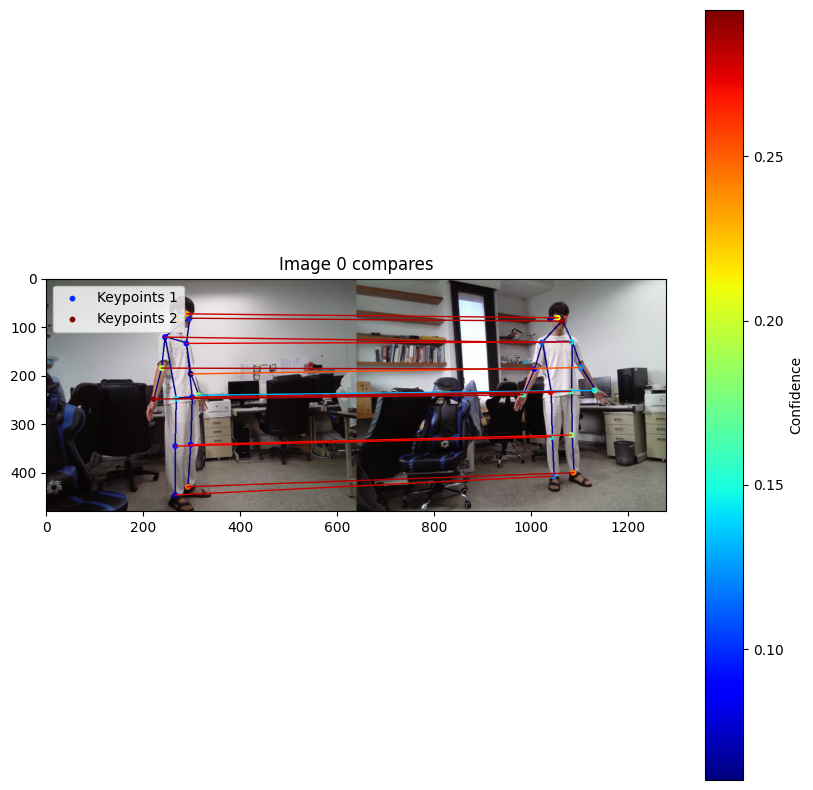

2047.341304347826
1996.889097744361
filtered_keypoints_1.shape for data\cam1_pose\cam1_20240912_120234_0002.png: (14, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20240912_120234_0002.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20240912_120234_0002.png: (256, 14)
descriptors_hrt2.shape for data\cam2_pose\cam2_20240912_120234_0002.png: (256, 15)


14 of keypoints are match


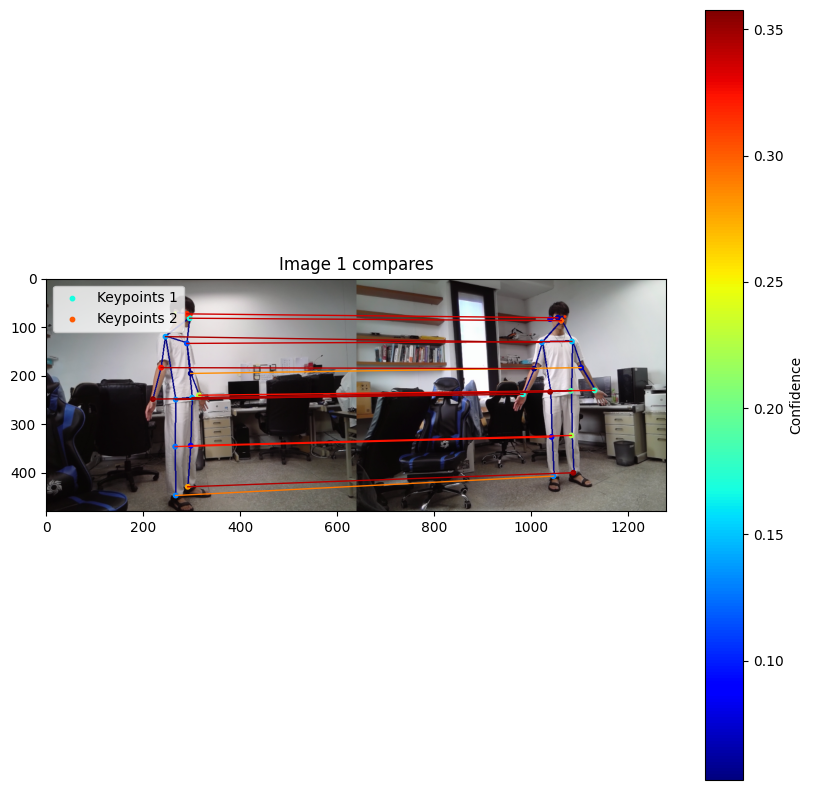

2092.0949227373067
1993.506641366224
filtered_keypoints_1.shape for data\cam1_pose\cam1_20240912_120235_0003.png: (14, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20240912_120235_0003.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20240912_120235_0003.png: (256, 14)
descriptors_hrt2.shape for data\cam2_pose\cam2_20240912_120235_0003.png: (256, 15)


14 of keypoints are match


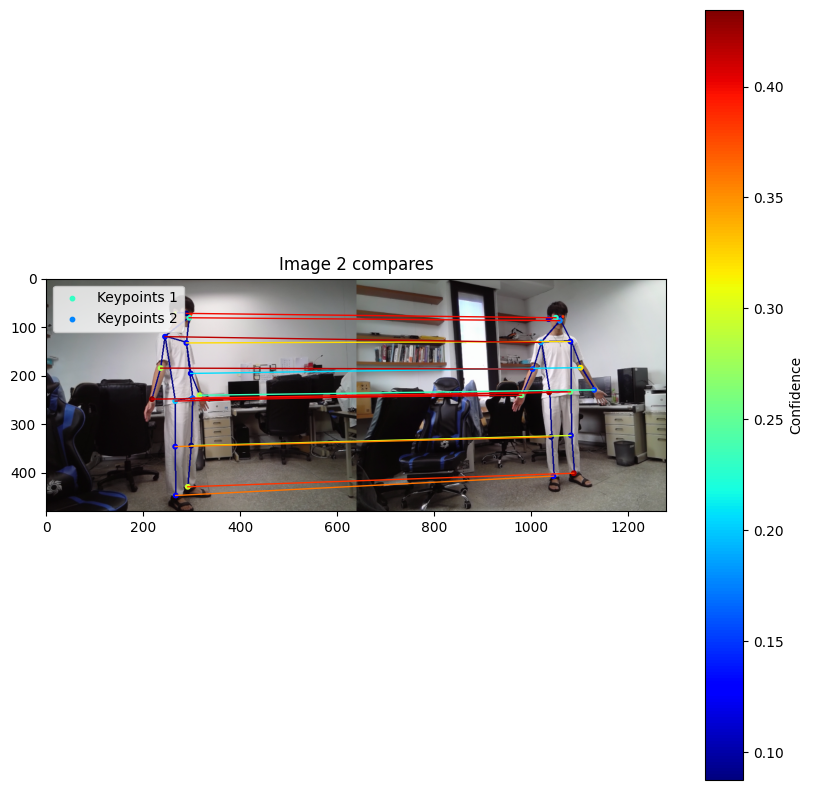

1706.5458515283842
2097.8585086042067
filtered_keypoints_1.shape for data\cam1_pose\cam1_20240912_120235_0004.png: (15, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20240912_120235_0004.png: (14, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20240912_120235_0004.png: (256, 15)
descriptors_hrt2.shape for data\cam2_pose\cam2_20240912_120235_0004.png: (256, 14)


12 of keypoints are match


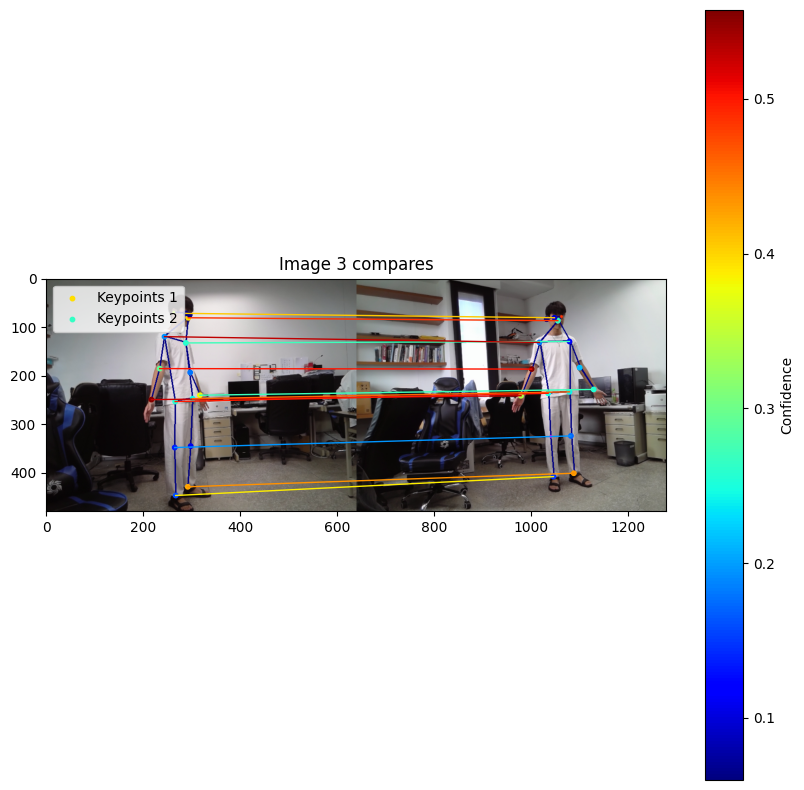

2072.2892376681616
1582.1814671814673
filtered_keypoints_1.shape for data\cam1_pose\cam1_20240912_120235_0005.png: (14, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20240912_120235_0005.png: (17, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20240912_120235_0005.png: (256, 14)
descriptors_hrt2.shape for data\cam2_pose\cam2_20240912_120235_0005.png: (256, 17)


14 of keypoints are match


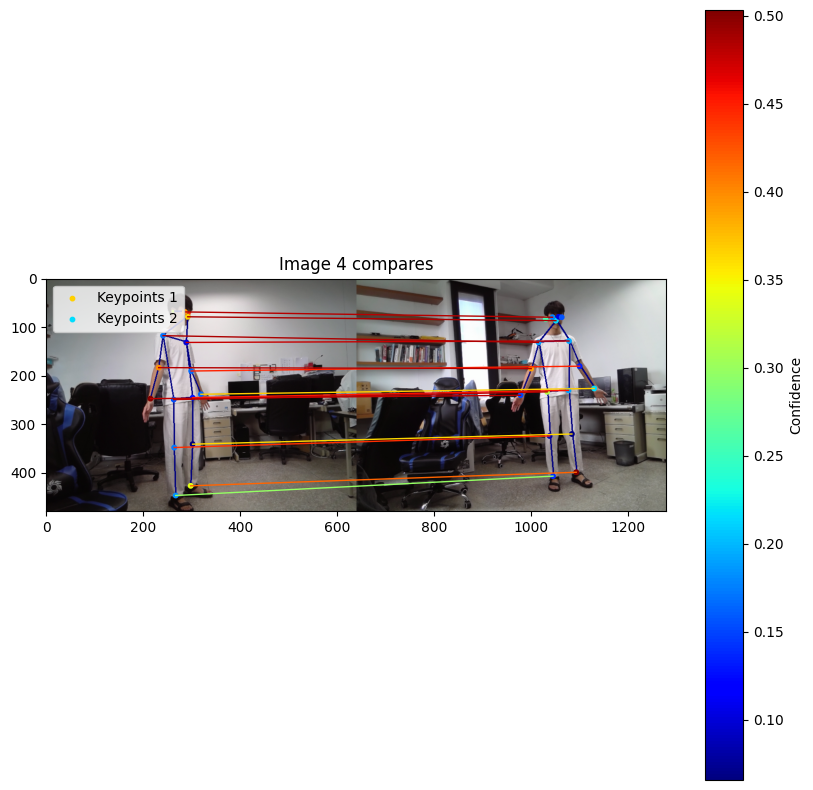

1861.6696035242292
1569.9583333333333
filtered_keypoints_1.shape for data\cam1_pose\cam1_20240912_120235_0006.png: (14, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20240912_120235_0006.png: (17, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20240912_120235_0006.png: (256, 14)
descriptors_hrt2.shape for data\cam2_pose\cam2_20240912_120235_0006.png: (256, 17)


14 of keypoints are match


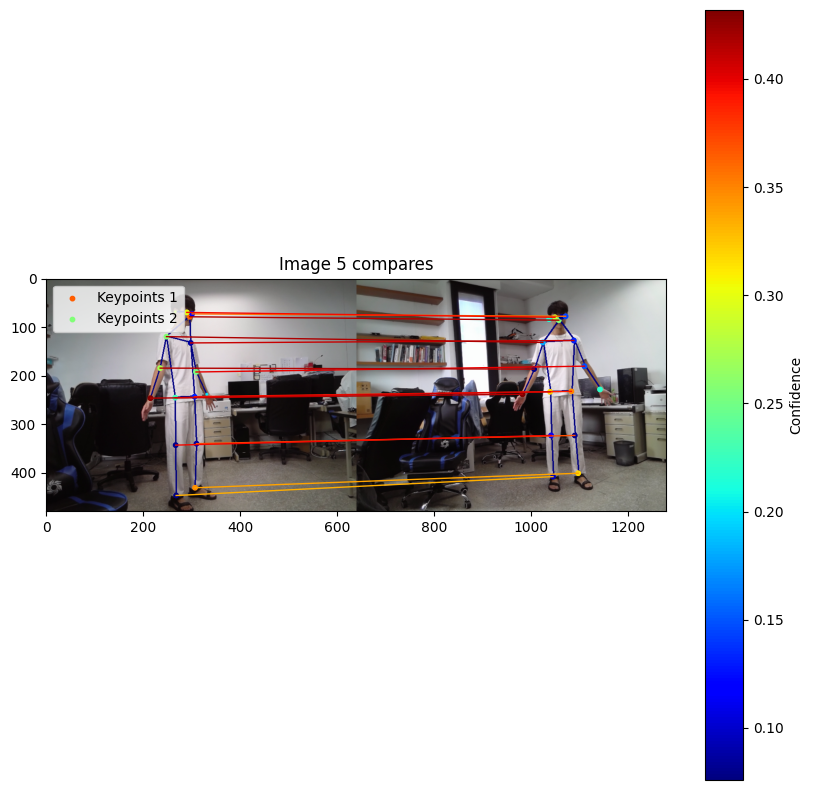

1902.4017857142858
1573.4822429906542
filtered_keypoints_1.shape for data\cam1_pose\cam1_20240912_120235_0007.png: (14, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20240912_120235_0007.png: (17, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20240912_120235_0007.png: (256, 14)
descriptors_hrt2.shape for data\cam2_pose\cam2_20240912_120235_0007.png: (256, 17)


13 of keypoints are match


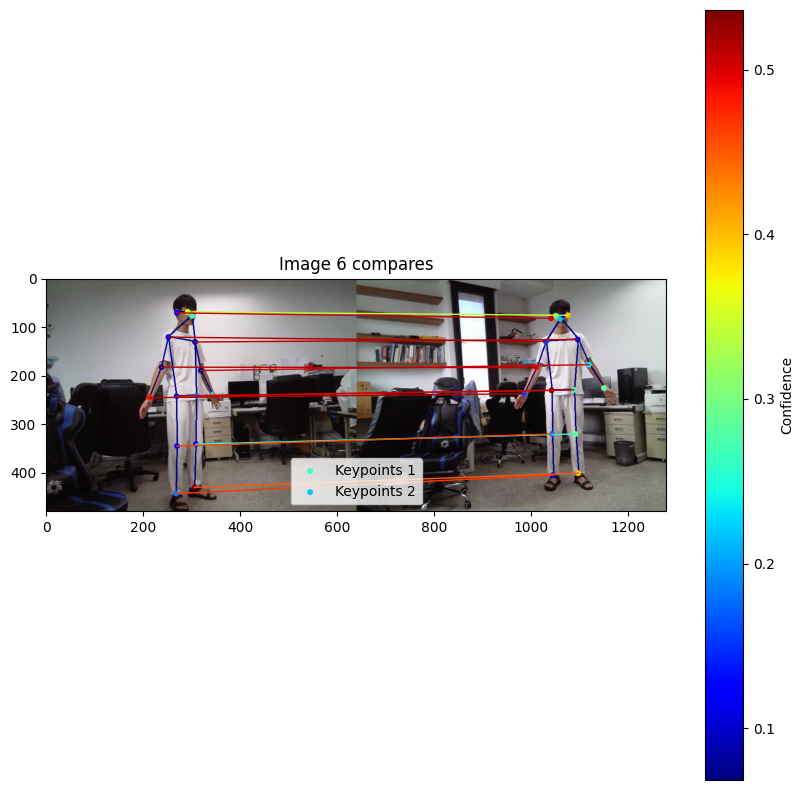

1713.7654867256638
1601.8180112570356
filtered_keypoints_1.shape for data\cam1_pose\cam1_20240912_120236_0008.png: (15, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20240912_120236_0008.png: (17, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20240912_120236_0008.png: (256, 15)
descriptors_hrt2.shape for data\cam2_pose\cam2_20240912_120236_0008.png: (256, 17)


15 of keypoints are match


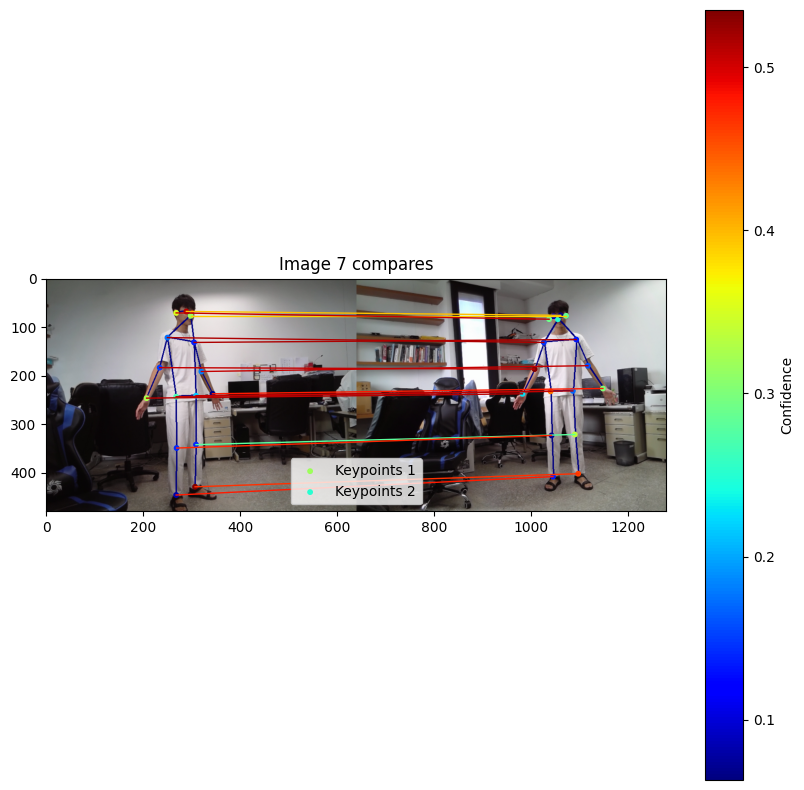

1898.9844444444445
2100.972815533981
filtered_keypoints_1.shape for data\cam1_pose\cam1_20240912_120236_0009.png: (14, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20240912_120236_0009.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20240912_120236_0009.png: (256, 14)
descriptors_hrt2.shape for data\cam2_pose\cam2_20240912_120236_0009.png: (256, 15)


13 of keypoints are match


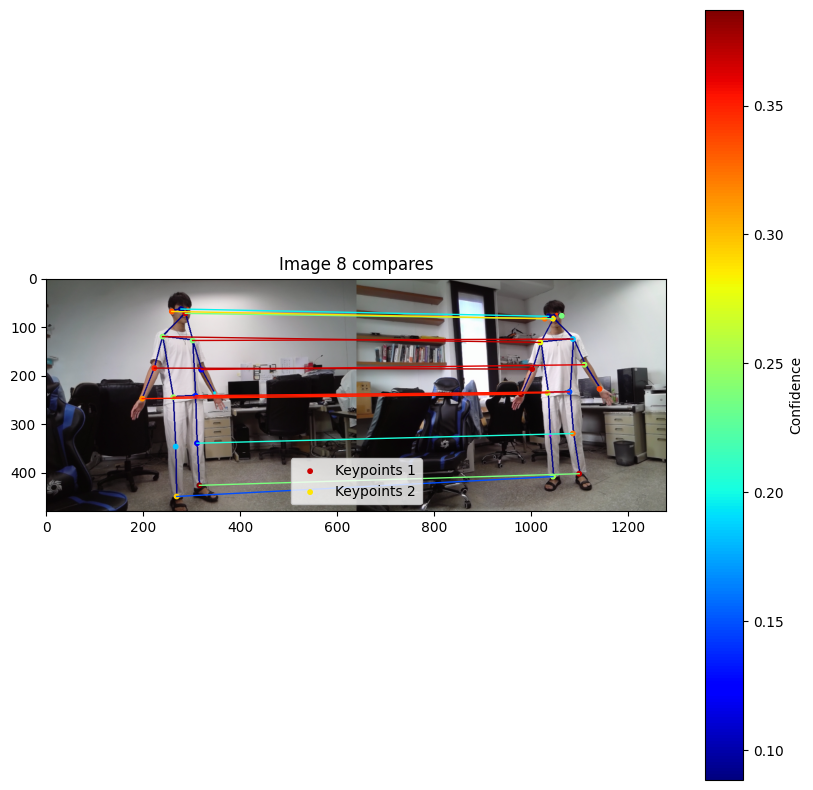

1326.5874439461884
2024.8339768339767
filtered_keypoints_1.shape for data\cam1_pose\cam1_20240912_120236_0010.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20240912_120236_0010.png: (16, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20240912_120236_0010.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20240912_120236_0010.png: (256, 16)


14 of keypoints are match


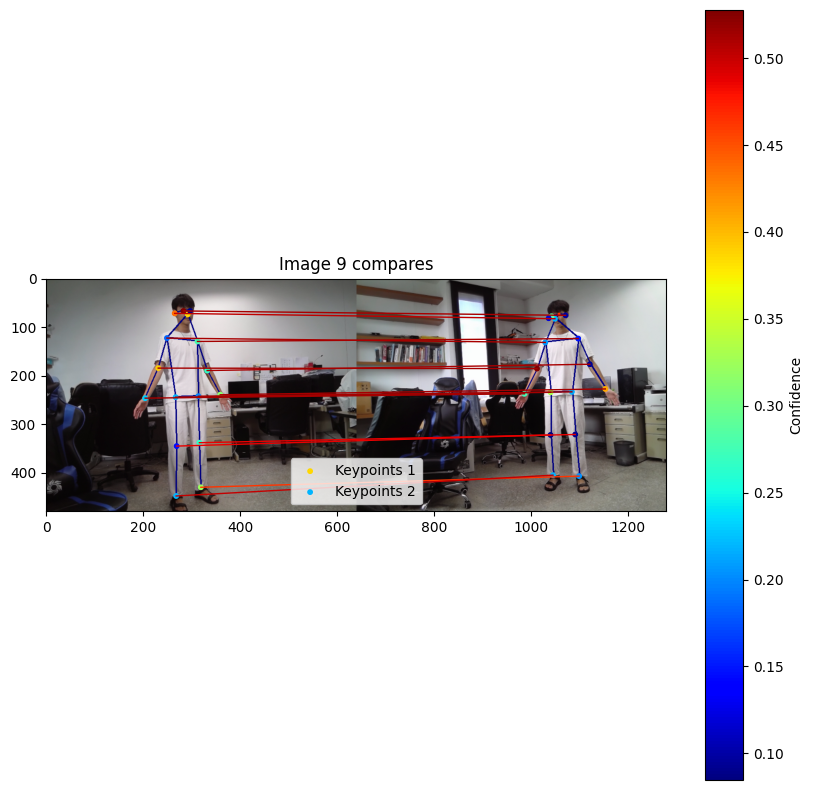

1328.918181818182
1655.4378585086042
filtered_keypoints_1.shape for data\cam1_pose\cam1_20240912_120236_0011.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20240912_120236_0011.png: (16, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20240912_120236_0011.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20240912_120236_0011.png: (256, 16)


15 of keypoints are match


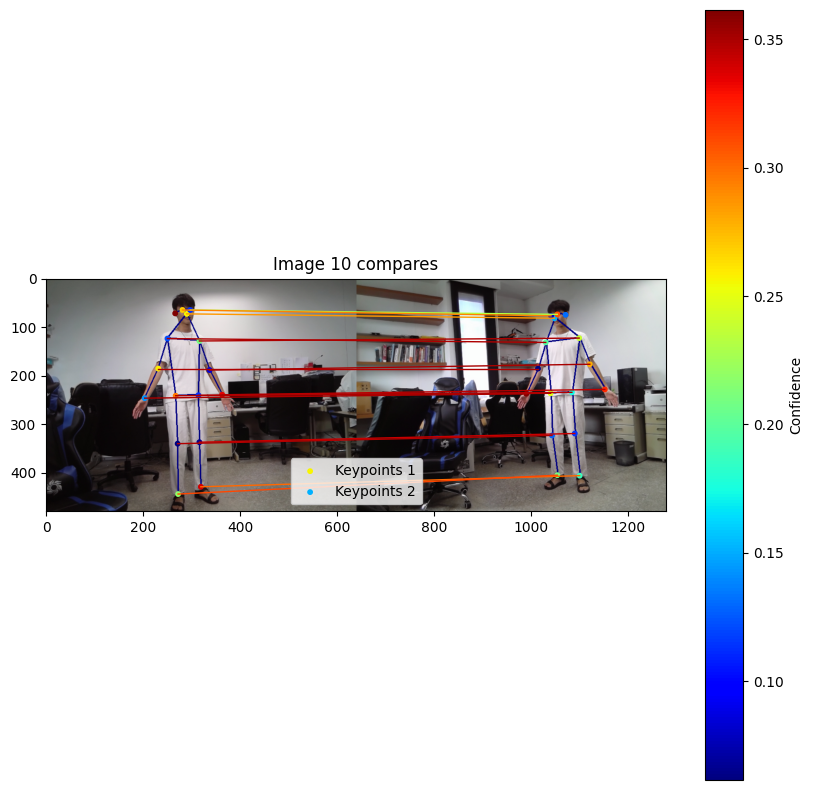

1323.6369710467707
1680.6216730038022
filtered_keypoints_1.shape for data\cam1_pose\cam1_20240912_120237_0012.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20240912_120237_0012.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20240912_120237_0012.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20240912_120237_0012.png: (256, 15)


13 of keypoints are match


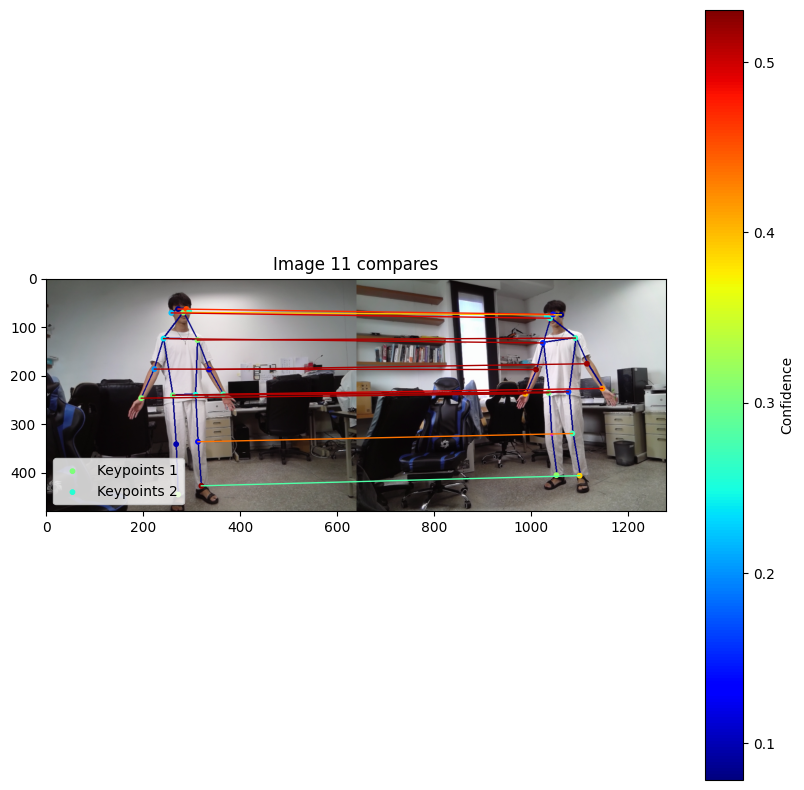

1313.4810126582279
1618.9064885496184
filtered_keypoints_1.shape for data\cam1_pose\cam1_20240912_120237_0013.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20240912_120237_0013.png: (16, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20240912_120237_0013.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20240912_120237_0013.png: (256, 16)


15 of keypoints are match


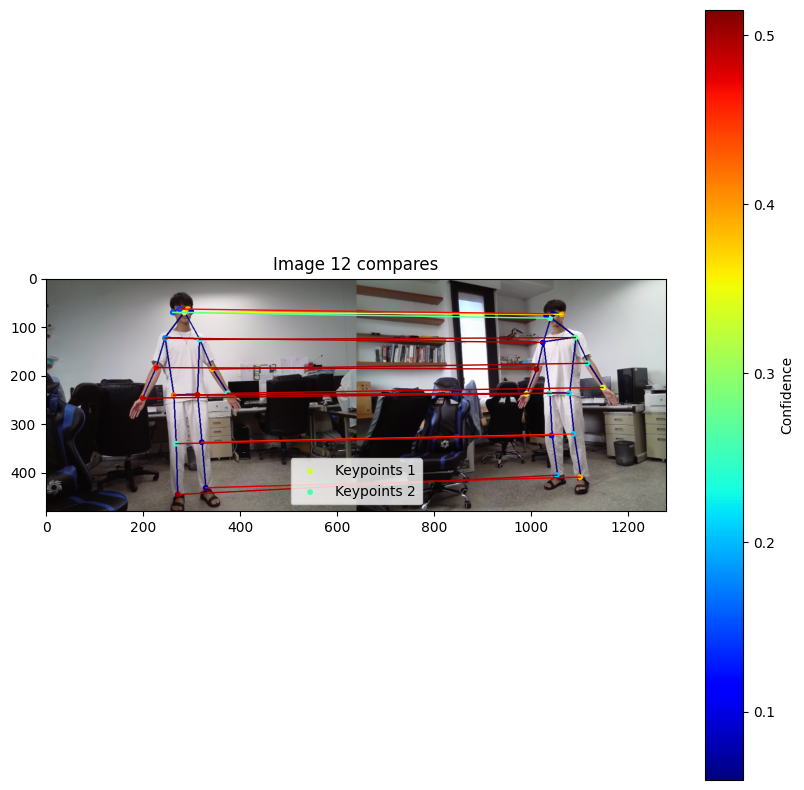

1343.7961373390558
1634.4913627639155
filtered_keypoints_1.shape for data\cam1_pose\cam1_20240912_120237_0014.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20240912_120237_0014.png: (16, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20240912_120237_0014.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20240912_120237_0014.png: (256, 16)


16 of keypoints are match


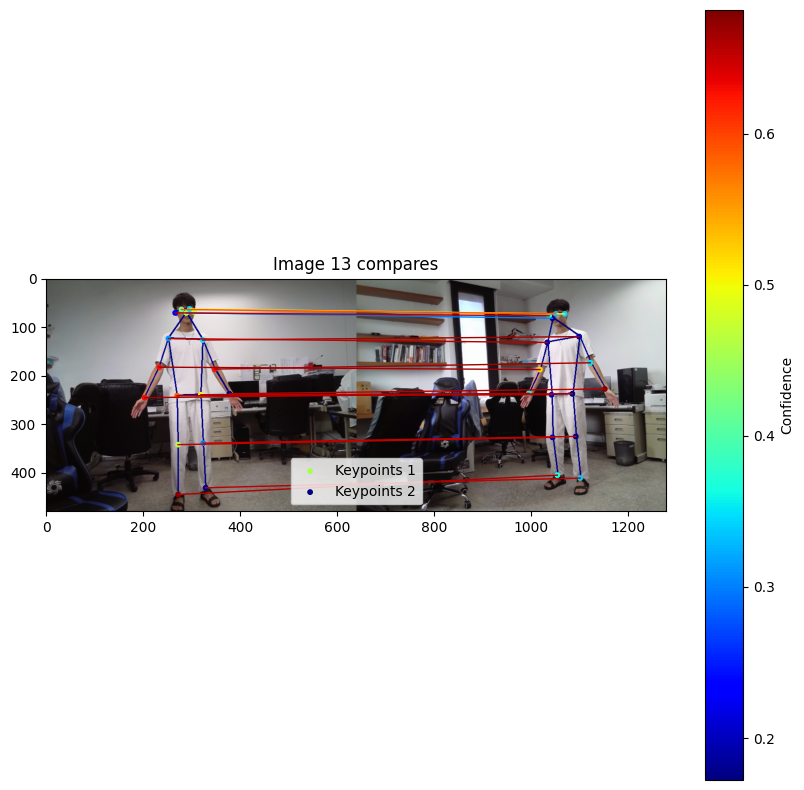

1323.3149779735684
1672.7071290944123
filtered_keypoints_1.shape for data\cam1_pose\cam1_20240912_120237_0015.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20240912_120237_0015.png: (16, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20240912_120237_0015.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20240912_120237_0015.png: (256, 16)


16 of keypoints are match


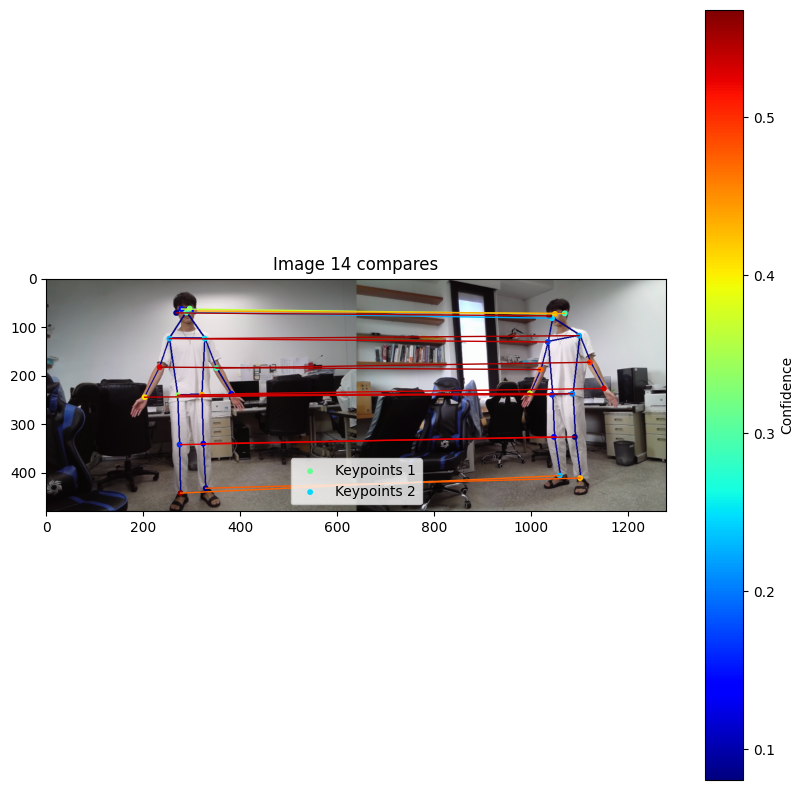

1398.609071274298
1628.3257142857142
filtered_keypoints_1.shape for data\cam1_pose\cam1_20240912_120237_0016.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20240912_120237_0016.png: (16, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20240912_120237_0016.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20240912_120237_0016.png: (256, 16)


15 of keypoints are match


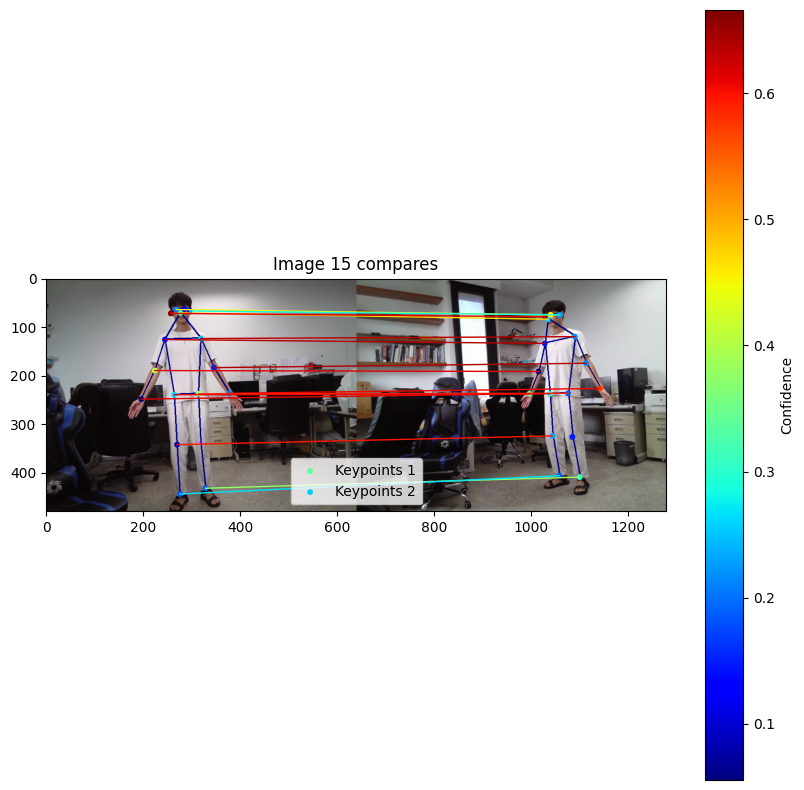

1314.5698689956332
1625.3473282442749
filtered_keypoints_1.shape for data\cam1_pose\cam1_20240912_120238_0017.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20240912_120238_0017.png: (16, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20240912_120238_0017.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20240912_120238_0017.png: (256, 16)


16 of keypoints are match


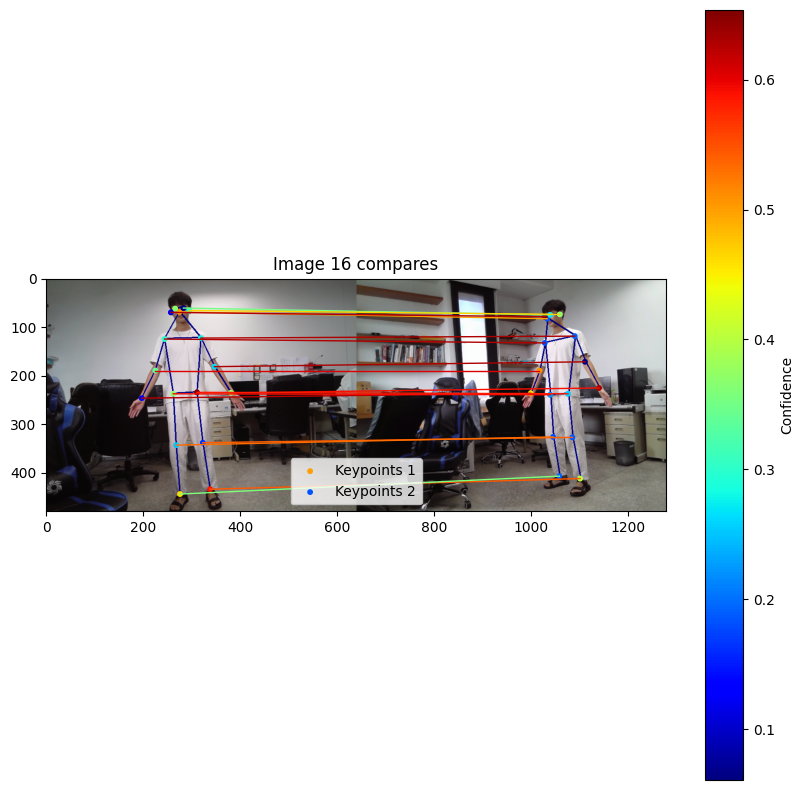

1330.2943722943724
1624.4809160305344
filtered_keypoints_1.shape for data\cam1_pose\cam1_20240912_120238_0018.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20240912_120238_0018.png: (16, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20240912_120238_0018.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20240912_120238_0018.png: (256, 16)


16 of keypoints are match


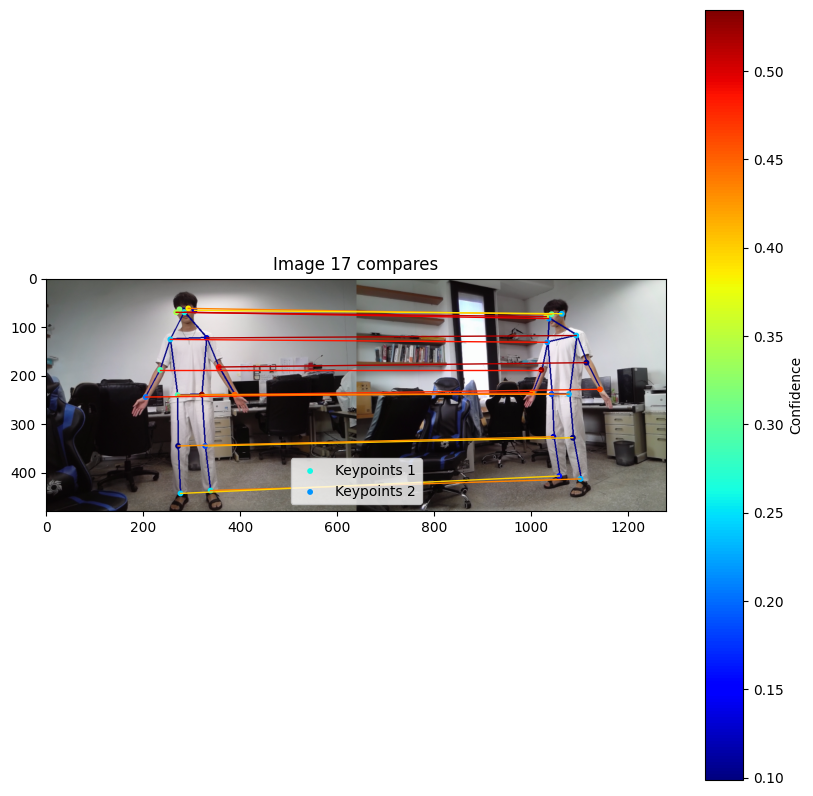

1296.9163179916318
1651.8595825426944
filtered_keypoints_1.shape for data\cam1_pose\cam1_20240912_120238_0019.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20240912_120238_0019.png: (16, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20240912_120238_0019.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20240912_120238_0019.png: (256, 16)


16 of keypoints are match


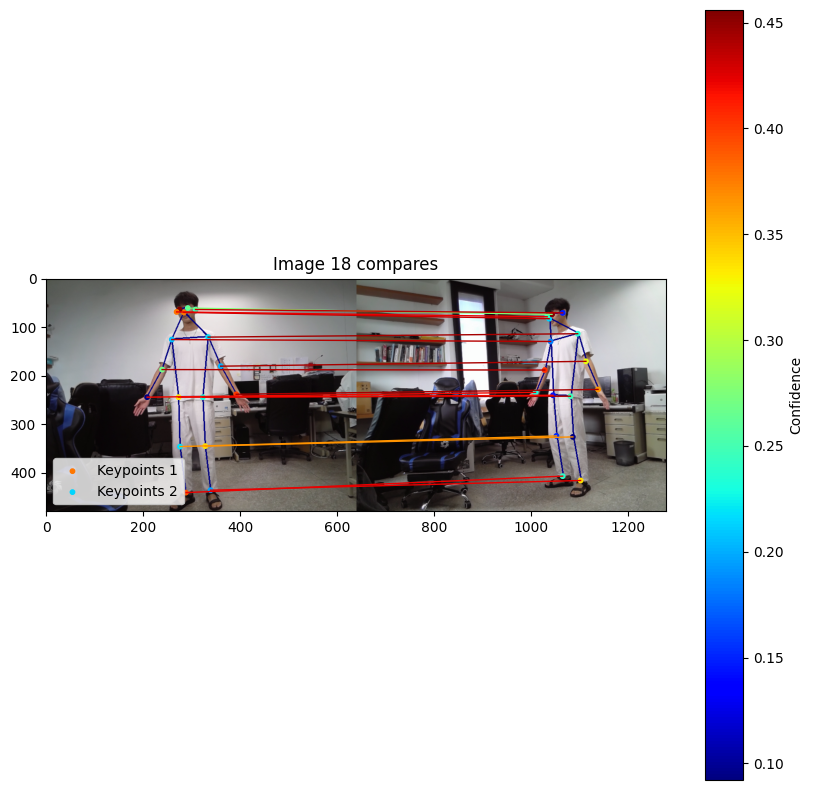

1322.0960698689955
2002.5330812854443
filtered_keypoints_1.shape for data\cam1_pose\cam1_20240912_120238_0020.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20240912_120238_0020.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20240912_120238_0020.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20240912_120238_0020.png: (256, 15)


15 of keypoints are match


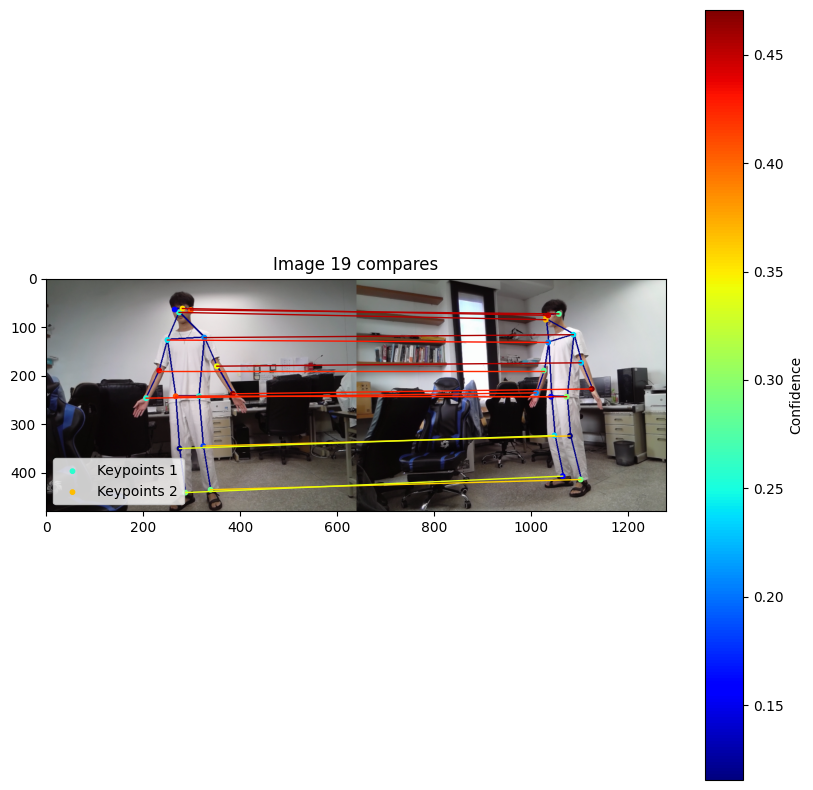

1518.2391304347825
1766.5259117082533
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205353_0000.png: (15, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205353_0000.png: (16, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205353_0000.png: (256, 15)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205353_0000.png: (256, 16)


15 of keypoints are match


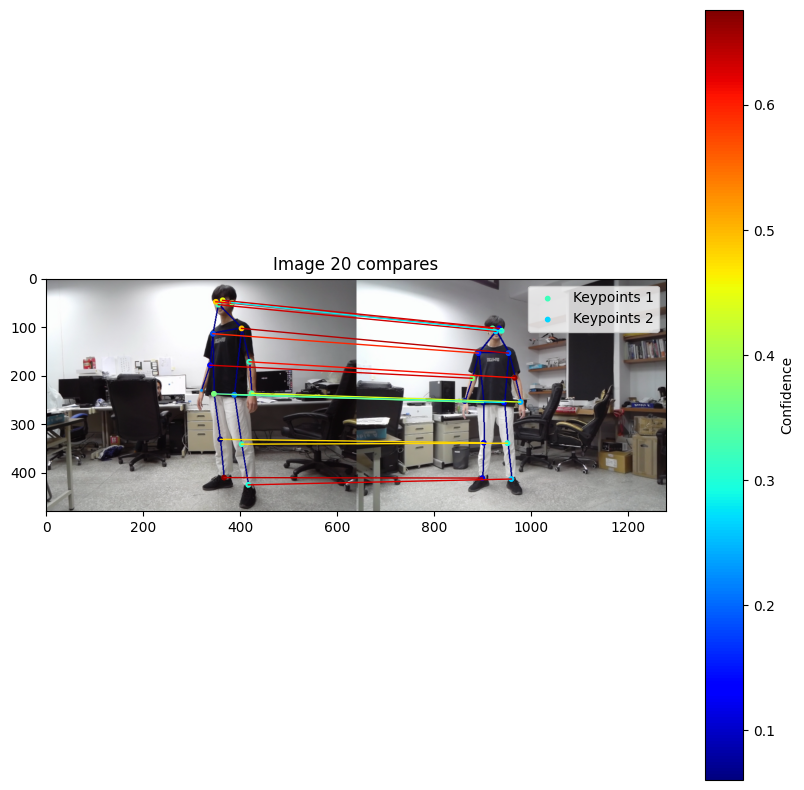

1322.9227467811158
1783.2794676806084
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205353_0001.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205353_0001.png: (16, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205353_0001.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205353_0001.png: (256, 16)


16 of keypoints are match


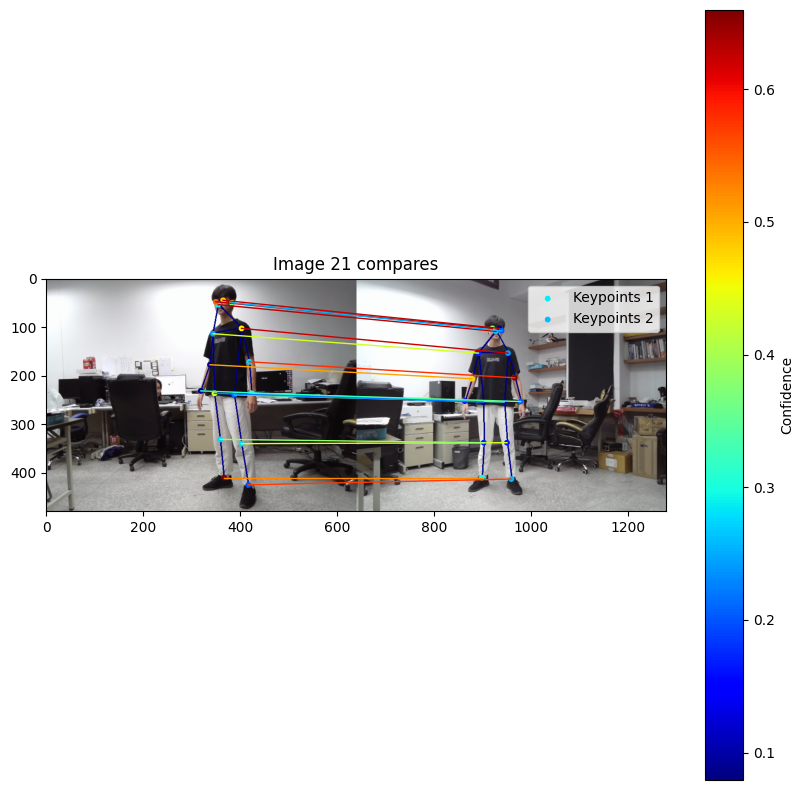

1493.9017094017095
1798.915547024952
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205353_0002.png: (15, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205353_0002.png: (16, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205353_0002.png: (256, 15)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205353_0002.png: (256, 16)


14 of keypoints are match


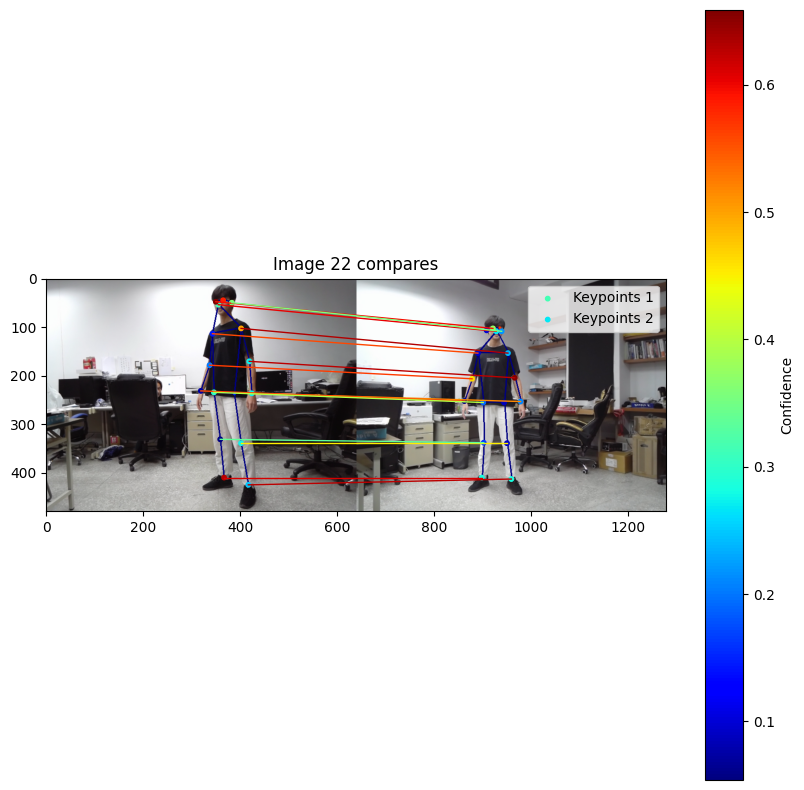

1715.1742919389978
1786.4990366088632
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205354_0003.png: (14, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205354_0003.png: (16, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205354_0003.png: (256, 14)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205354_0003.png: (256, 16)


13 of keypoints are match


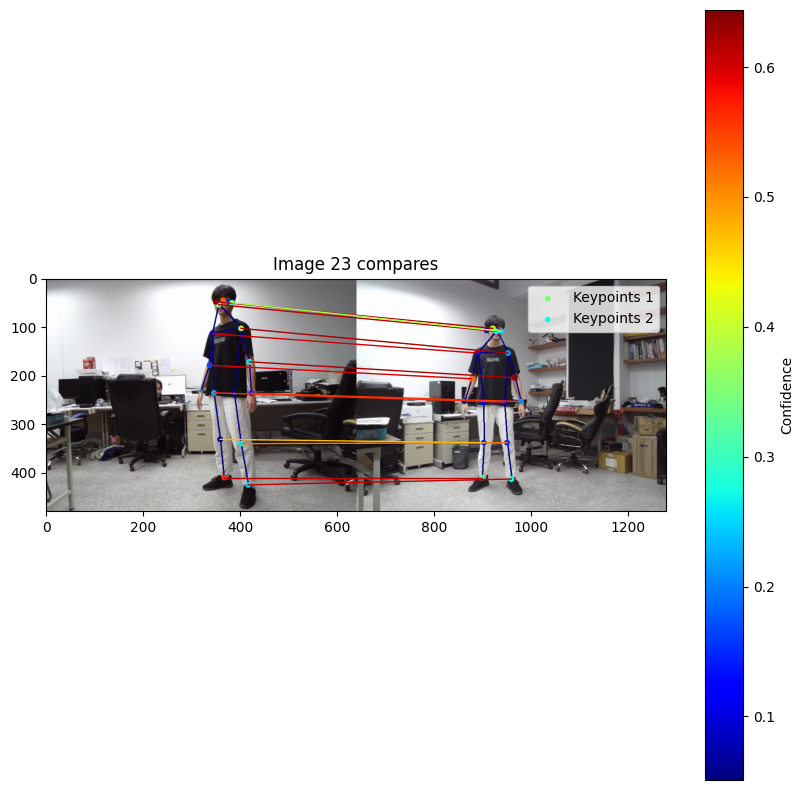

1910.1258134490238
1444.3257142857142
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205354_0004.png: (13, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205354_0004.png: (17, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205354_0004.png: (256, 13)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205354_0004.png: (256, 17)


13 of keypoints are match


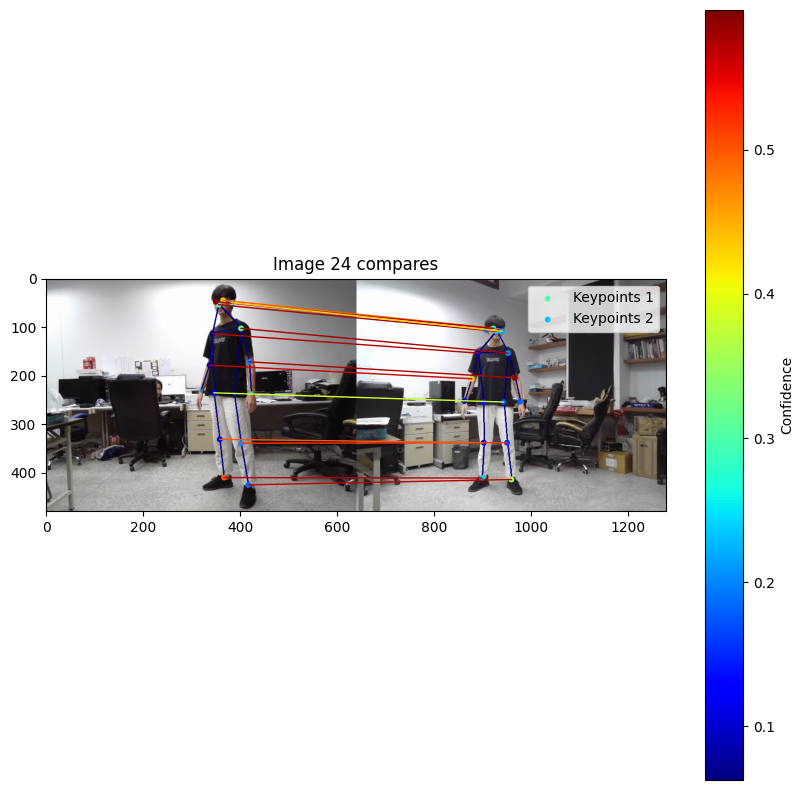

2000.7211328976034
1787.1730038022813
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205354_0005.png: (13, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205354_0005.png: (16, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205354_0005.png: (256, 13)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205354_0005.png: (256, 16)


12 of keypoints are match


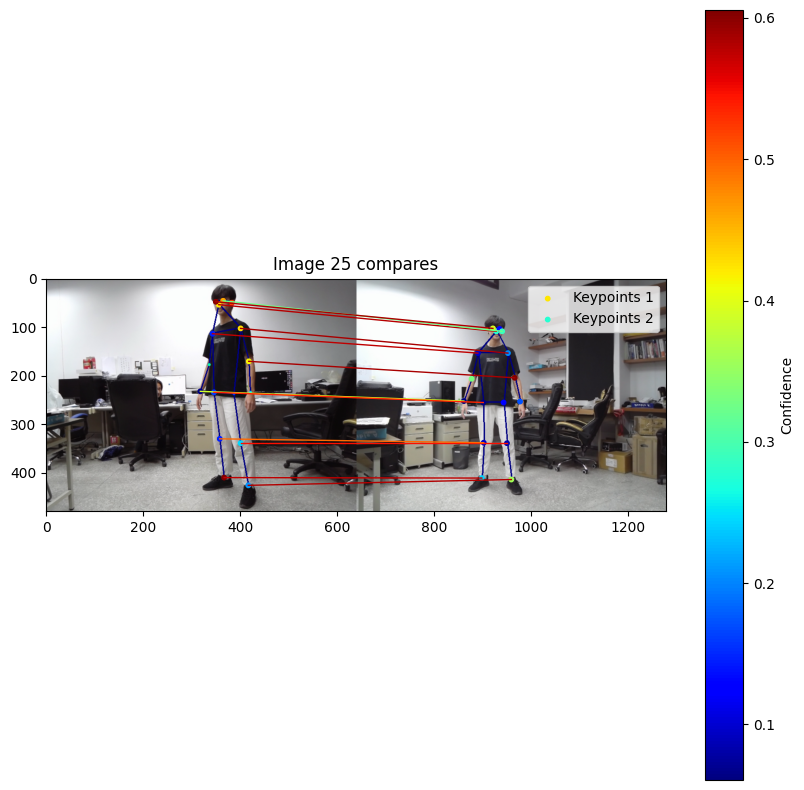

1915.7230769230769
1437.192380952381
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205354_0006.png: (13, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205354_0006.png: (17, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205354_0006.png: (256, 13)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205354_0006.png: (256, 17)


13 of keypoints are match


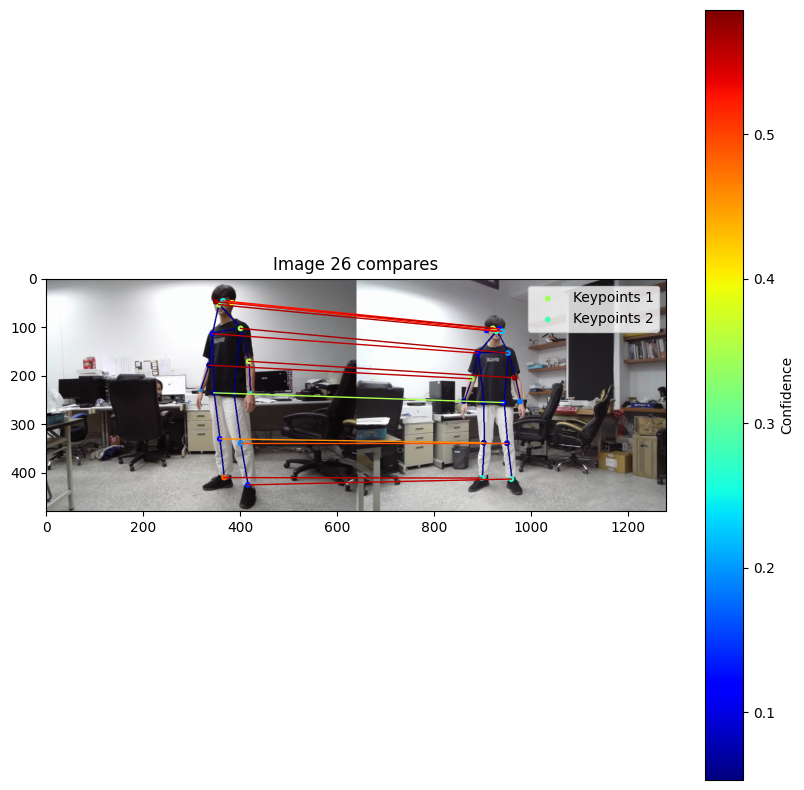

1517.3420479302831
1783.8252427184466
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205354_0007.png: (15, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205354_0007.png: (16, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205354_0007.png: (256, 15)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205354_0007.png: (256, 16)


14 of keypoints are match


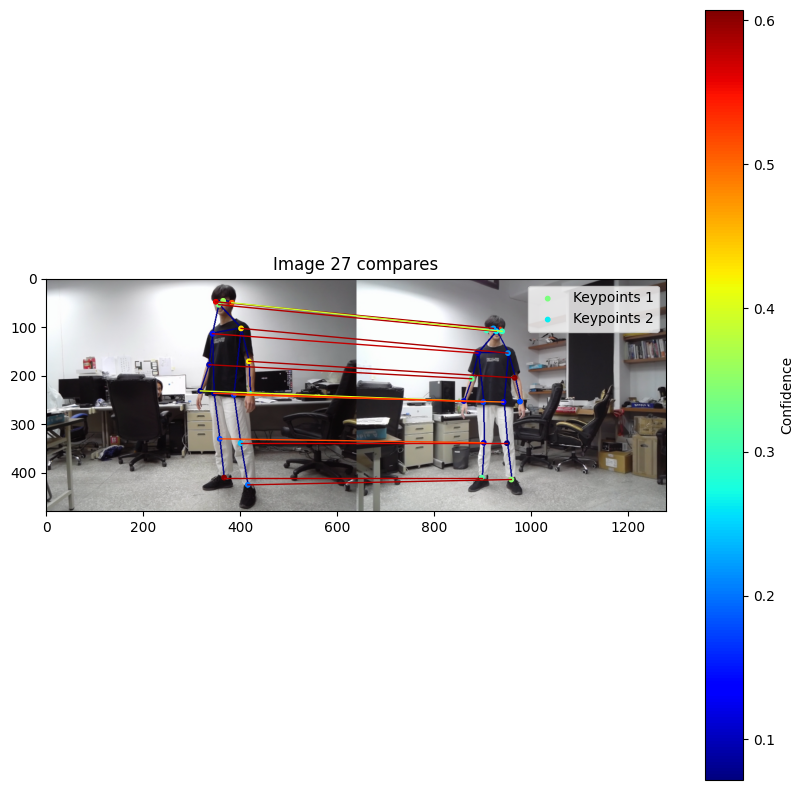

1726.3654266958424
1789.7076923076922
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205354_0008.png: (14, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205354_0008.png: (16, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205354_0008.png: (256, 14)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205354_0008.png: (256, 16)


14 of keypoints are match


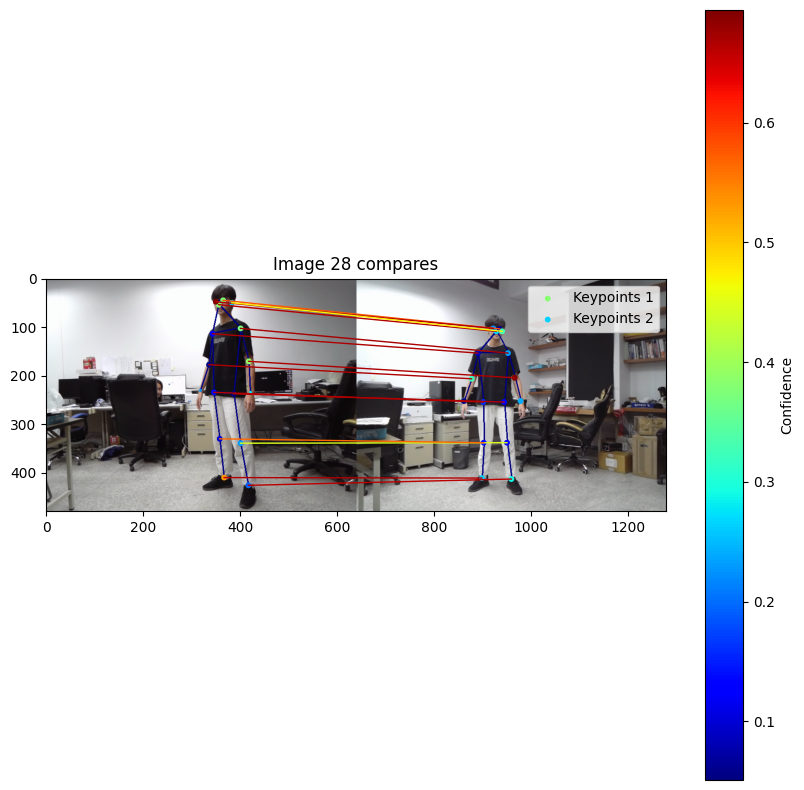

1920.952277657267
1793.5096899224807
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205354_0009.png: (13, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205354_0009.png: (16, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205354_0009.png: (256, 13)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205354_0009.png: (256, 16)


13 of keypoints are match


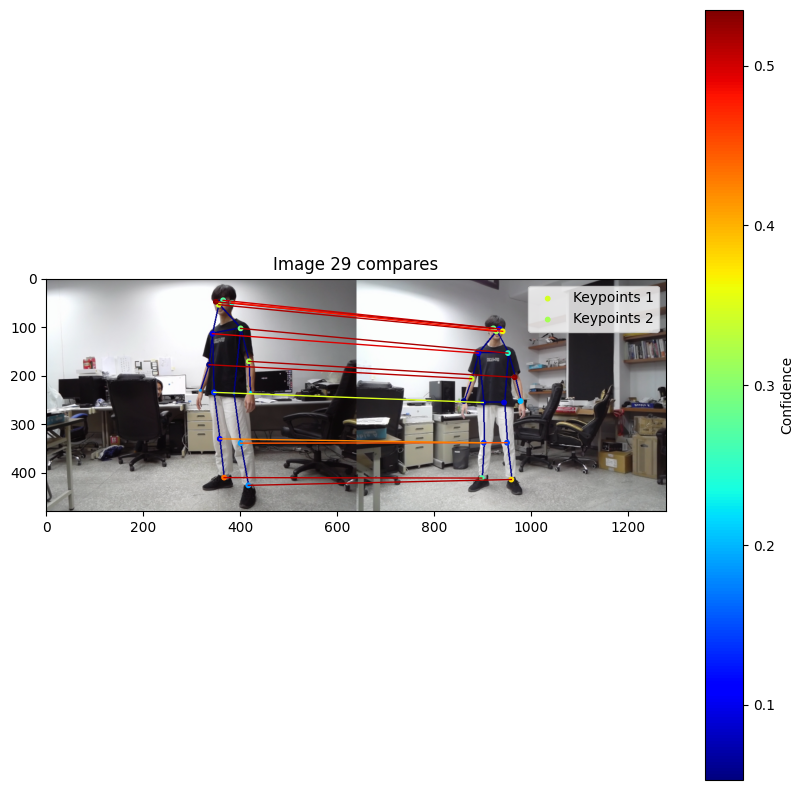

1704.3961038961038
1813.1519230769231
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205354_0010.png: (14, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205354_0010.png: (16, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205354_0010.png: (256, 14)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205354_0010.png: (256, 16)


13 of keypoints are match


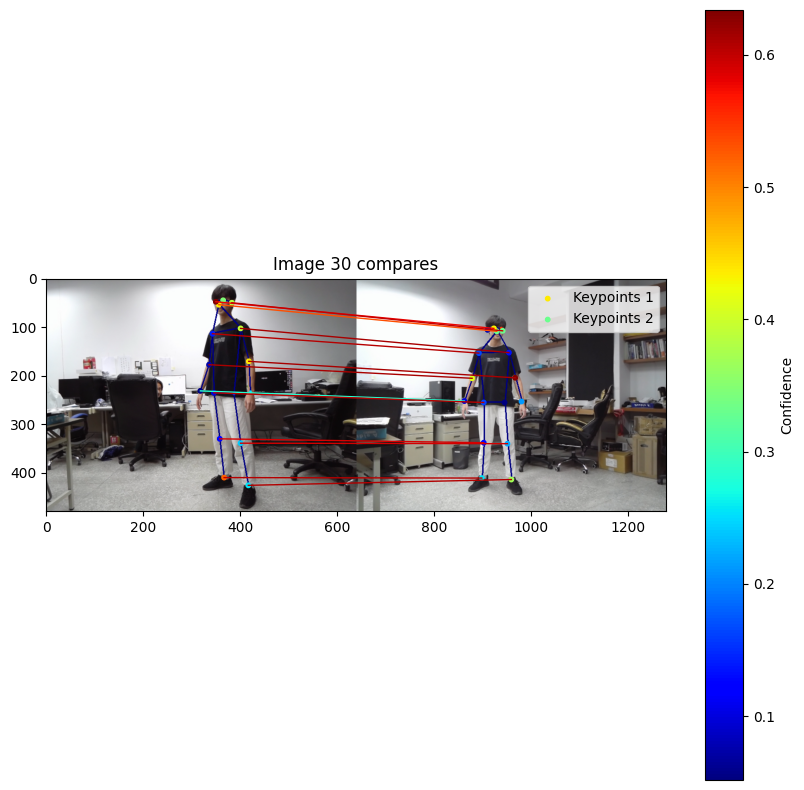

1499.017316017316
2142.435294117647
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205354_0011.png: (15, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205354_0011.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205354_0011.png: (256, 15)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205354_0011.png: (256, 15)


14 of keypoints are match


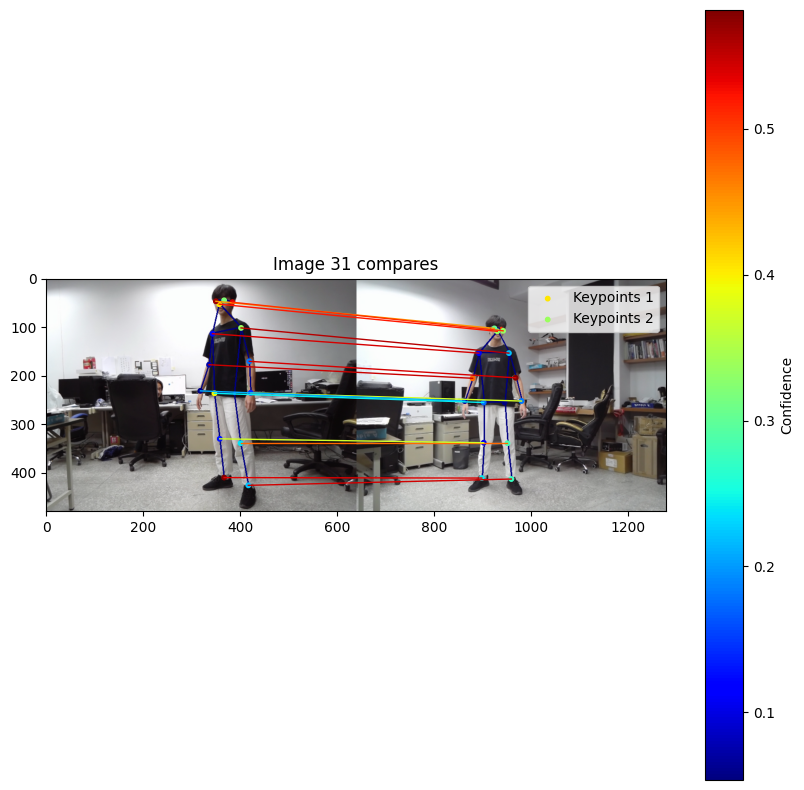

1316.438444924406
2318.533073929961
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205354_0012.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205354_0012.png: (14, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205354_0012.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205354_0012.png: (256, 14)


13 of keypoints are match


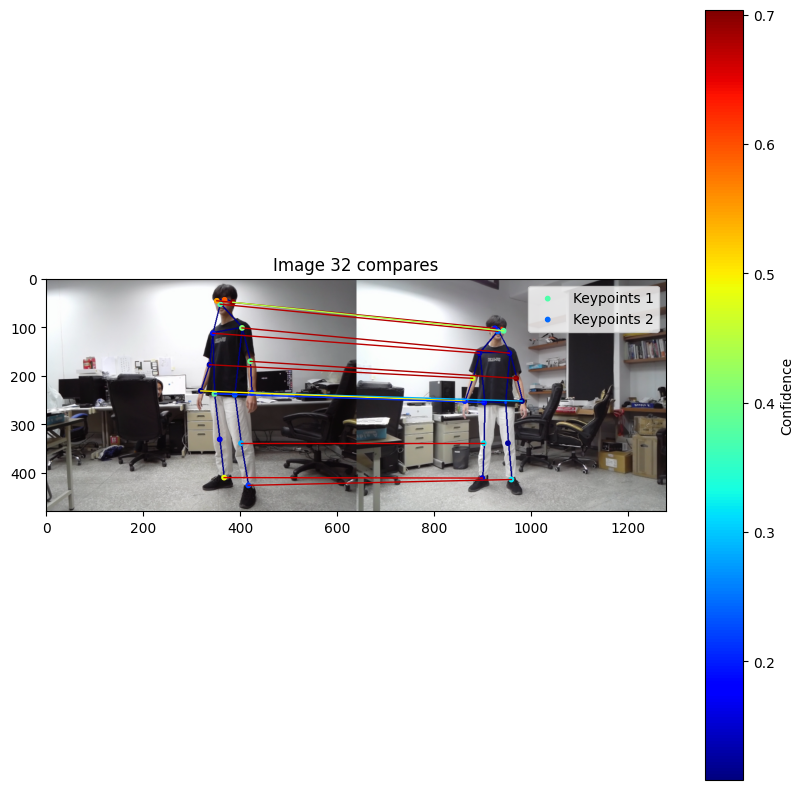

1727.2038626609442
2154.393063583815
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205354_0013.png: (14, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205354_0013.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205354_0013.png: (256, 14)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205354_0013.png: (256, 15)


13 of keypoints are match


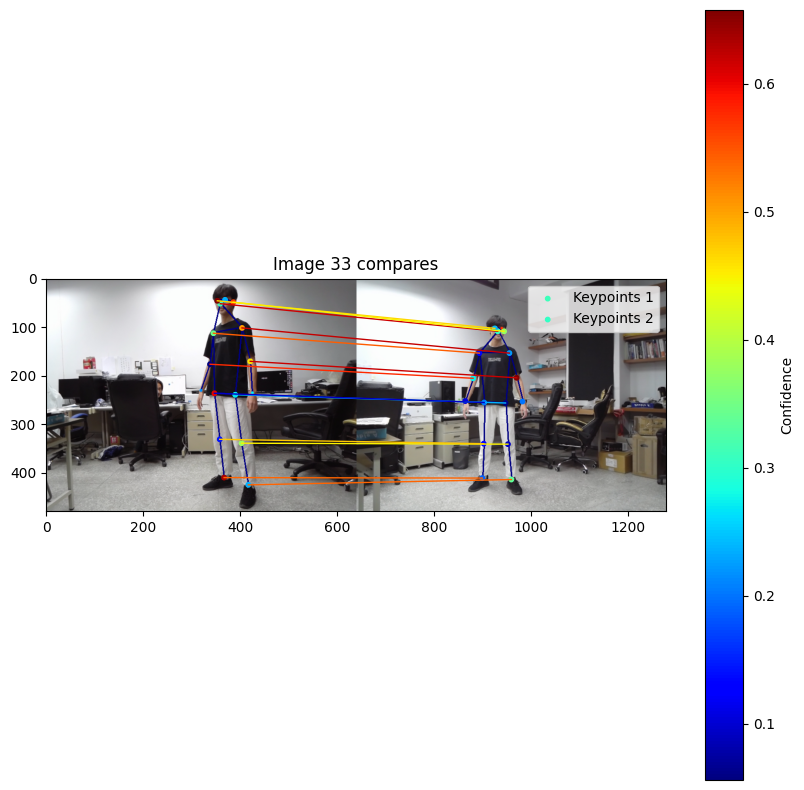

1273.3291139240507
2110.941520467836
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205354_0014.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205354_0014.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205354_0014.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205354_0014.png: (256, 15)


15 of keypoints are match


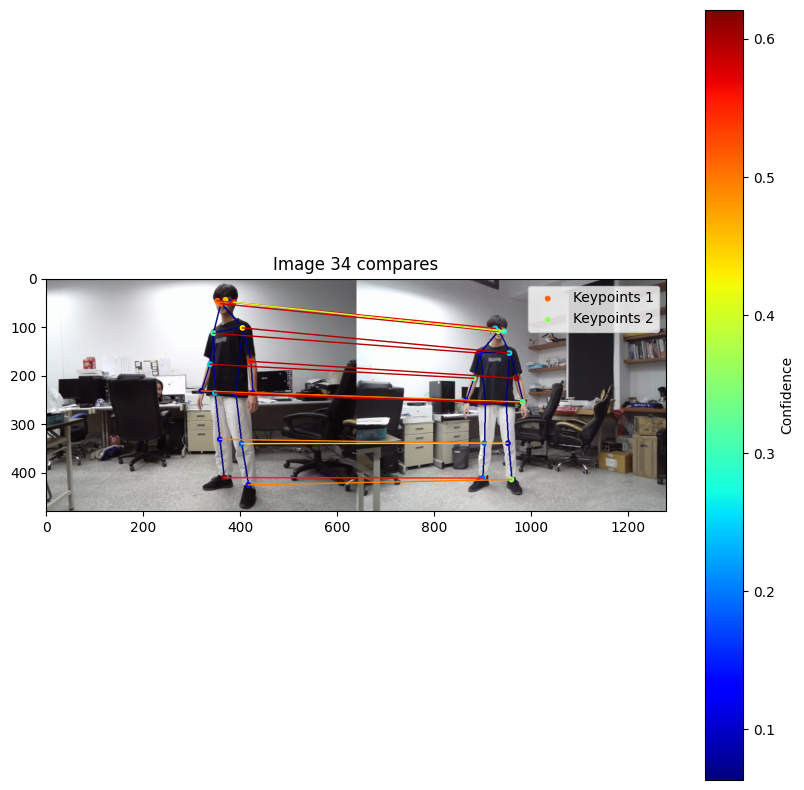

1299.8418803418804
2116.558415841584
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205354_0015.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205354_0015.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205354_0015.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205354_0015.png: (256, 15)


13 of keypoints are match


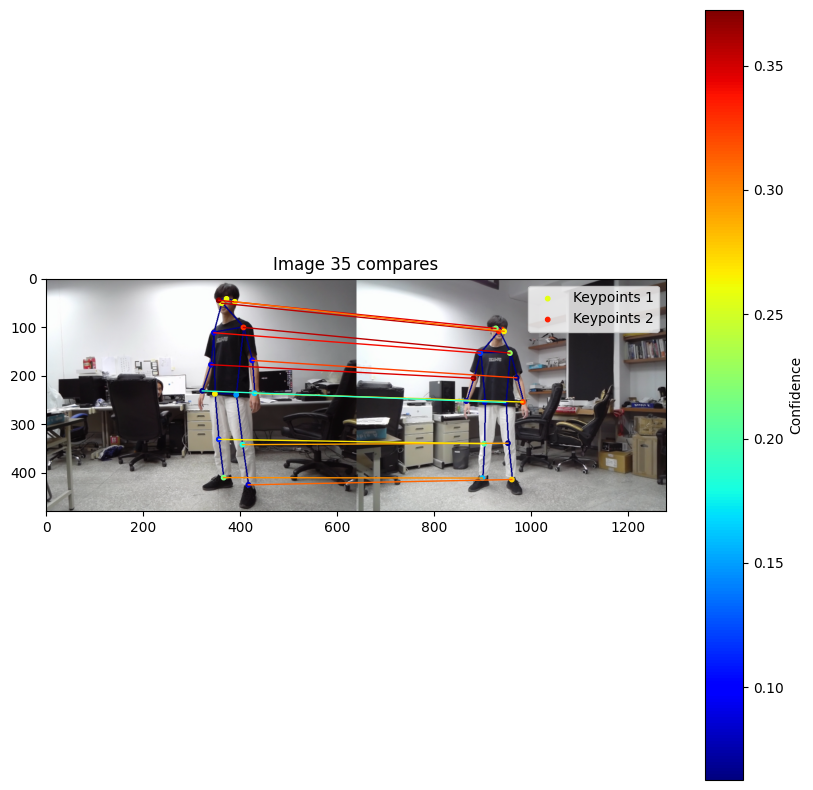

1294.3425531914893
2153.1881188118814
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205354_0016.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205354_0016.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205354_0016.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205354_0016.png: (256, 15)


12 of keypoints are match


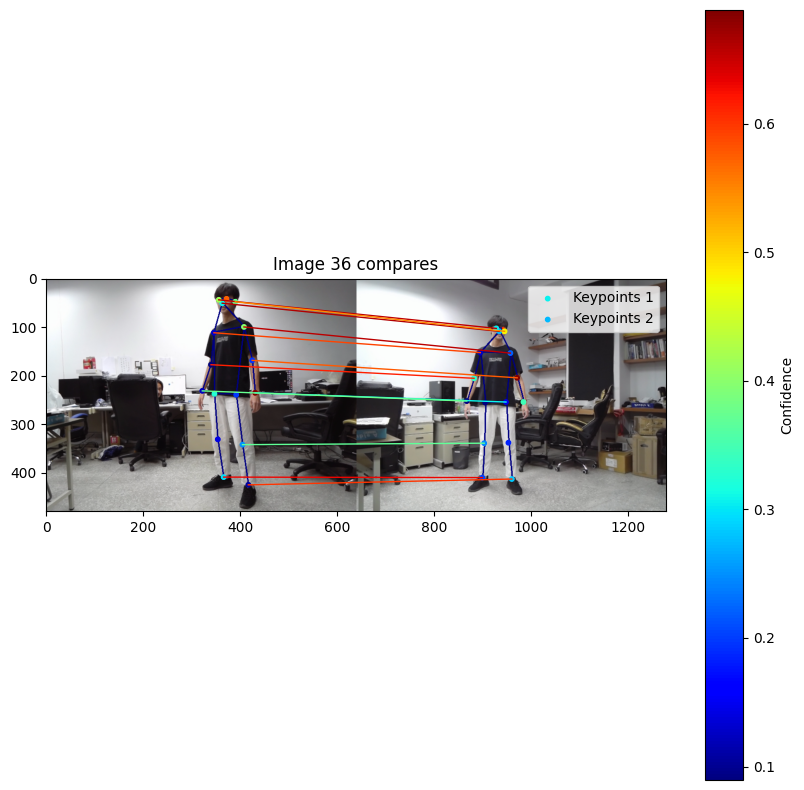

1320.8848614072494
1778.5976331360946
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205354_0017.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205354_0017.png: (16, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205354_0017.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205354_0017.png: (256, 16)


14 of keypoints are match


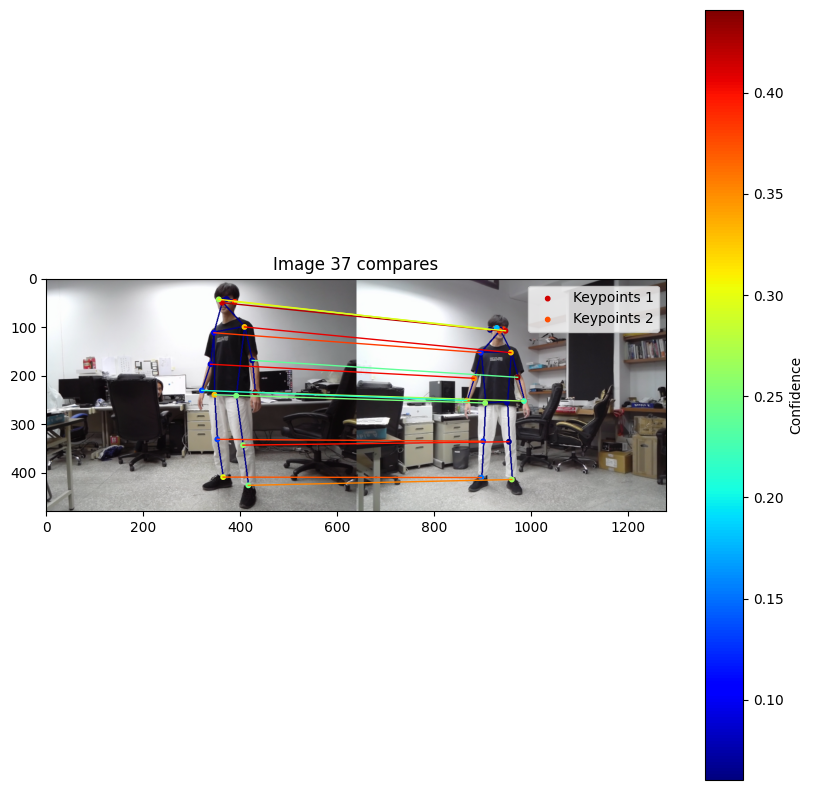

1326.2025862068965
2134.7514563106797
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205354_0018.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205354_0018.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205354_0018.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205354_0018.png: (256, 15)


14 of keypoints are match


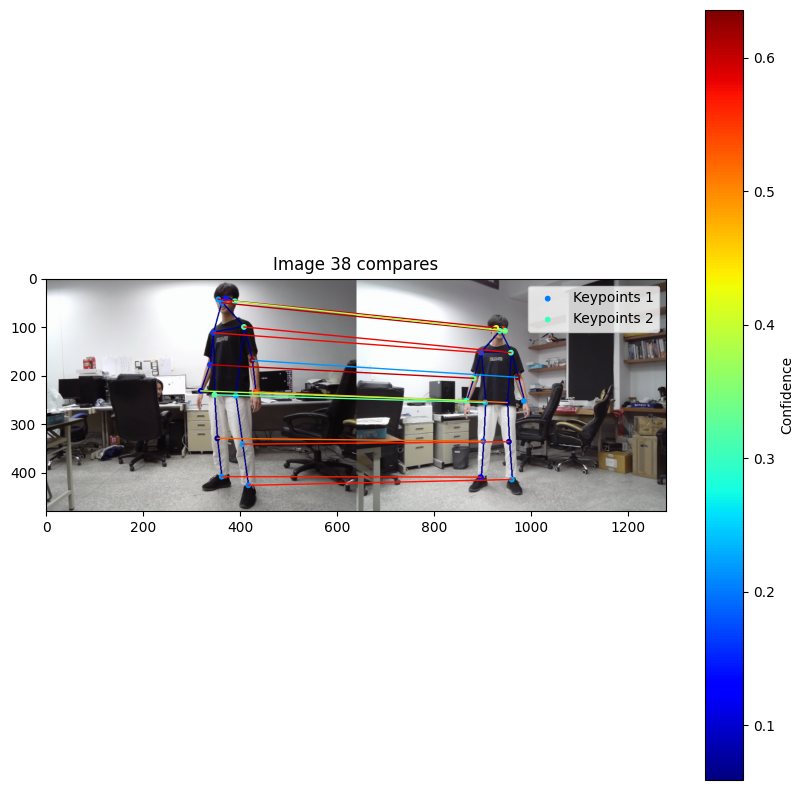

1727.4329004329004
2053.1673151750974
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205354_0019.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205354_0019.png: (14, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205354_0019.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205354_0019.png: (256, 14)


13 of keypoints are match


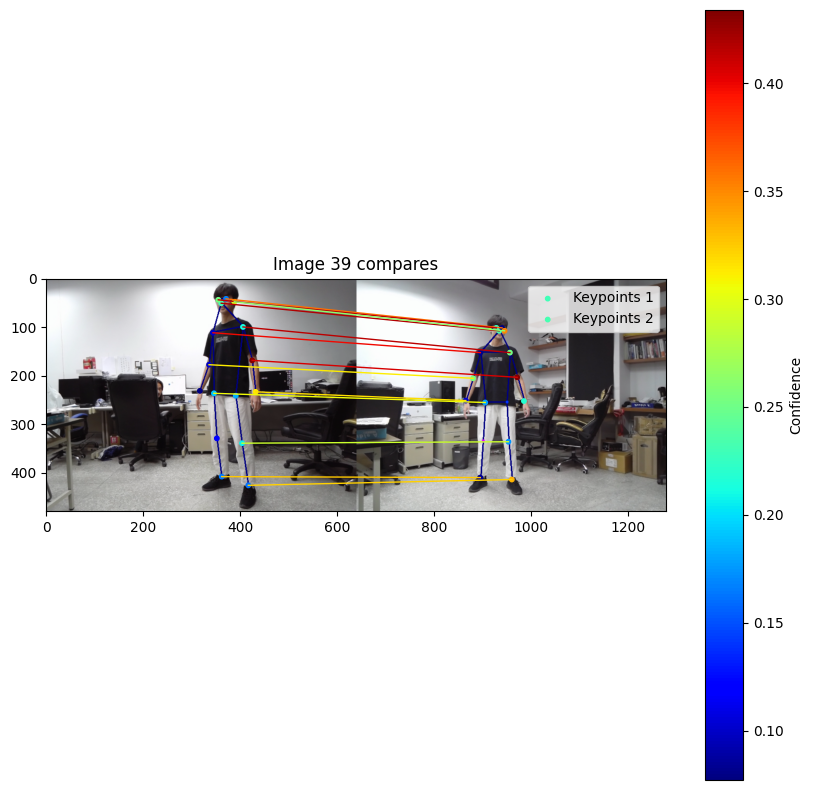

1727.4329004329004
1953.06432748538
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205354_0020.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205354_0020.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205354_0020.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205354_0020.png: (256, 15)


13 of keypoints are match


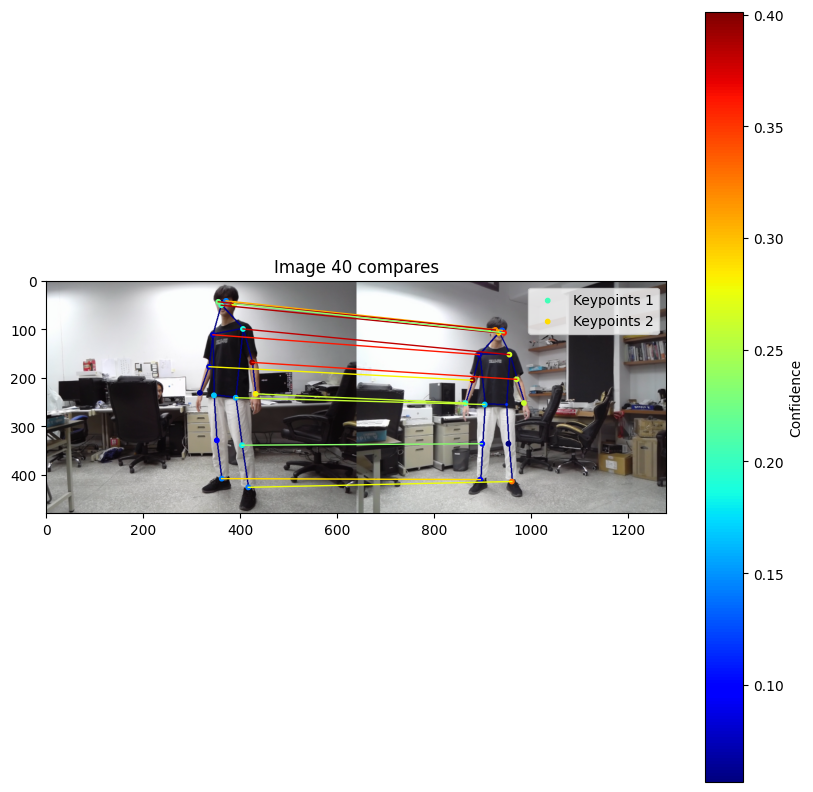

1296.4594017094016
1959.0939334637965
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205354_0021.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205354_0021.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205354_0021.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205354_0021.png: (256, 15)


14 of keypoints are match


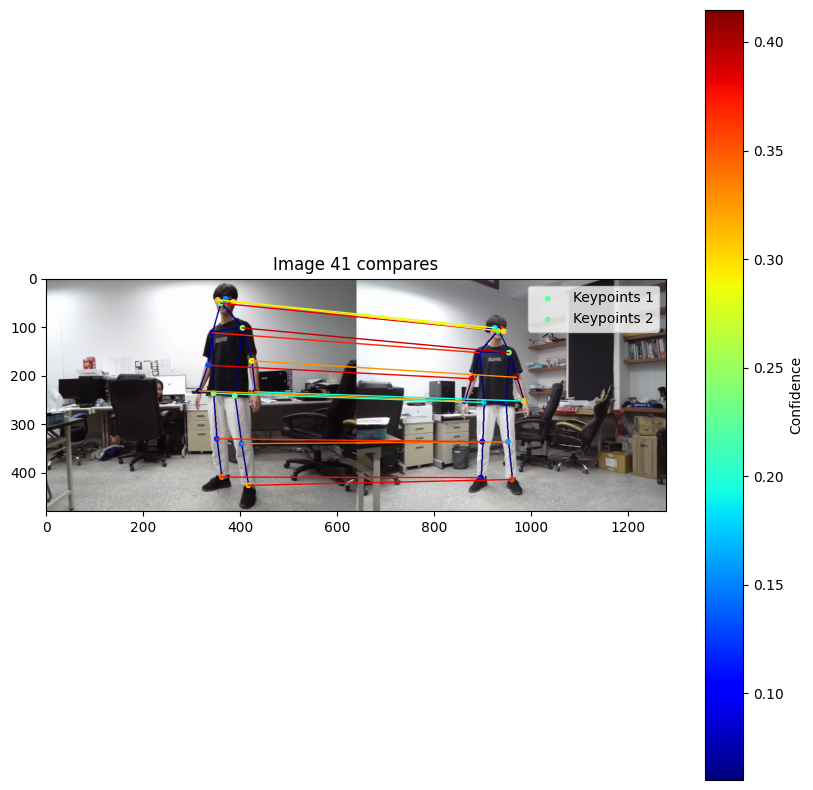

1499.524625267666
1780.4593023255813
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205354_0022.png: (15, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205354_0022.png: (16, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205354_0022.png: (256, 15)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205354_0022.png: (256, 16)


13 of keypoints are match


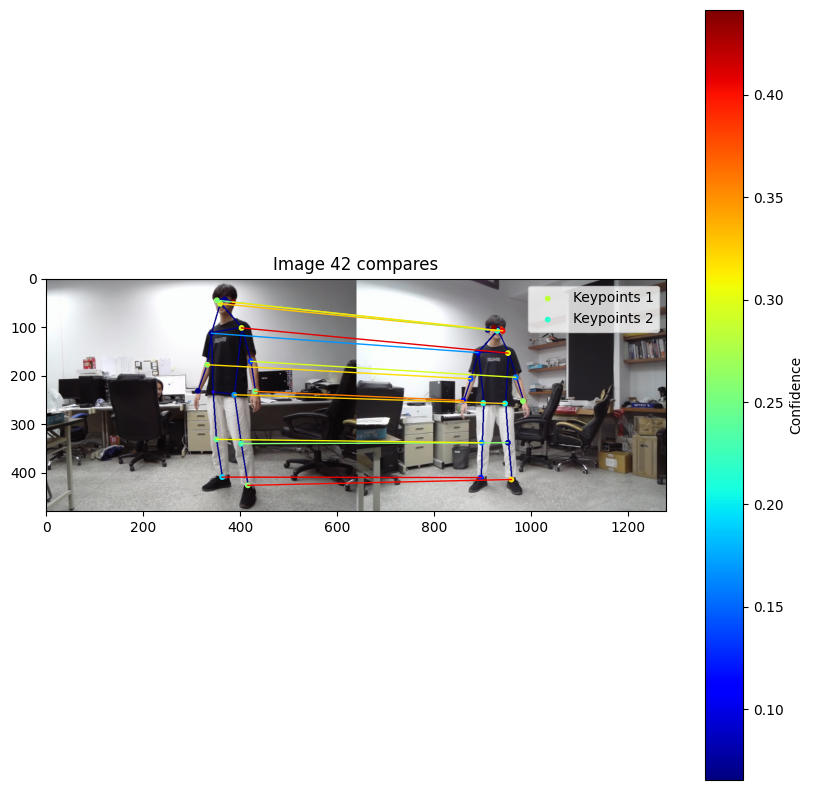

1266.5978947368421
1945.4564796905222
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205355_0023.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205355_0023.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205355_0023.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205355_0023.png: (256, 15)


14 of keypoints are match


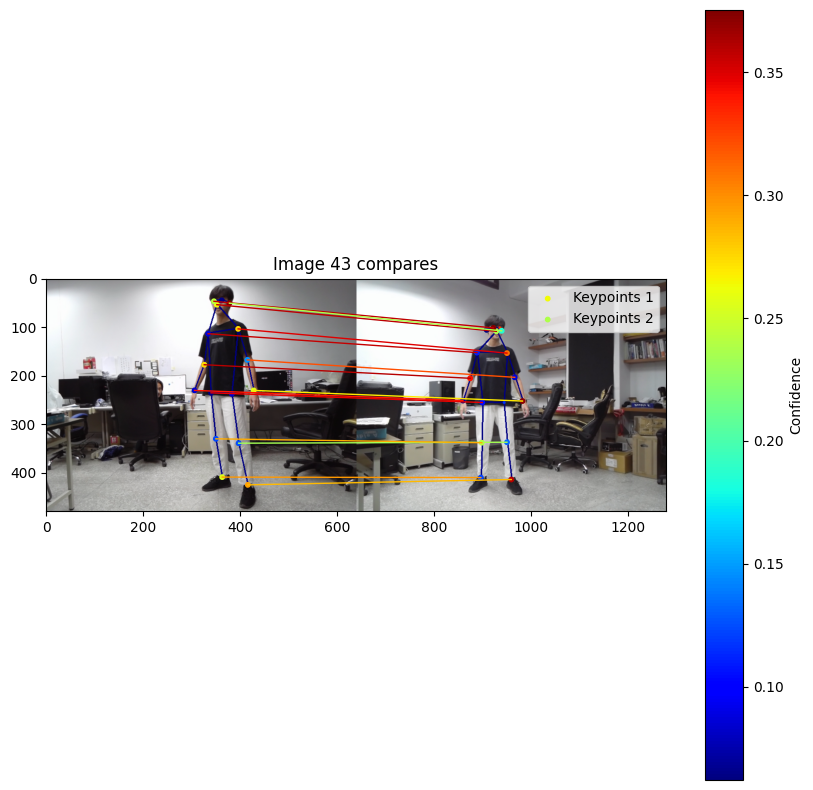

1660.6350210970463
2326.1377952755906
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205355_0024.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205355_0024.png: (14, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205355_0024.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205355_0024.png: (256, 14)


13 of keypoints are match


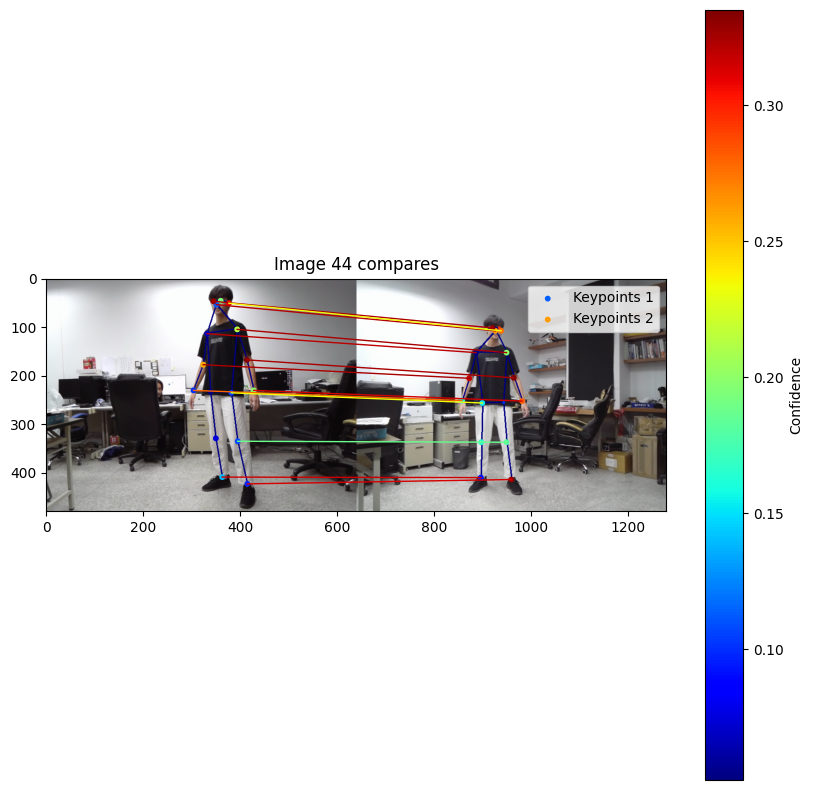

1221.8802521008404
1613.8774319066147
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205355_0025.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205355_0025.png: (16, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205355_0025.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205355_0025.png: (256, 16)


15 of keypoints are match


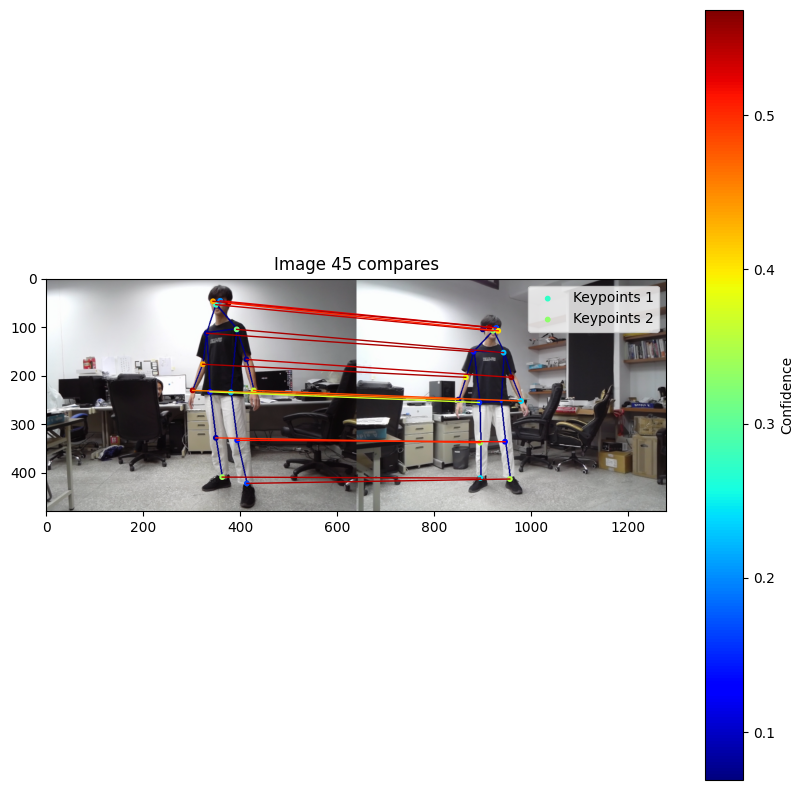

1643.5824634655532
1947.063909774436
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205355_0026.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205355_0026.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205355_0026.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205355_0026.png: (256, 15)


14 of keypoints are match


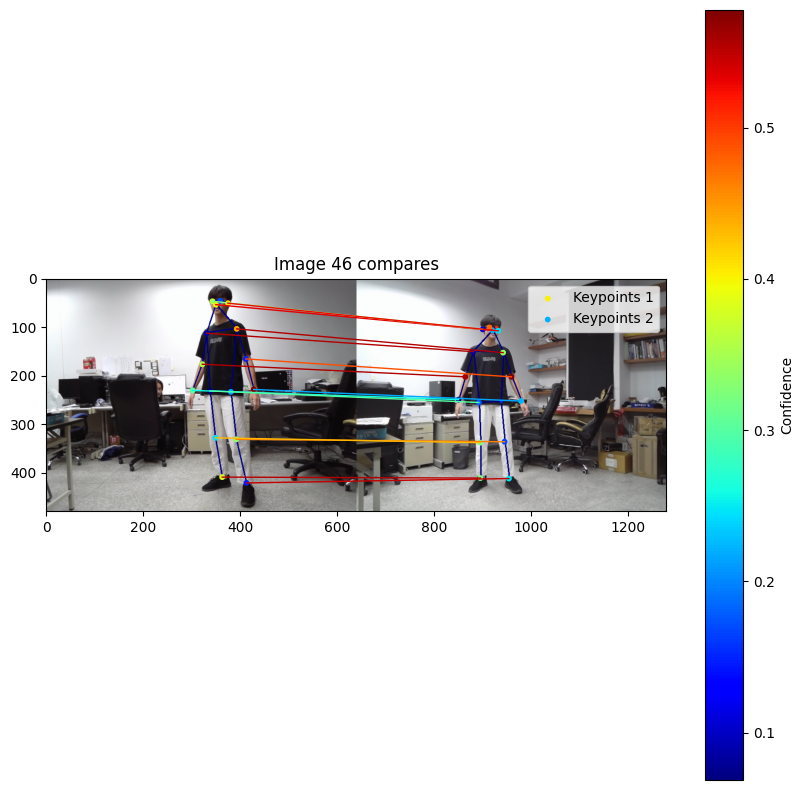

1628.1458333333333
1978.9790874524715
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205355_0027.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205355_0027.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205355_0027.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205355_0027.png: (256, 15)


13 of keypoints are match


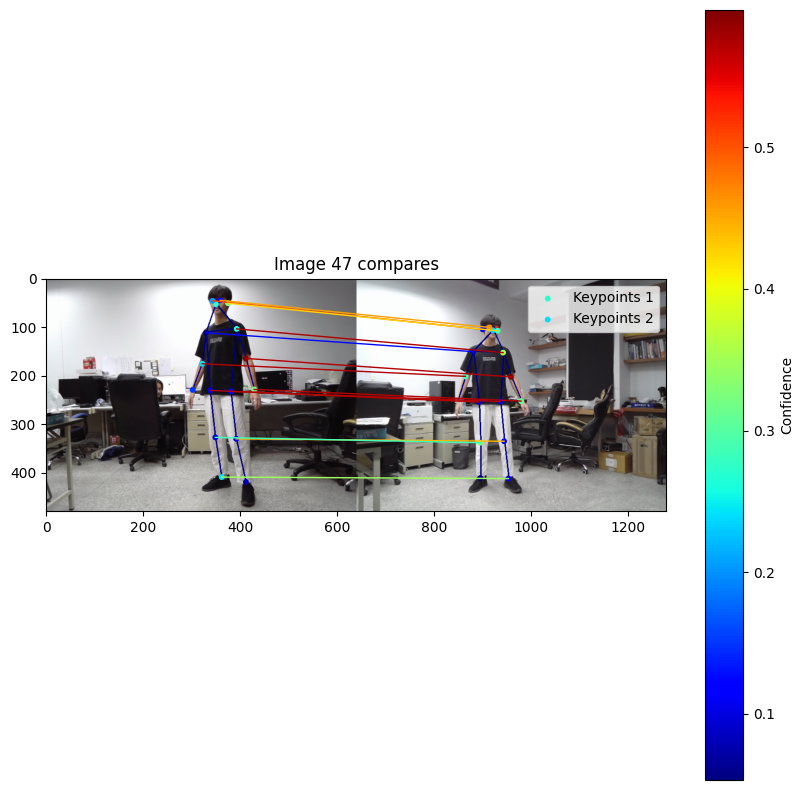

1651.3520833333334
2309.45197740113
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205355_0028.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205355_0028.png: (13, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205355_0028.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205355_0028.png: (256, 13)


12 of keypoints are match


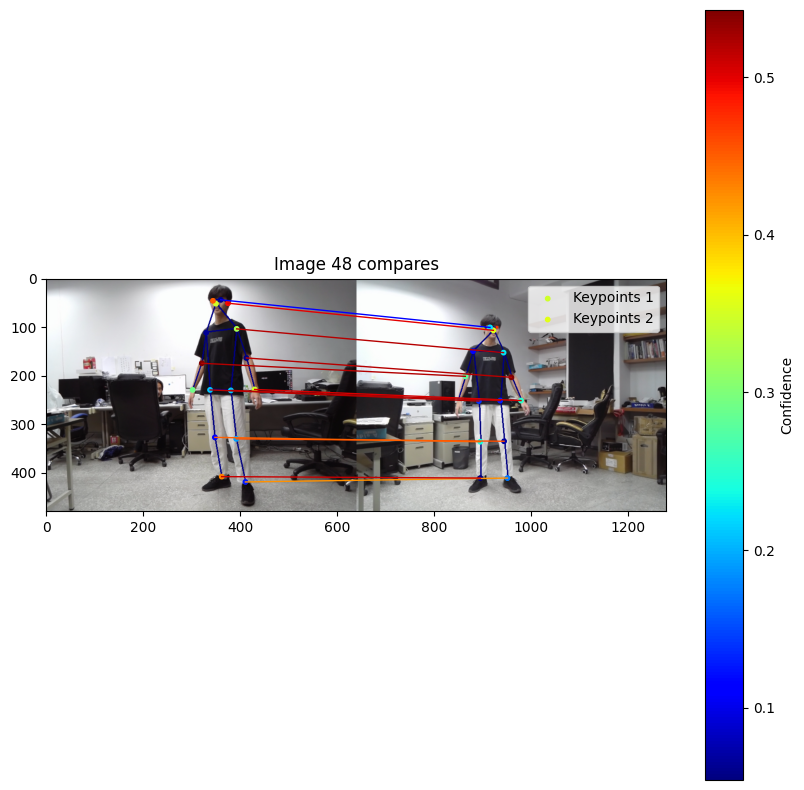

1631.7136842105263
2121.8464491362765
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205355_0029.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205355_0029.png: (14, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205355_0029.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205355_0029.png: (256, 14)


14 of keypoints are match


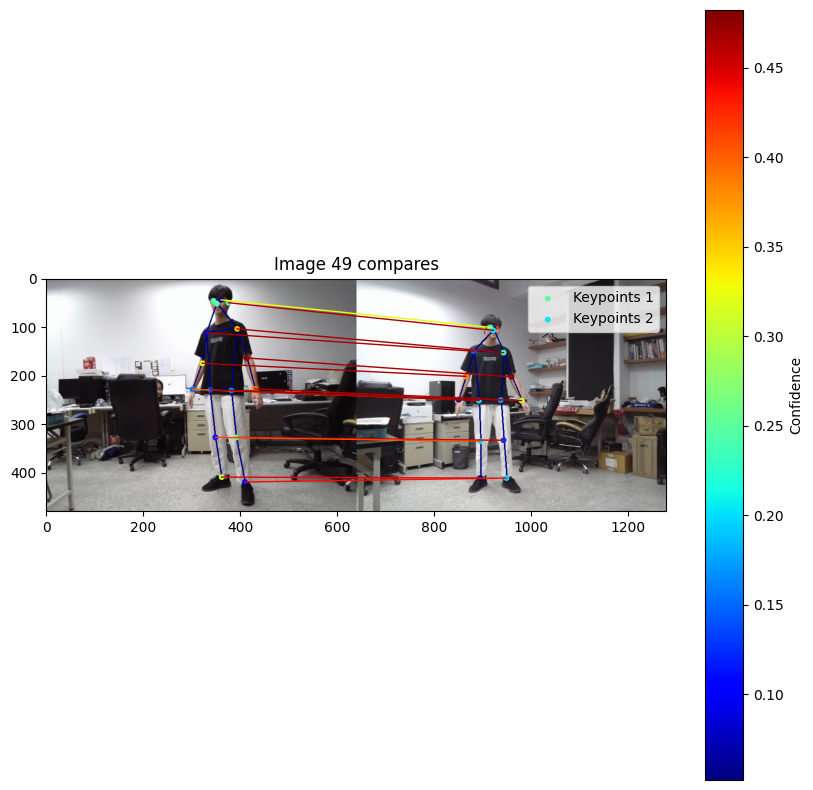

1582.034632034632
2225.0940499040307
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205355_0030.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205355_0030.png: (13, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205355_0030.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205355_0030.png: (256, 13)


13 of keypoints are match


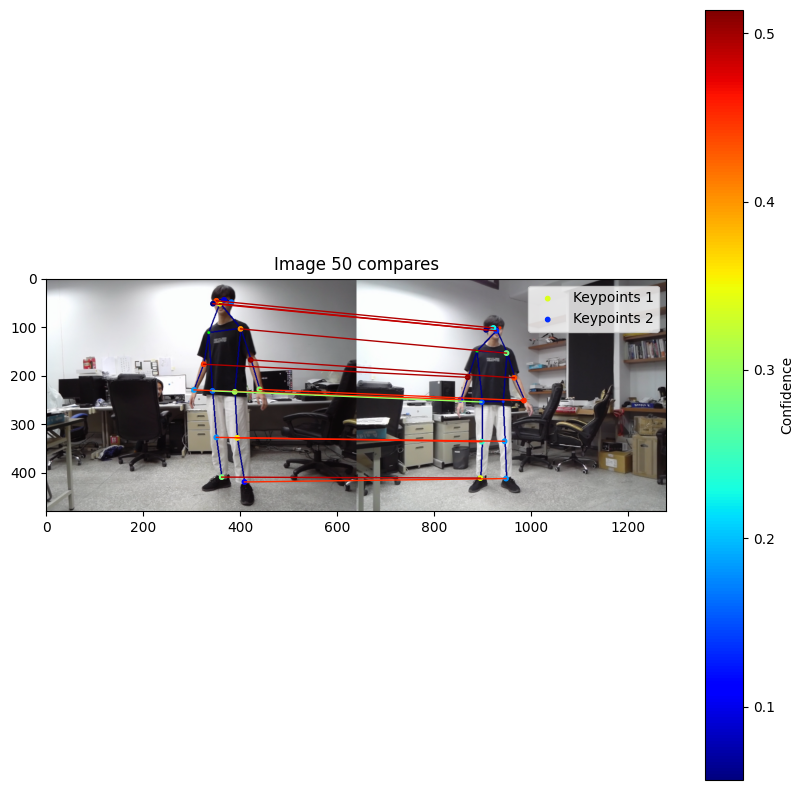

1658.8704103671707
1760.4914285714285
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205355_0031.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205355_0031.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205355_0031.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205355_0031.png: (256, 15)


15 of keypoints are match


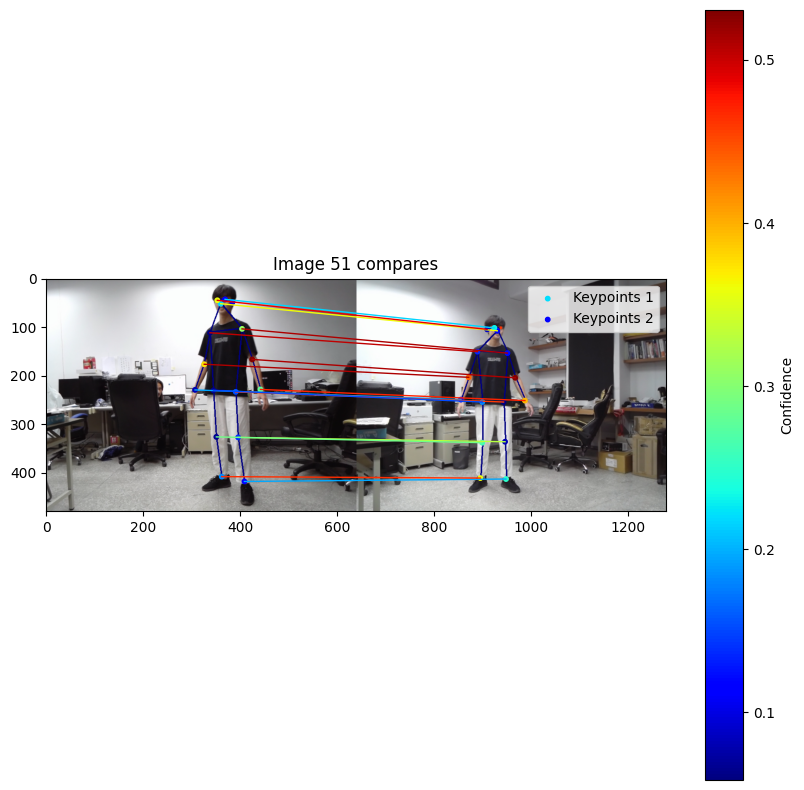

1681.0021645021645
1945.5408560311284
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205355_0032.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205355_0032.png: (14, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205355_0032.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205355_0032.png: (256, 14)


13 of keypoints are match


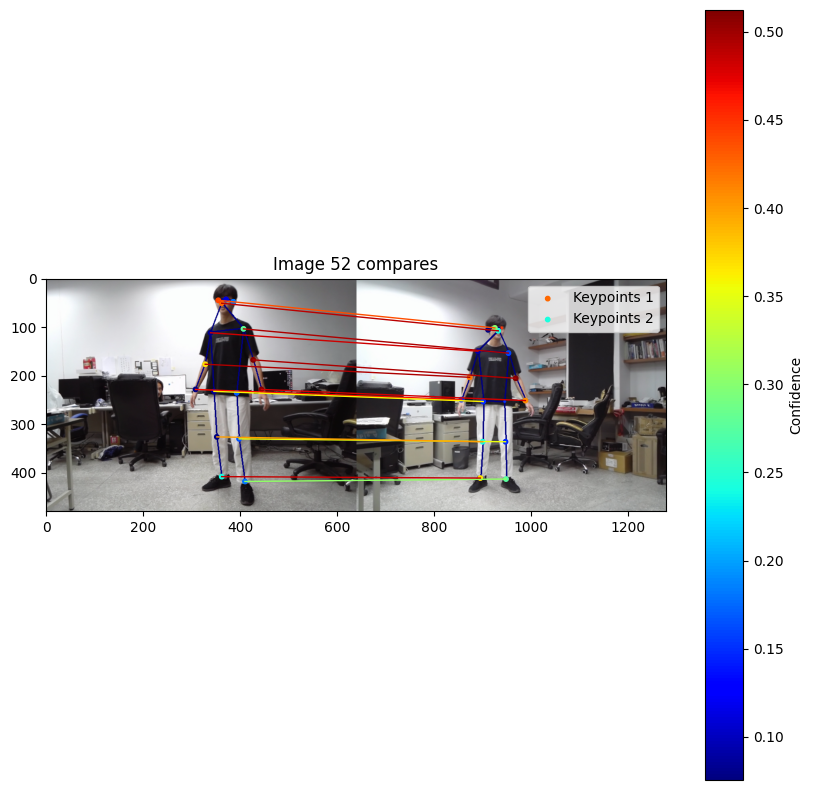

1872.0505263157895
2285.7076023391814
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205355_0033.png: (15, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205355_0033.png: (13, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205355_0033.png: (256, 15)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205355_0033.png: (256, 13)


12 of keypoints are match


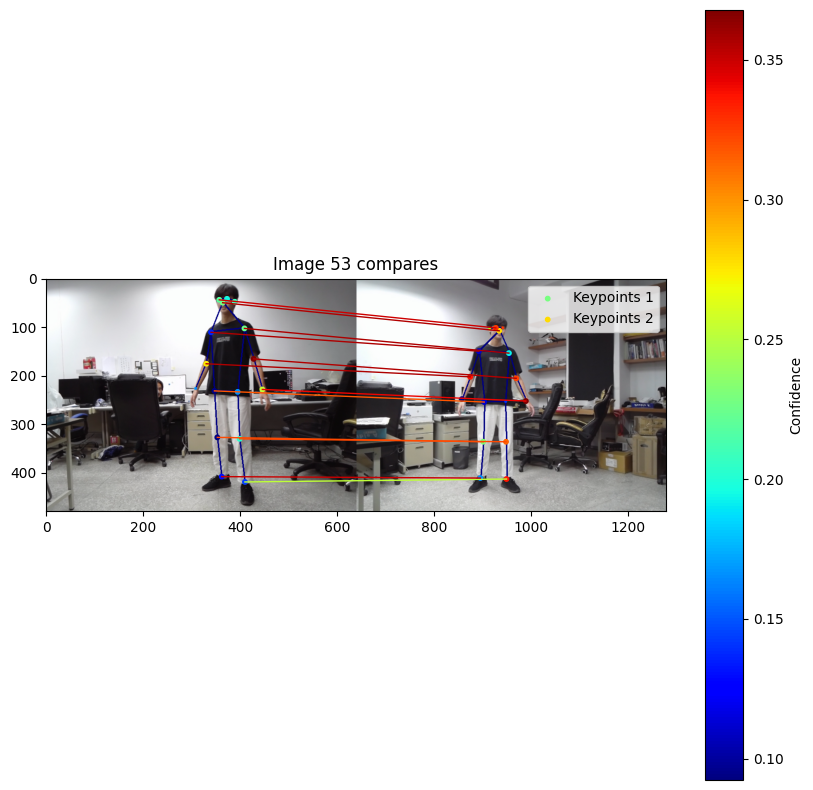

2046.1462365591399
2226.413926499033
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205355_0034.png: (15, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205355_0034.png: (13, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205355_0034.png: (256, 15)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205355_0034.png: (256, 13)


11 of keypoints are match


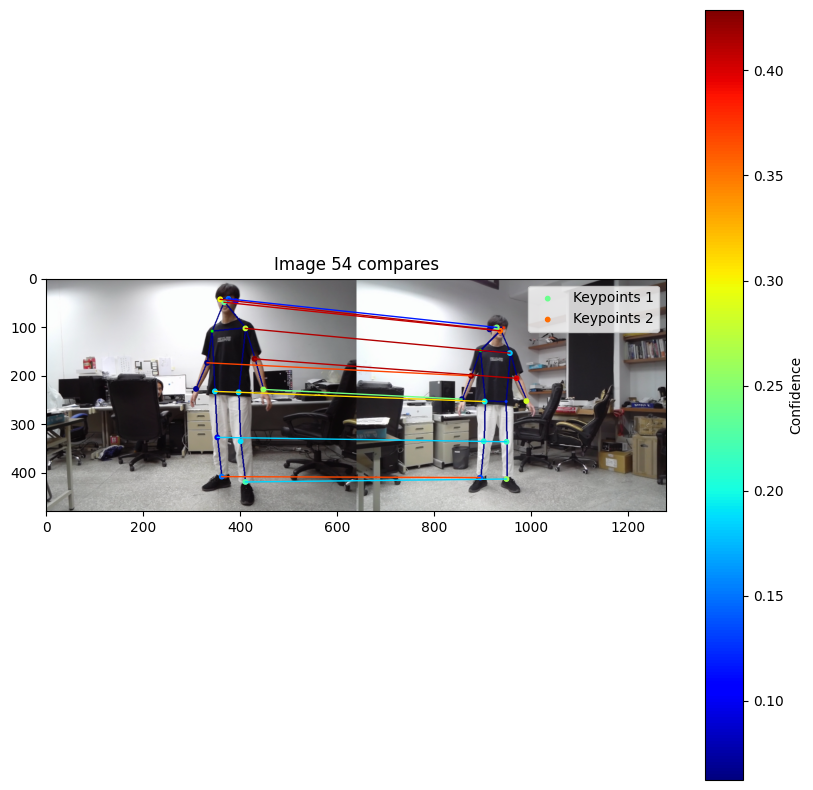

1290.1506550218342
1926.130518234165
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205355_0035.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205355_0035.png: (14, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205355_0035.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205355_0035.png: (256, 14)


13 of keypoints are match


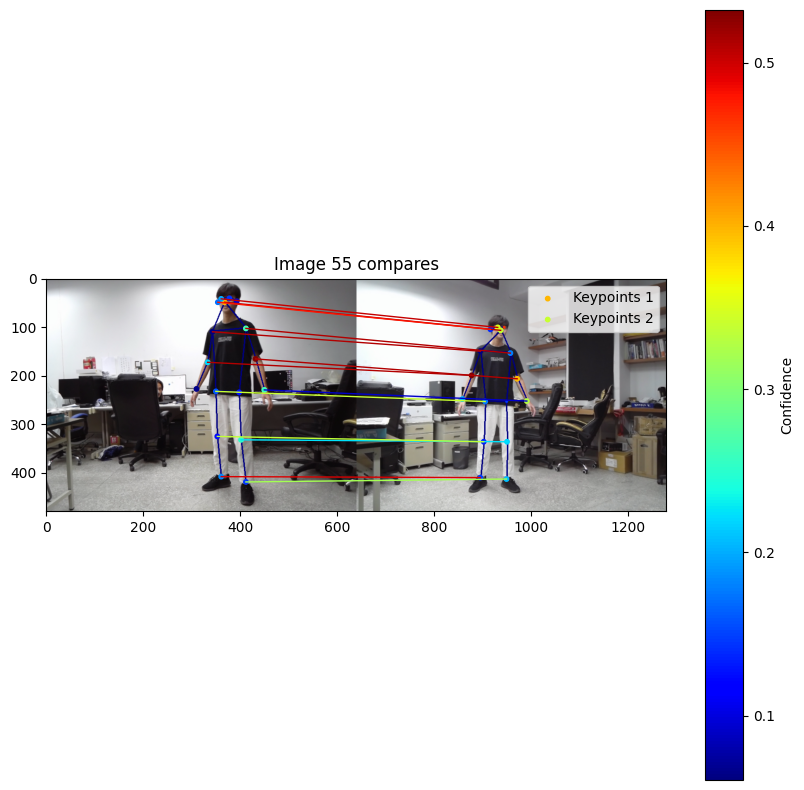

1223.7516059957175
2090.128846153846
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205355_0036.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205355_0036.png: (14, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205355_0036.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205355_0036.png: (256, 14)


13 of keypoints are match


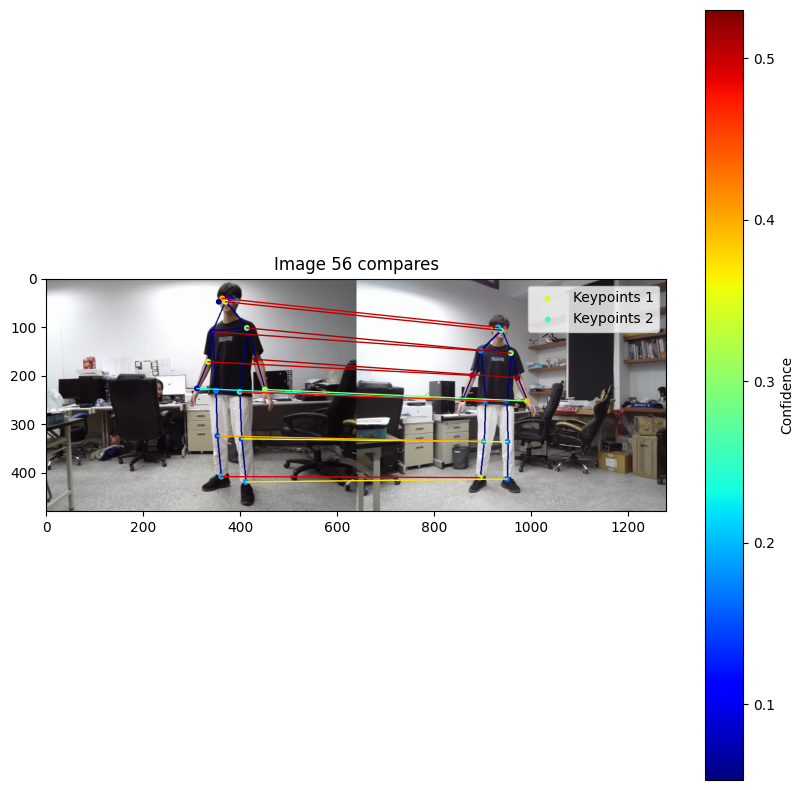

1634.1617021276595
1923.6134615384615
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205355_0037.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205355_0037.png: (14, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205355_0037.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205355_0037.png: (256, 14)


13 of keypoints are match


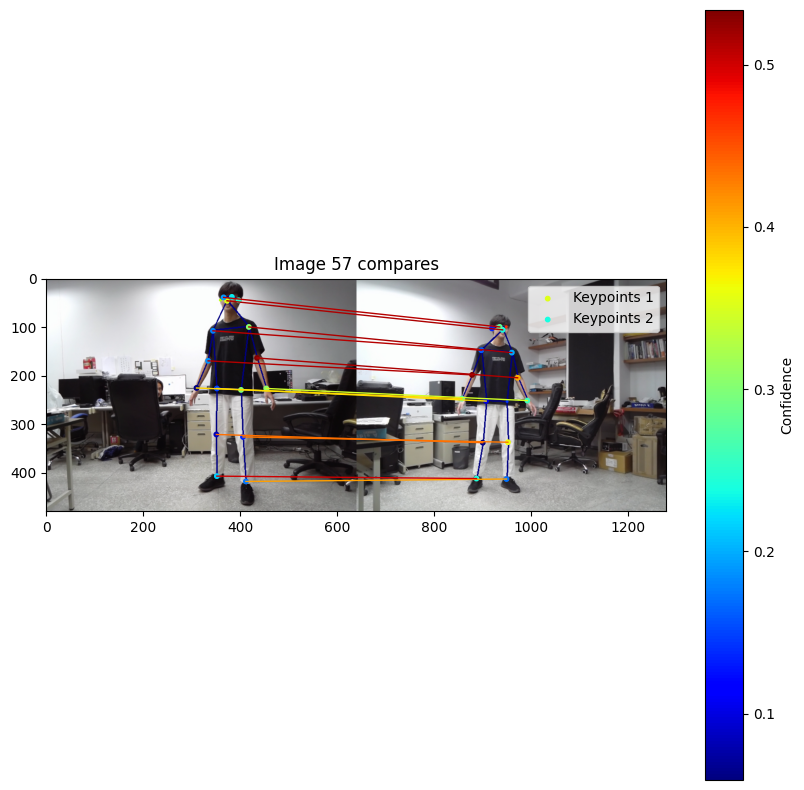

1196.8863157894737
1660.2722419928825
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205355_0038.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205355_0038.png: (14, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205355_0038.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205355_0038.png: (256, 14)


12 of keypoints are match


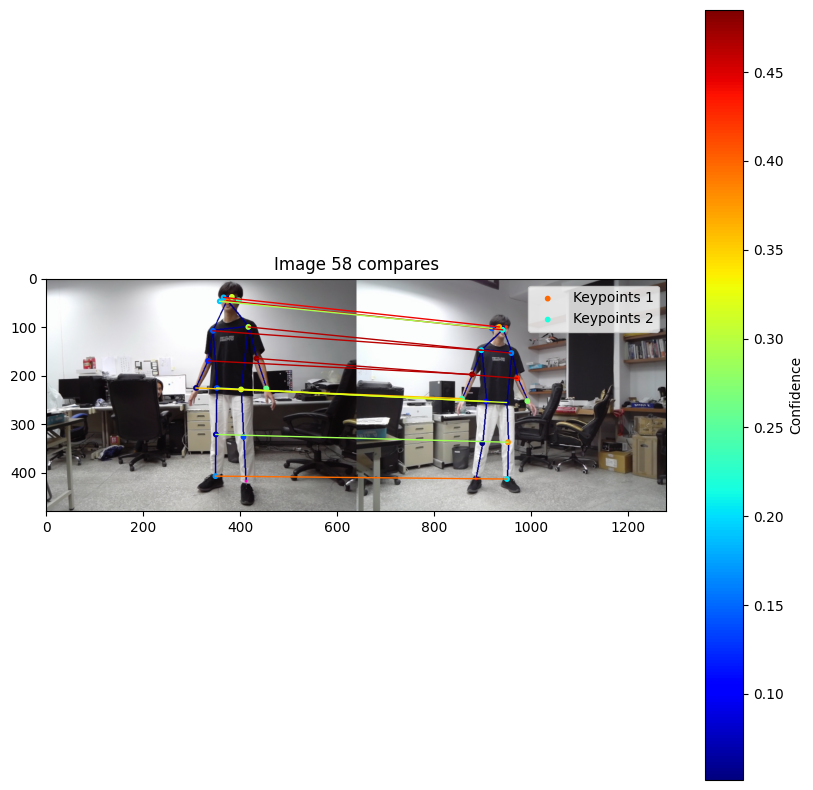

1442.5274261603377
1500.3333333333333
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205355_0039.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205355_0039.png: (14, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205355_0039.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205355_0039.png: (256, 14)


13 of keypoints are match


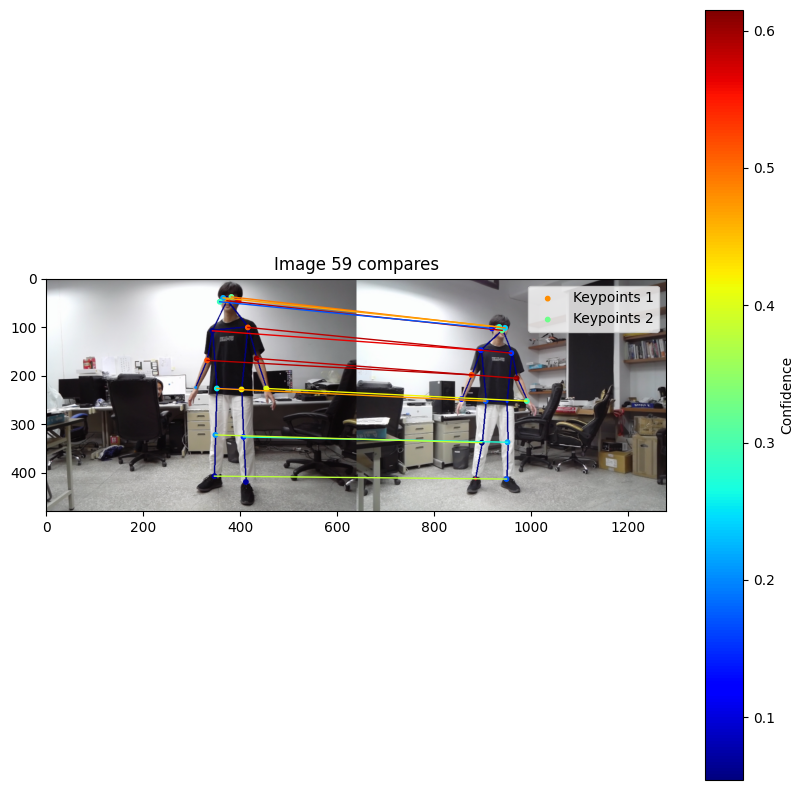

1449.1670190274842
1826.222024866785
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205355_0040.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205355_0040.png: (13, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205355_0040.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205355_0040.png: (256, 13)


12 of keypoints are match


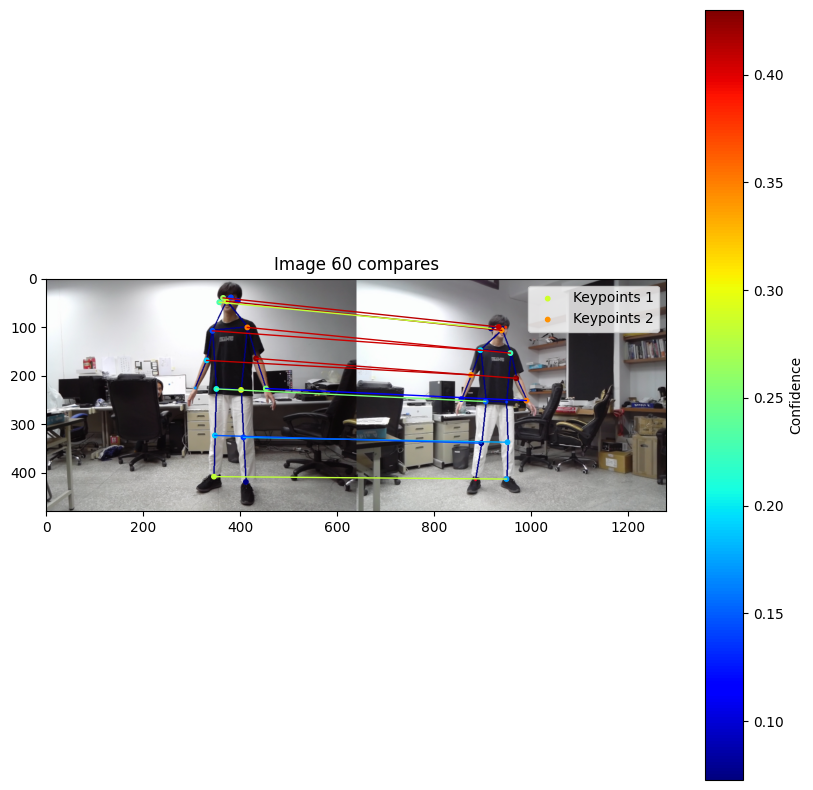

1590.6315789473683
1941.9505703422053
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205355_0041.png: (15, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205355_0041.png: (14, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205355_0041.png: (256, 15)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205355_0041.png: (256, 14)


12 of keypoints are match


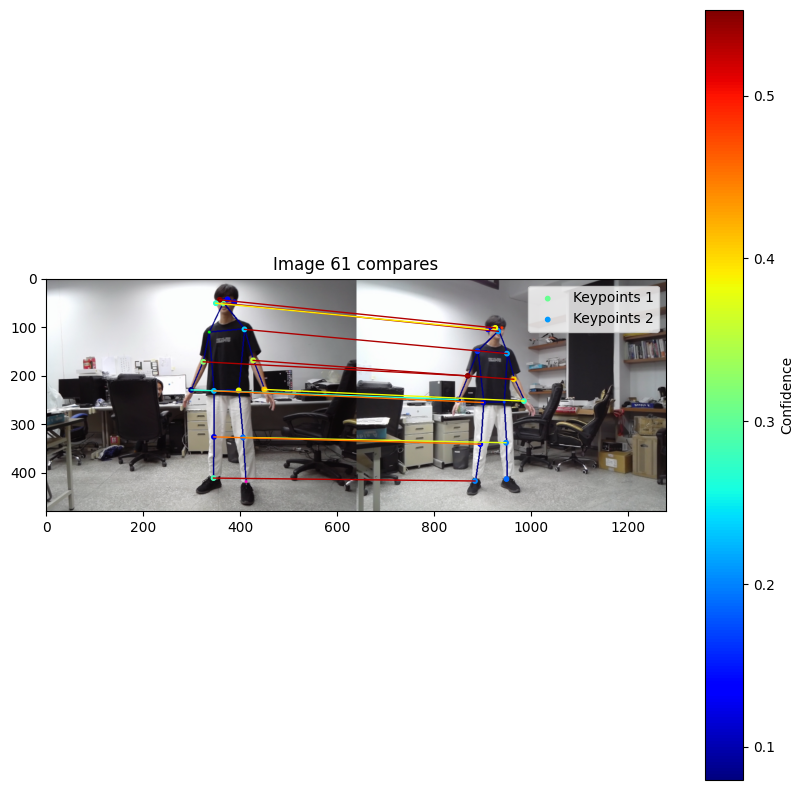

1255.9619450317125
2095.2155339805827
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205355_0042.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205355_0042.png: (14, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205355_0042.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205355_0042.png: (256, 14)


13 of keypoints are match


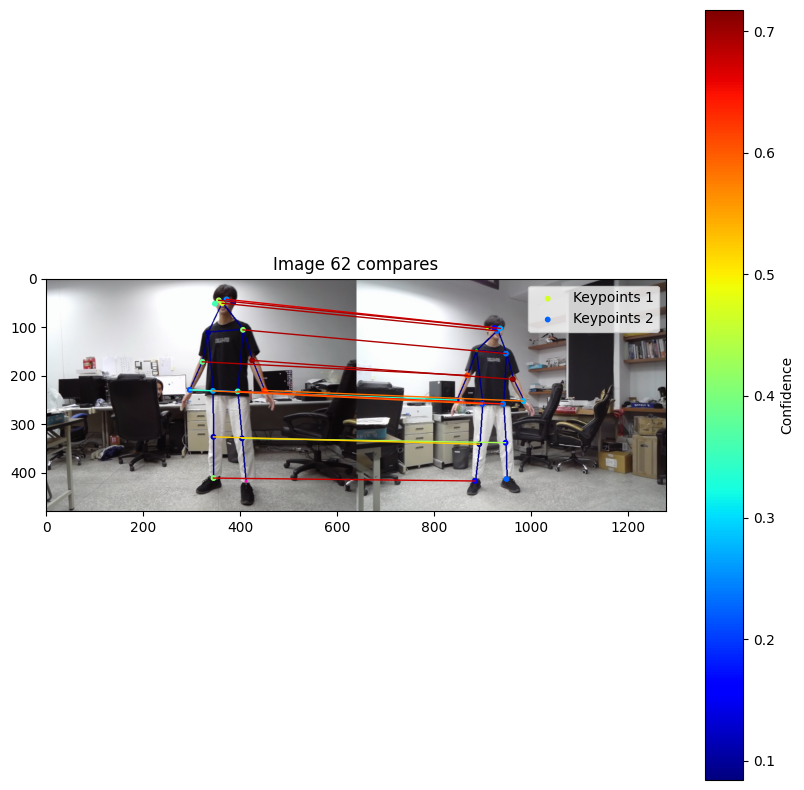

1578.367432150313
1464.6449136276392
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205356_0043.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205356_0043.png: (16, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205356_0043.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205356_0043.png: (256, 16)


14 of keypoints are match


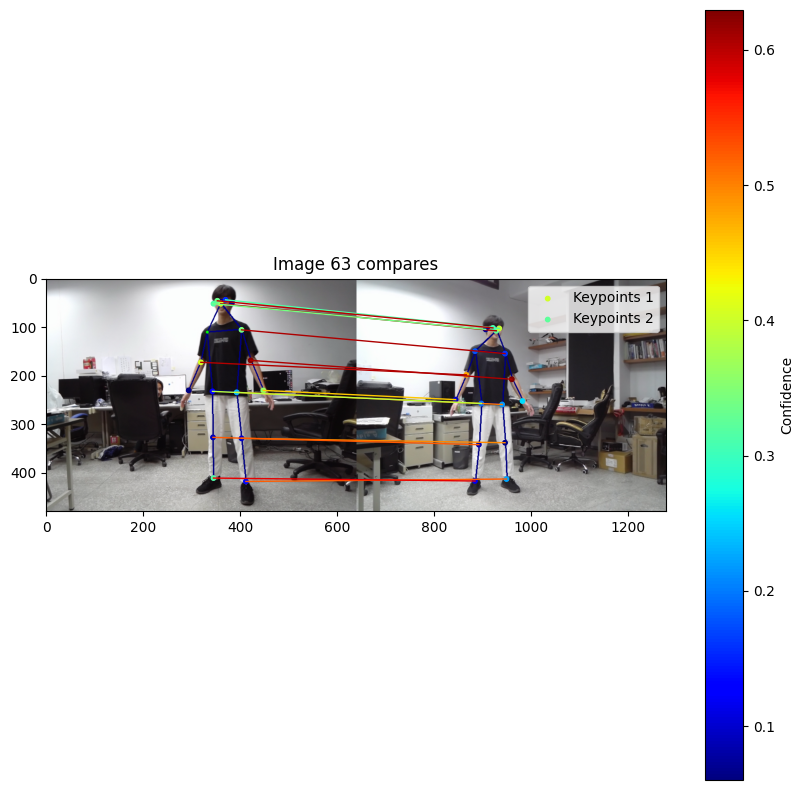

1211.6772151898733
1469.8878326996198
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205356_0044.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205356_0044.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205356_0044.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205356_0044.png: (256, 15)


14 of keypoints are match


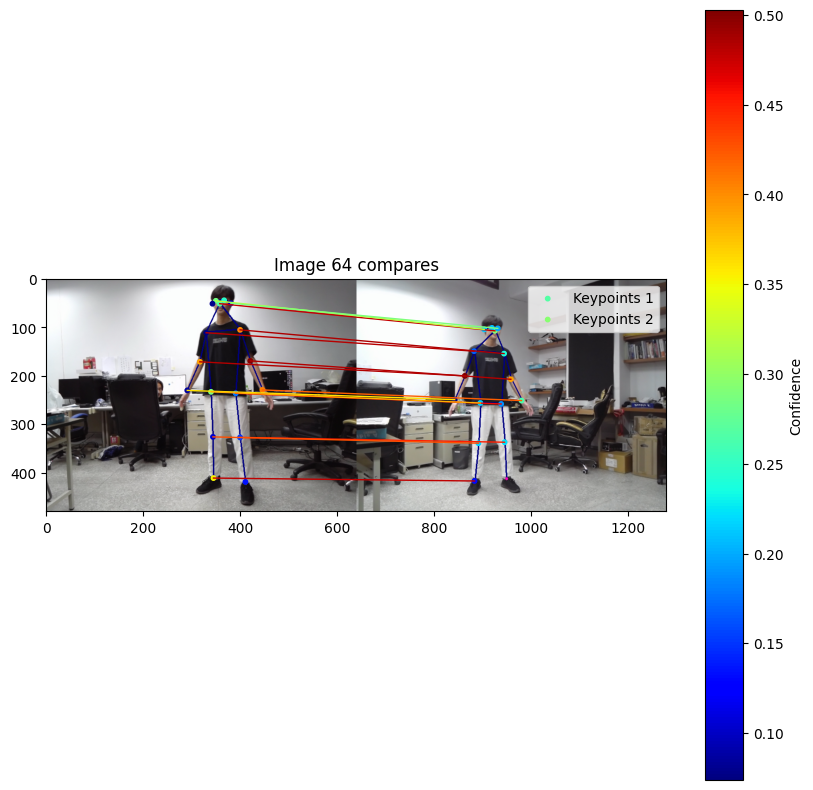

1744.575
1383.5225225225224
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205356_0045.png: (15, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205356_0045.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205356_0045.png: (256, 15)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205356_0045.png: (256, 15)


13 of keypoints are match


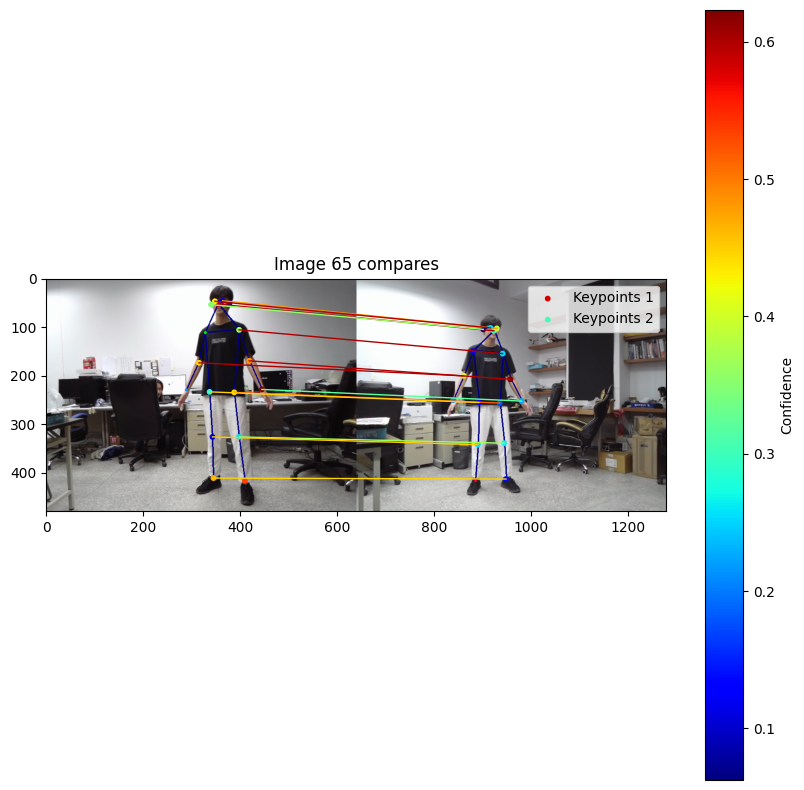

1503.2210743801652
1383.483245149912
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205356_0046.png: (15, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205356_0046.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205356_0046.png: (256, 15)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205356_0046.png: (256, 15)


13 of keypoints are match


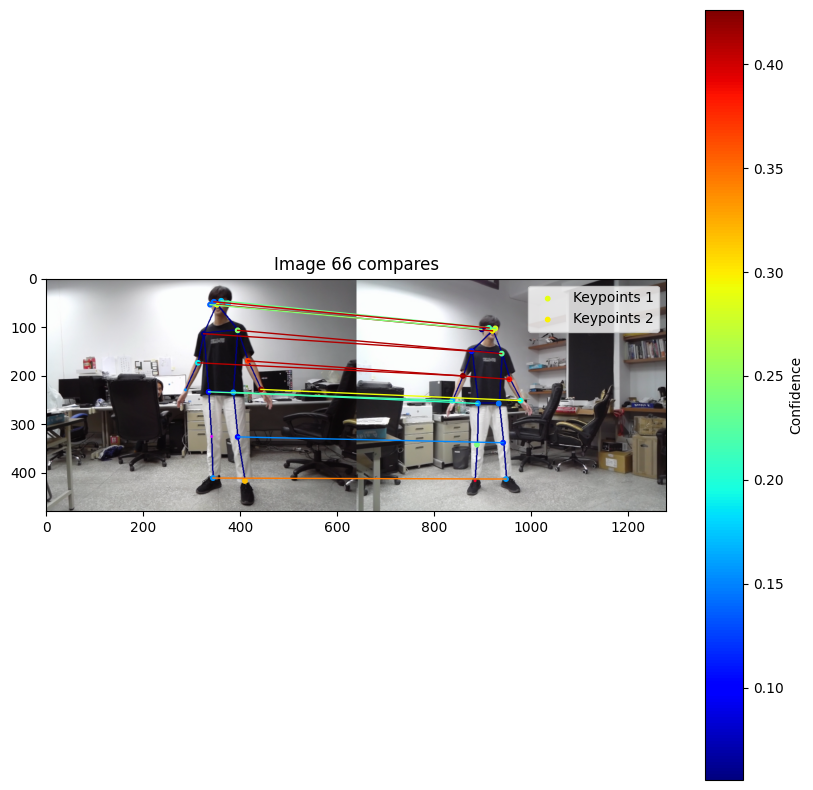

1517.2412371134021
2346.8229571984434
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205356_0047.png: (15, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205356_0047.png: (13, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205356_0047.png: (256, 15)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205356_0047.png: (256, 13)


11 of keypoints are match


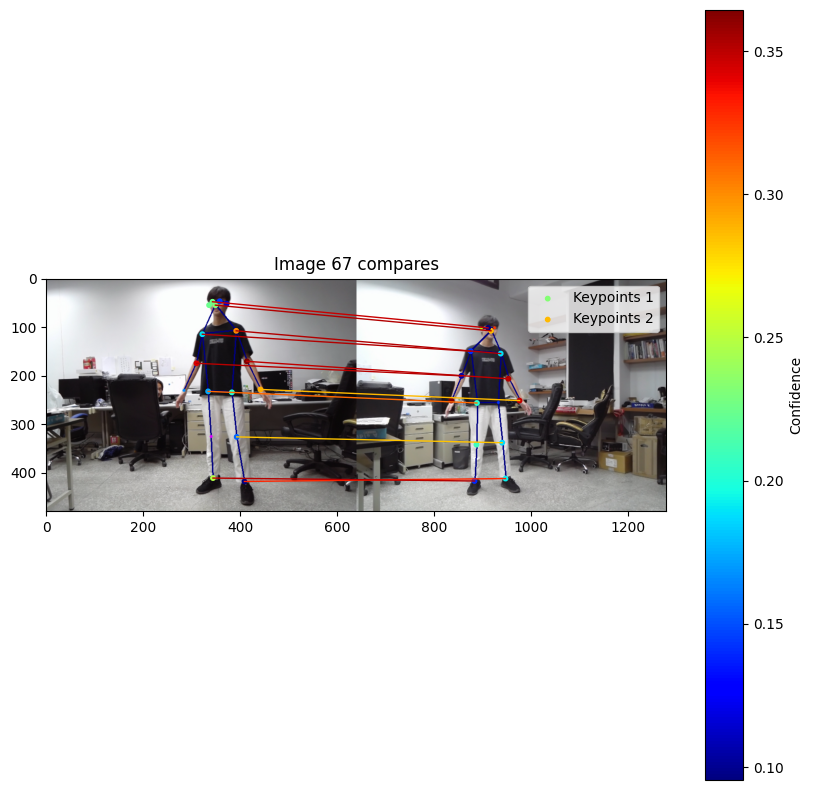

1822.6680584551148
1874.8527724665391
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205356_0048.png: (15, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205356_0048.png: (14, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205356_0048.png: (256, 15)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205356_0048.png: (256, 14)


12 of keypoints are match


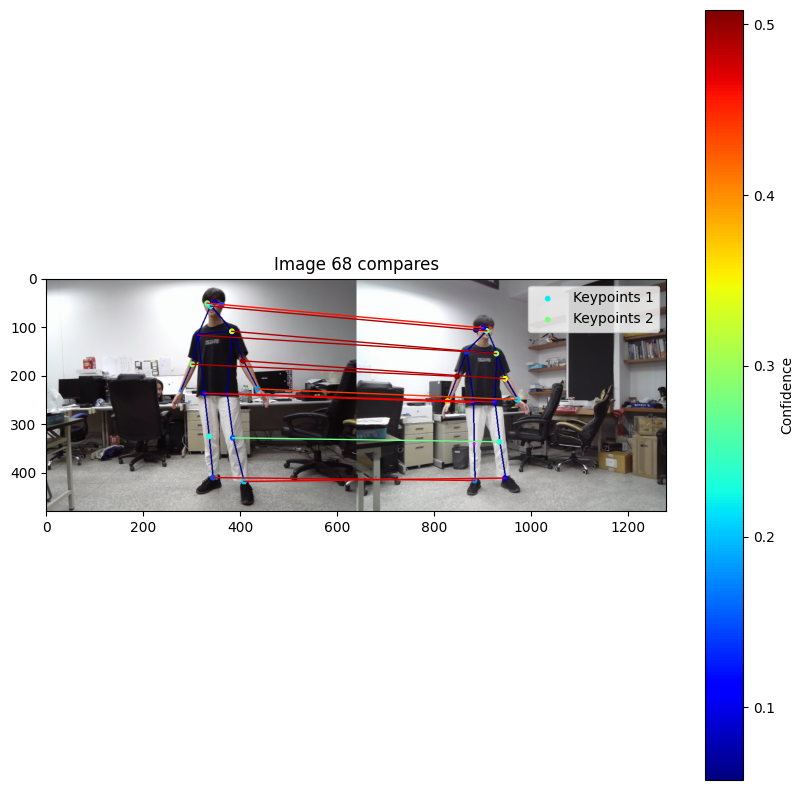

1832.245283018868
2173.2369942196533
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205356_0049.png: (15, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205356_0049.png: (14, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205356_0049.png: (256, 15)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205356_0049.png: (256, 14)


13 of keypoints are match


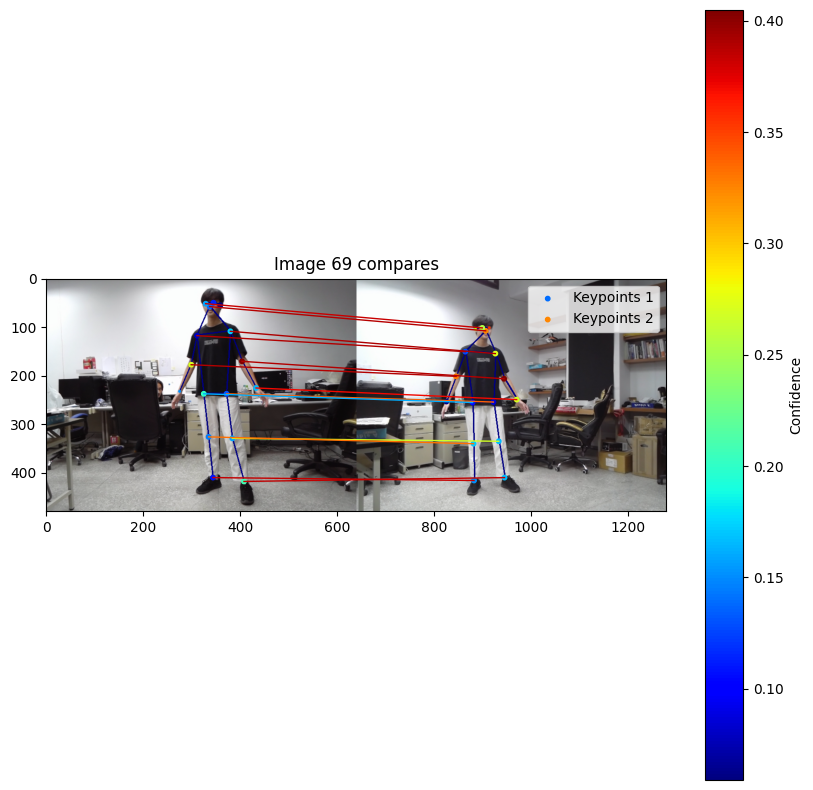

1233.0553278688524
1841.82982791587
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205356_0050.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205356_0050.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205356_0050.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205356_0050.png: (256, 15)


15 of keypoints are match


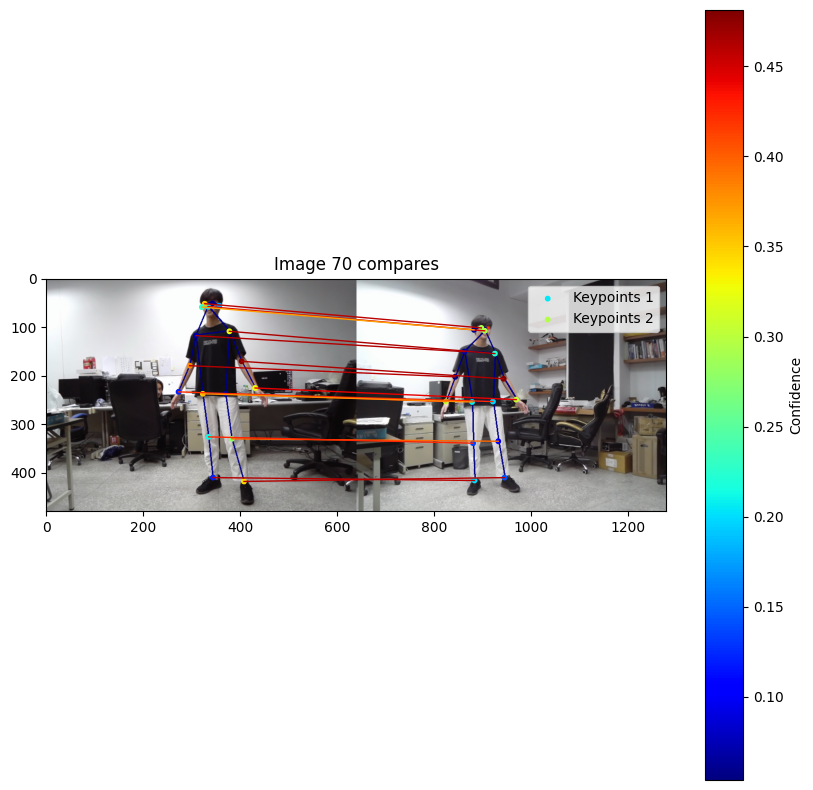

1241.2100840336134
2188.55
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205356_0051.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205356_0051.png: (14, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205356_0051.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205356_0051.png: (256, 14)


12 of keypoints are match


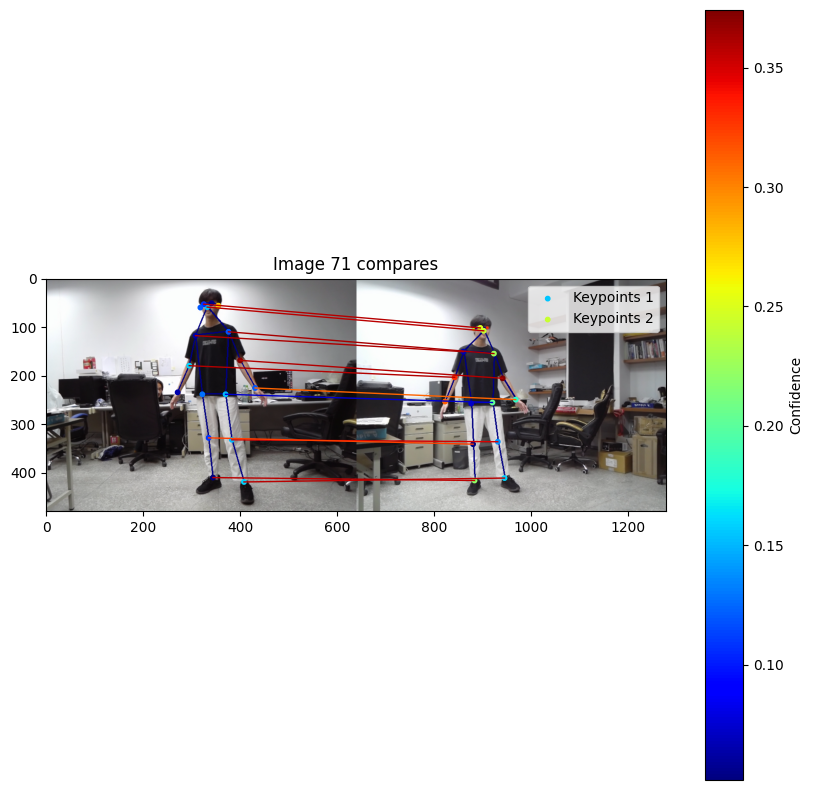

1643.2371794871794
2189.0474383301707
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205356_0052.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205356_0052.png: (14, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205356_0052.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205356_0052.png: (256, 14)


13 of keypoints are match


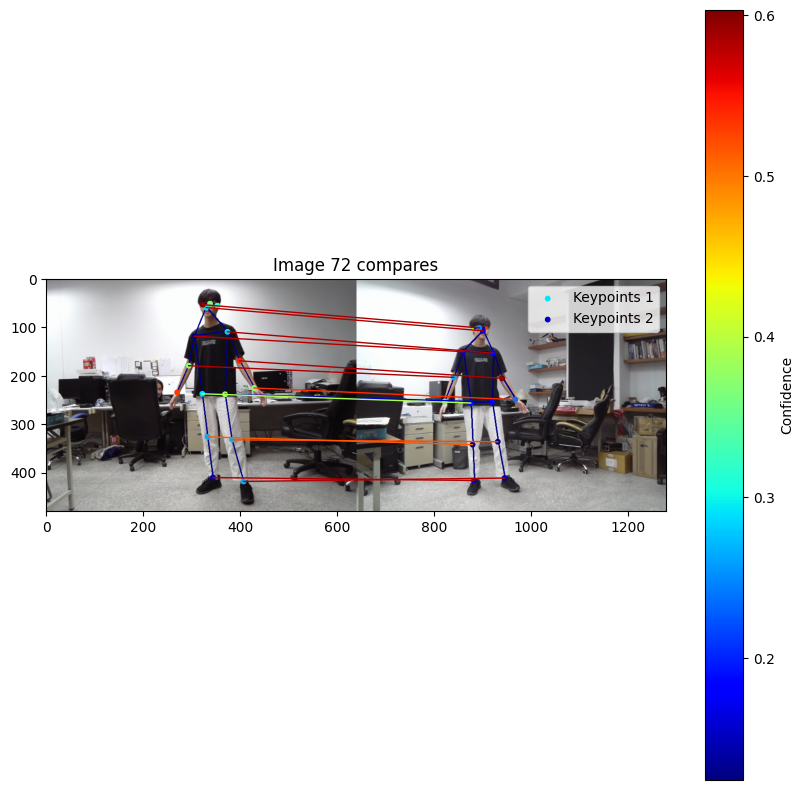

1238.0211416490486
1870.405303030303
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205356_0053.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205356_0053.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205356_0053.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205356_0053.png: (256, 15)


14 of keypoints are match


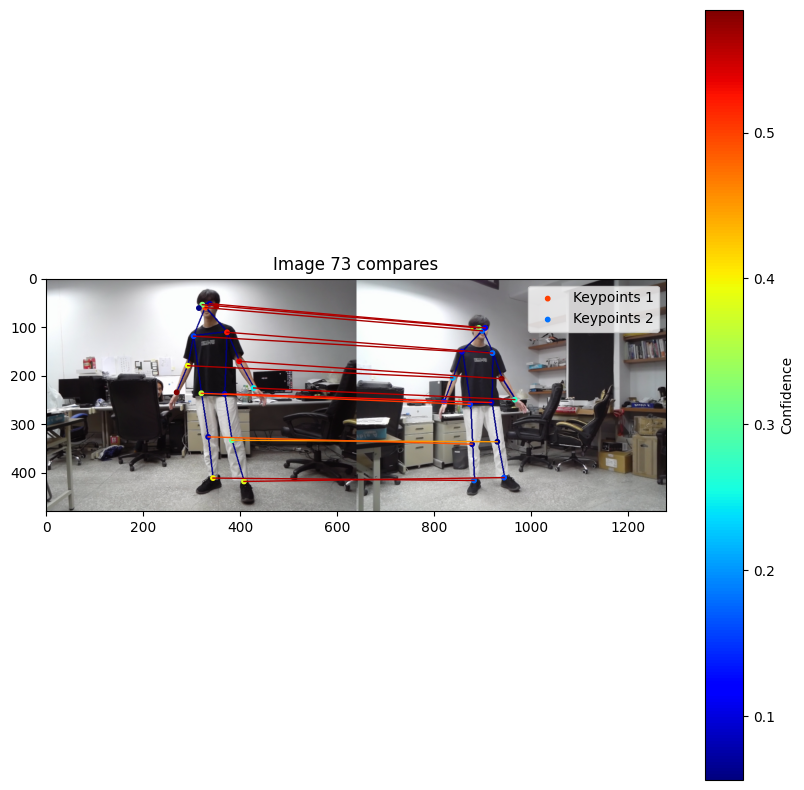

1615.8382352941176
2448.249523809524
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205356_0054.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205356_0054.png: (12, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205356_0054.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205356_0054.png: (256, 12)


12 of keypoints are match


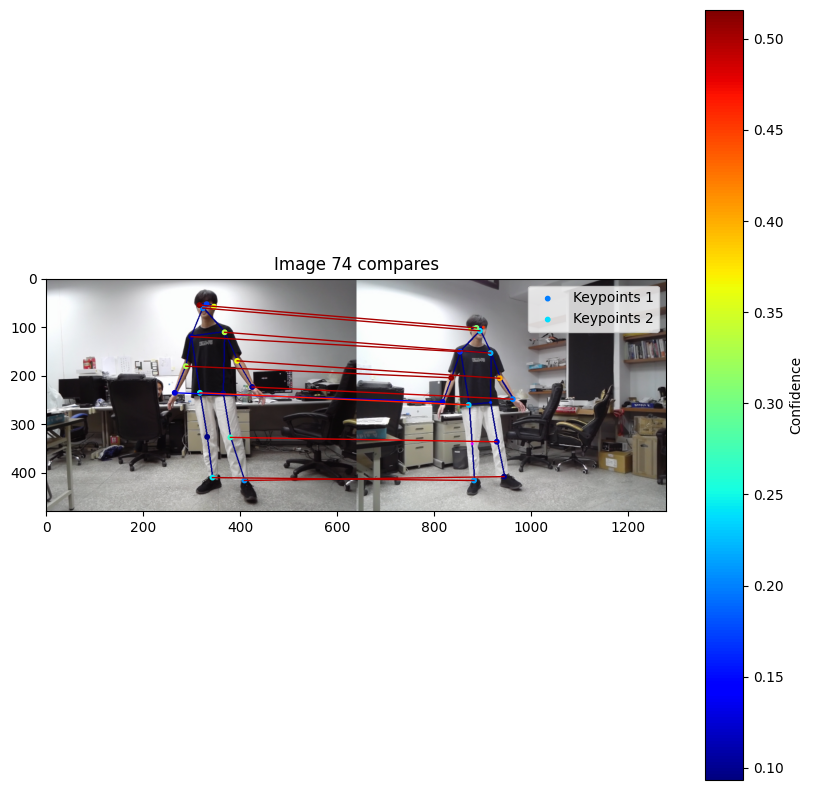

1791.3208333333334
2023.3206831119544
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205356_0055.png: (15, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205356_0055.png: (14, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205356_0055.png: (256, 15)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205356_0055.png: (256, 14)


13 of keypoints are match


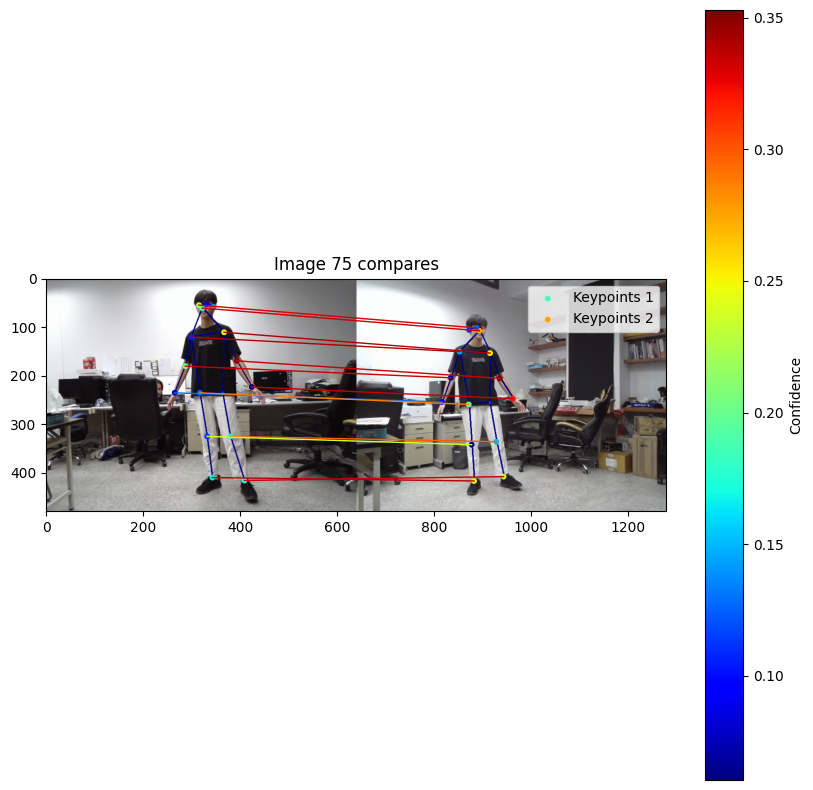

1597.4228329809725
2029.6940726577438
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205356_0056.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205356_0056.png: (14, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205356_0056.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205356_0056.png: (256, 14)


14 of keypoints are match


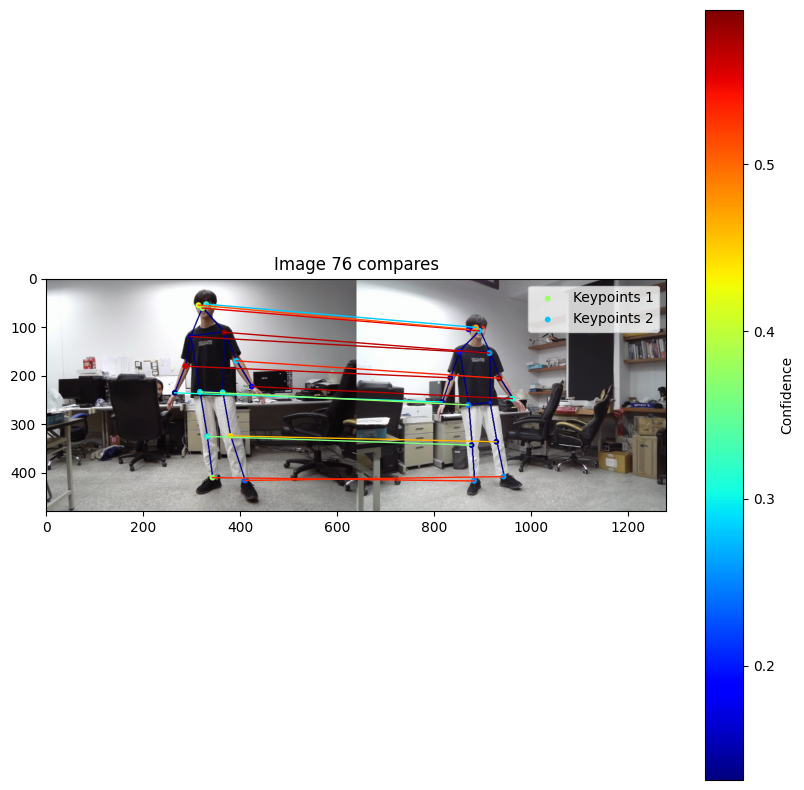

2031.289029535865
1482.2142857142858
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205356_0057.png: (15, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205356_0057.png: (16, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205356_0057.png: (256, 15)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205356_0057.png: (256, 16)


15 of keypoints are match


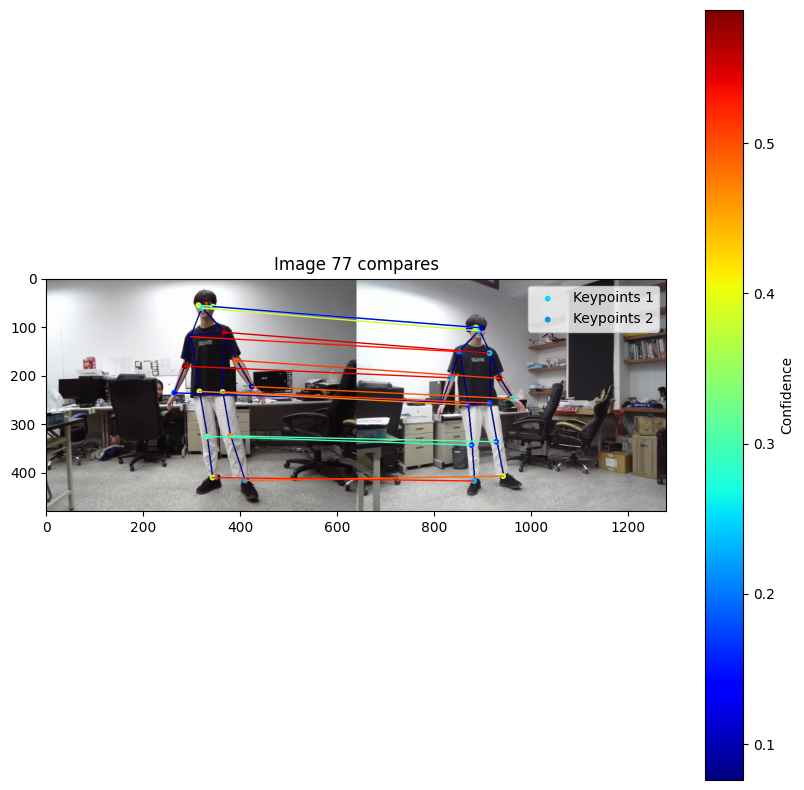

1967.6985138004247
1852.7846441947565
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205356_0058.png: (14, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205356_0058.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205356_0058.png: (256, 14)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205356_0058.png: (256, 15)


12 of keypoints are match


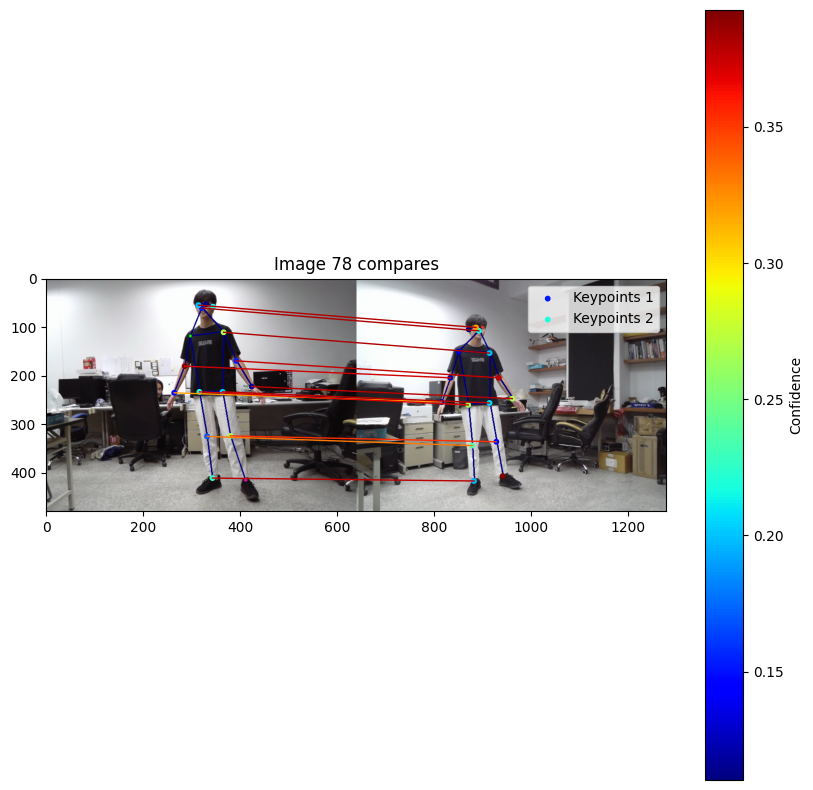

1196.031847133758
1839.487619047619
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205356_0059.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205356_0059.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205356_0059.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205356_0059.png: (256, 15)


13 of keypoints are match


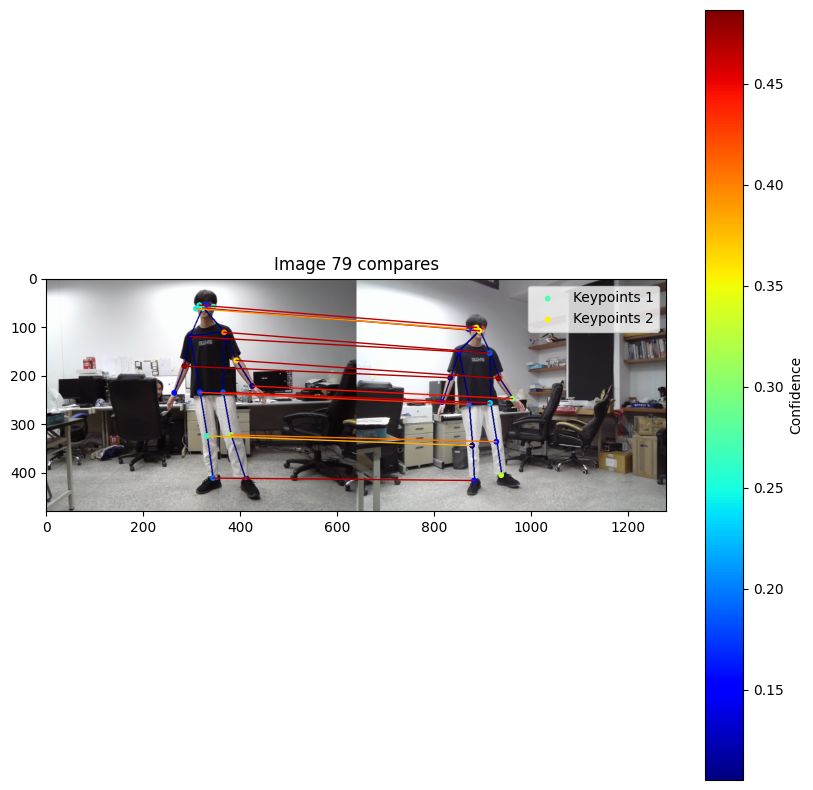

1192.1089743589744
1486.9619771863117
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205356_0060.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205356_0060.png: (16, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205356_0060.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205356_0060.png: (256, 16)


15 of keypoints are match


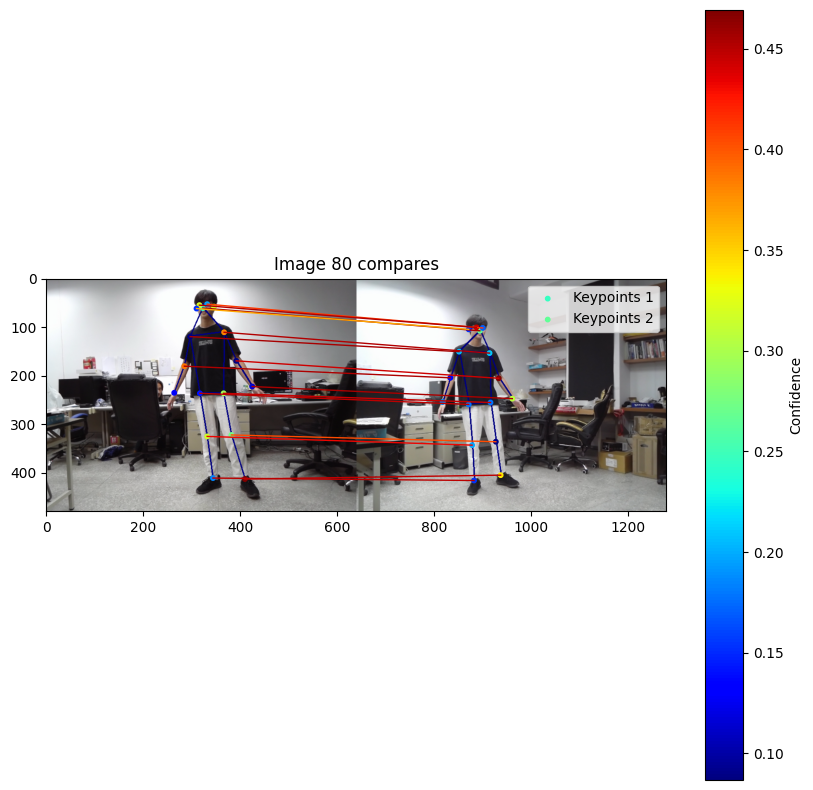

1573.5347368421053
2190.687969924812
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205356_0061.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205356_0061.png: (14, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205356_0061.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205356_0061.png: (256, 14)


12 of keypoints are match


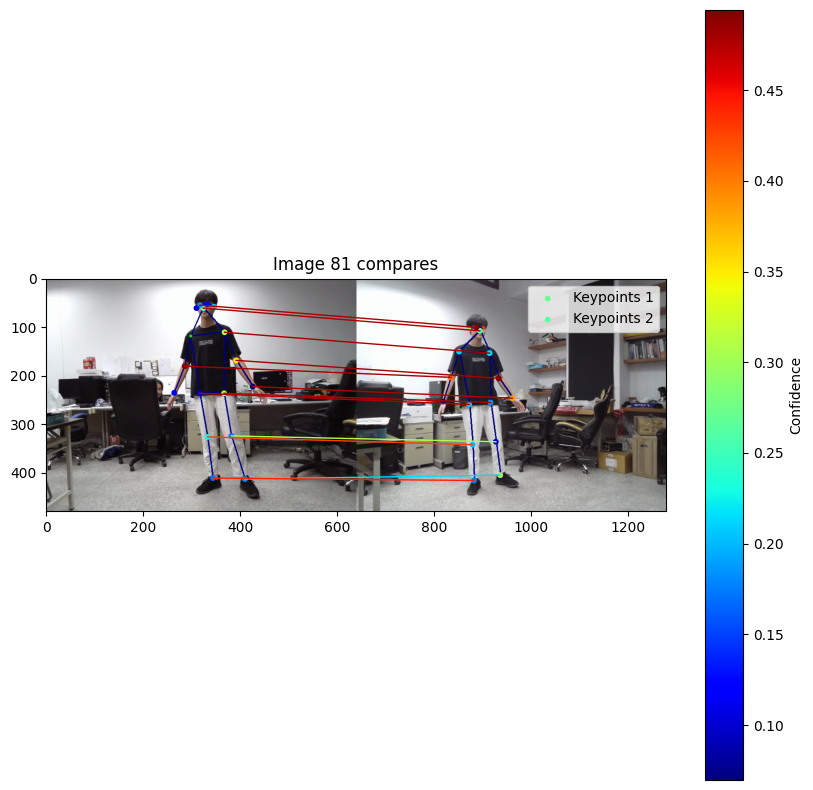

1224.236559139785
2050.9710982658958
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205356_0062.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205356_0062.png: (14, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205356_0062.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205356_0062.png: (256, 14)


14 of keypoints are match


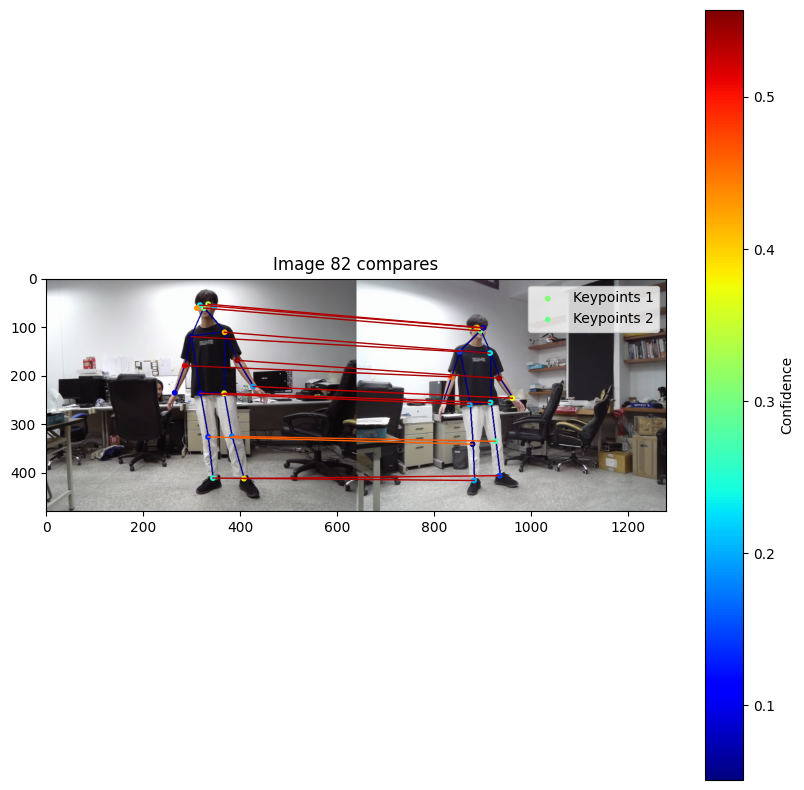

1211.734309623431
1892.0415879017014
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205357_0063.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205357_0063.png: (14, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205357_0063.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205357_0063.png: (256, 14)


13 of keypoints are match


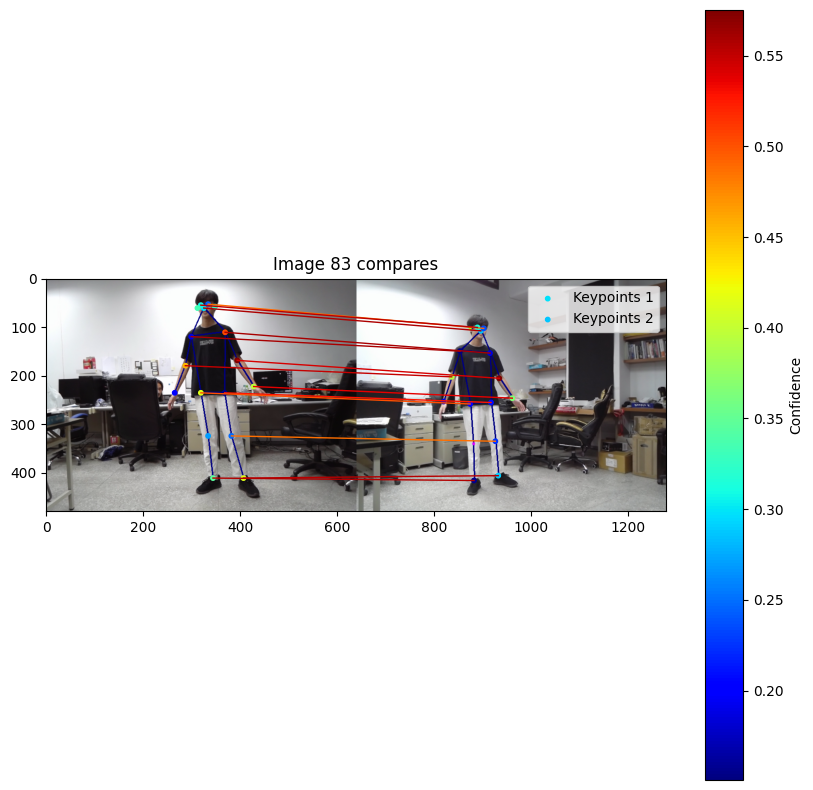

1196.1398305084747
1974.2562141491396
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205357_0064.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205357_0064.png: (14, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205357_0064.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205357_0064.png: (256, 14)


13 of keypoints are match


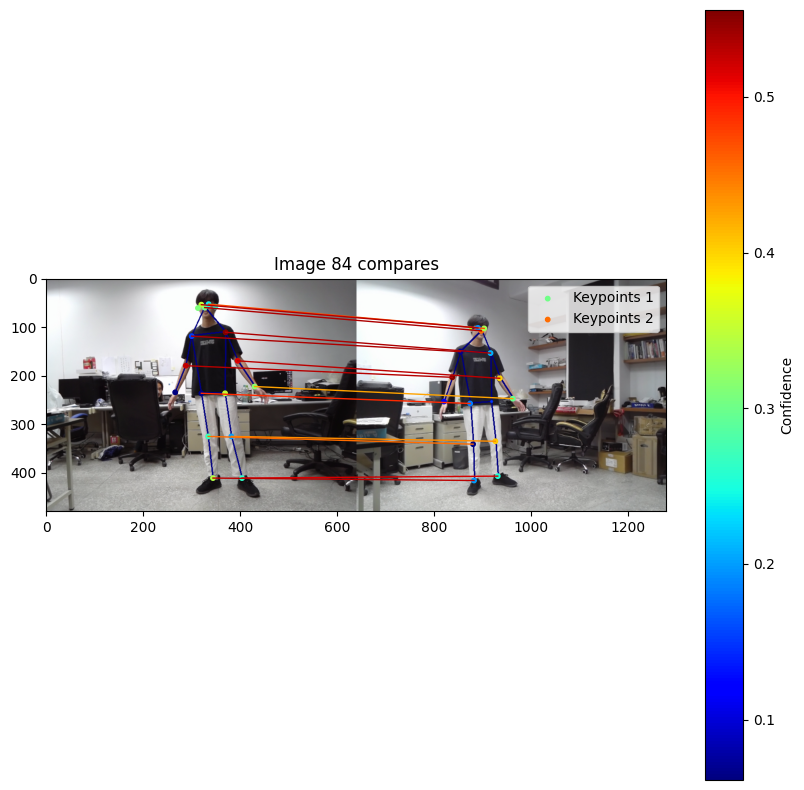

1557.8536082474227
1813.9032258064517
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205357_0065.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205357_0065.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205357_0065.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205357_0065.png: (256, 15)


13 of keypoints are match


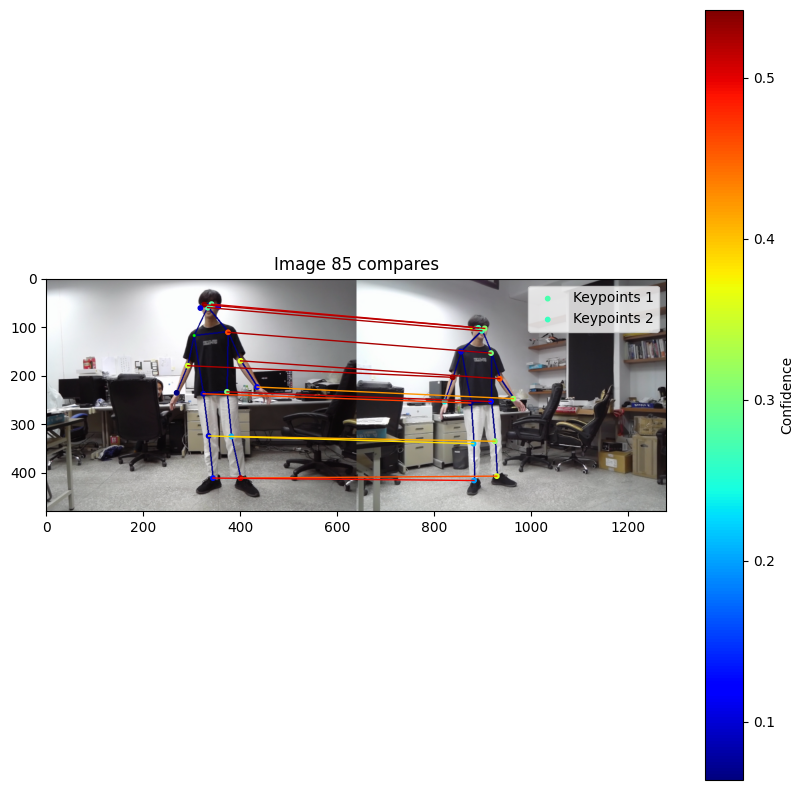

1168.4647302904564
1809.4770114942528
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205357_0066.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205357_0066.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205357_0066.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205357_0066.png: (256, 15)


15 of keypoints are match


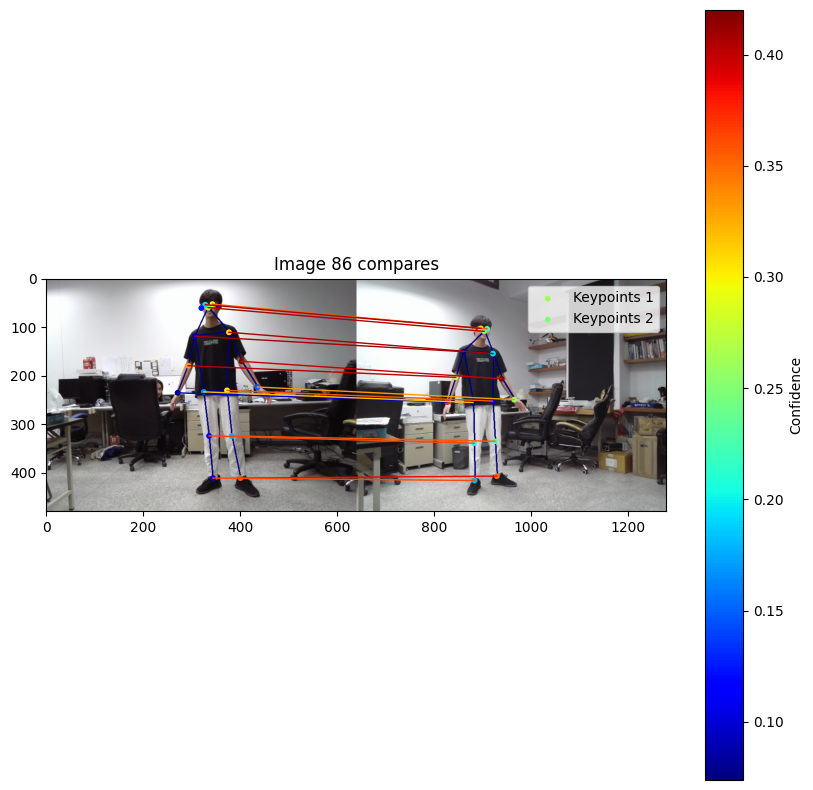

1166.3702928870293
1849.131021194605
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205357_0067.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205357_0067.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205357_0067.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205357_0067.png: (256, 15)


14 of keypoints are match


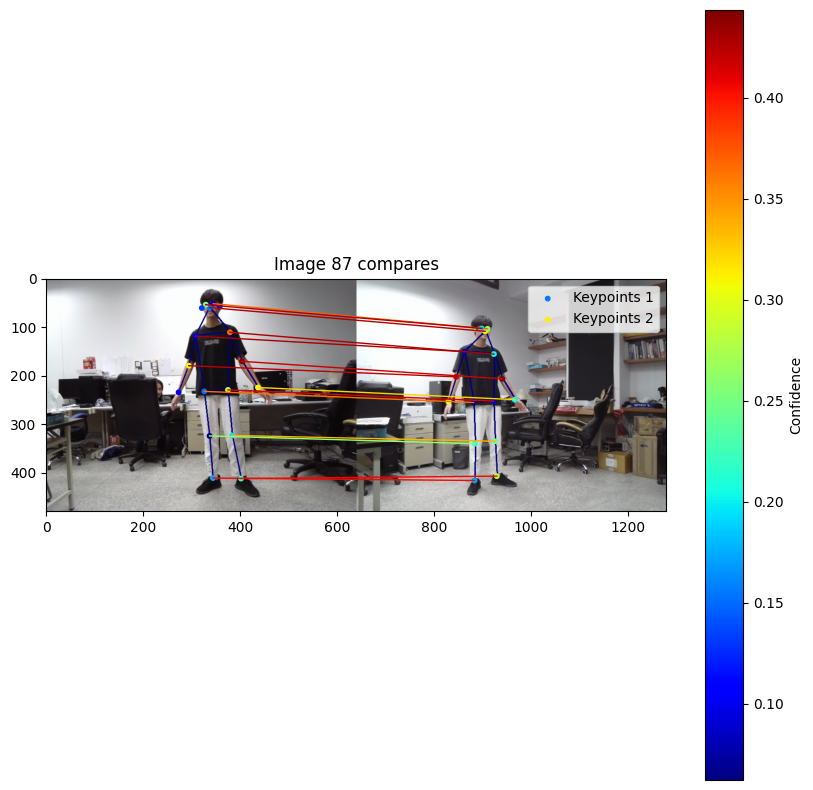

1194.4442148760331
2001.2163742690059
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205357_0068.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205357_0068.png: (14, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205357_0068.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205357_0068.png: (256, 14)


13 of keypoints are match


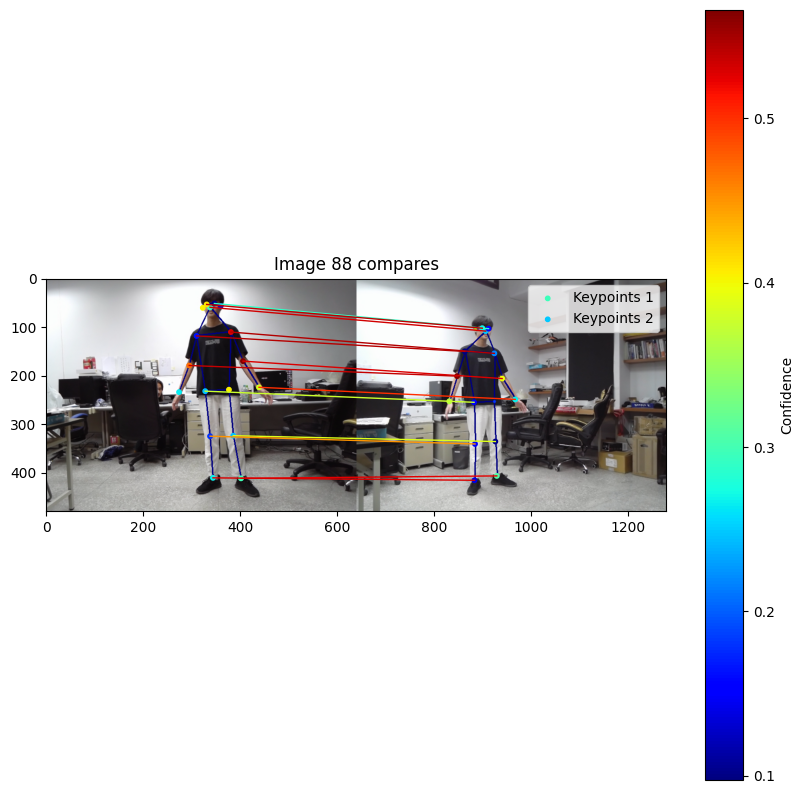

1262.2642706131078
1988.5372848948375
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205357_0069.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205357_0069.png: (14, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205357_0069.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205357_0069.png: (256, 14)


13 of keypoints are match


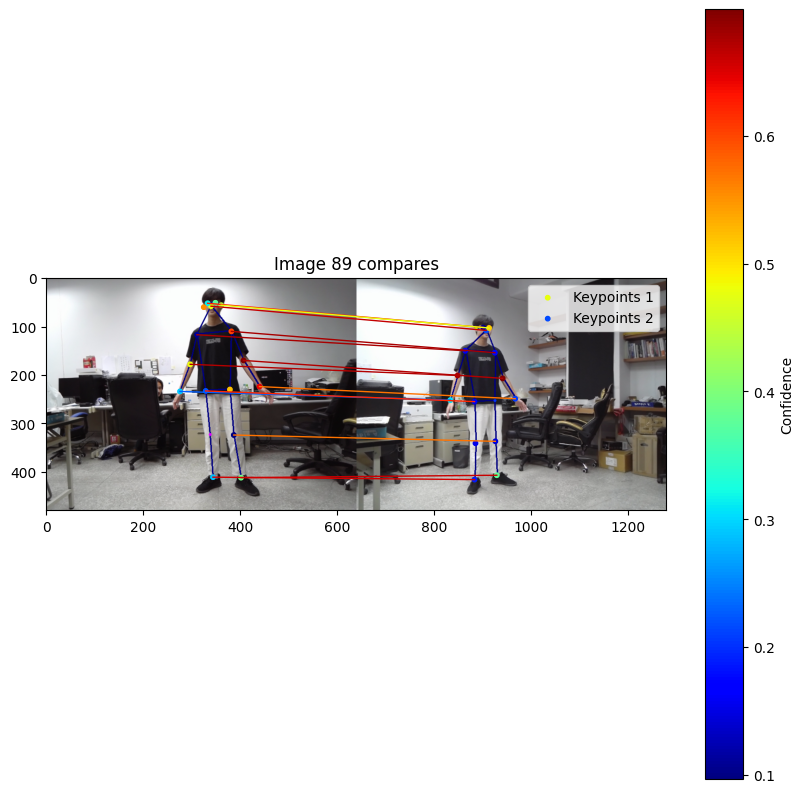

1445.522448979592
2130.757575757576
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205357_0070.png: (15, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205357_0070.png: (14, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205357_0070.png: (256, 15)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205357_0070.png: (256, 14)


12 of keypoints are match


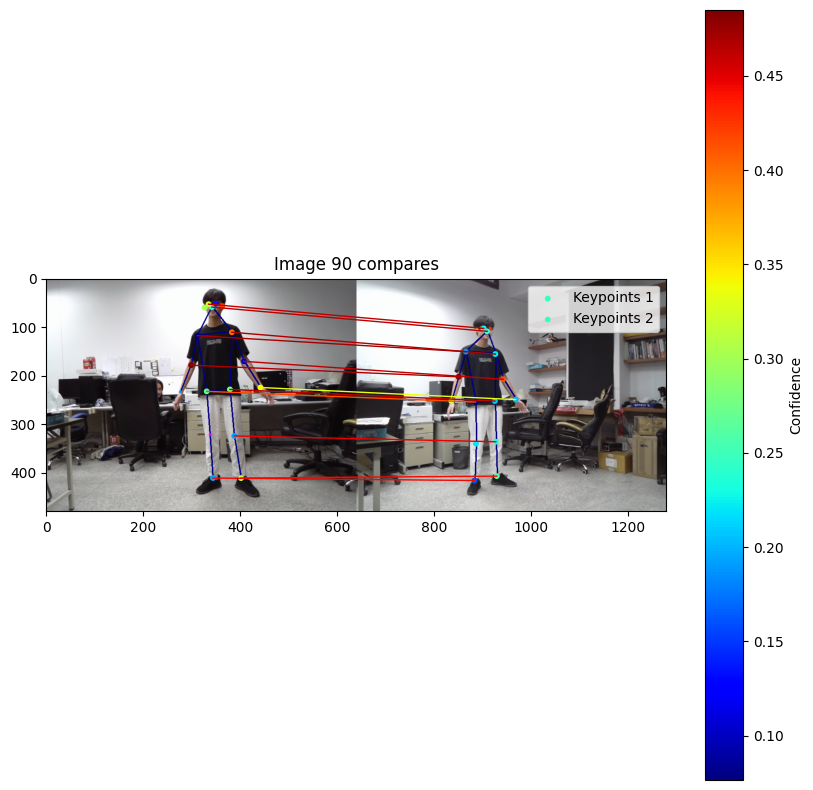

1378.624229979466
2032.069724770642
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205357_0071.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205357_0071.png: (13, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205357_0071.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205357_0071.png: (256, 13)


12 of keypoints are match


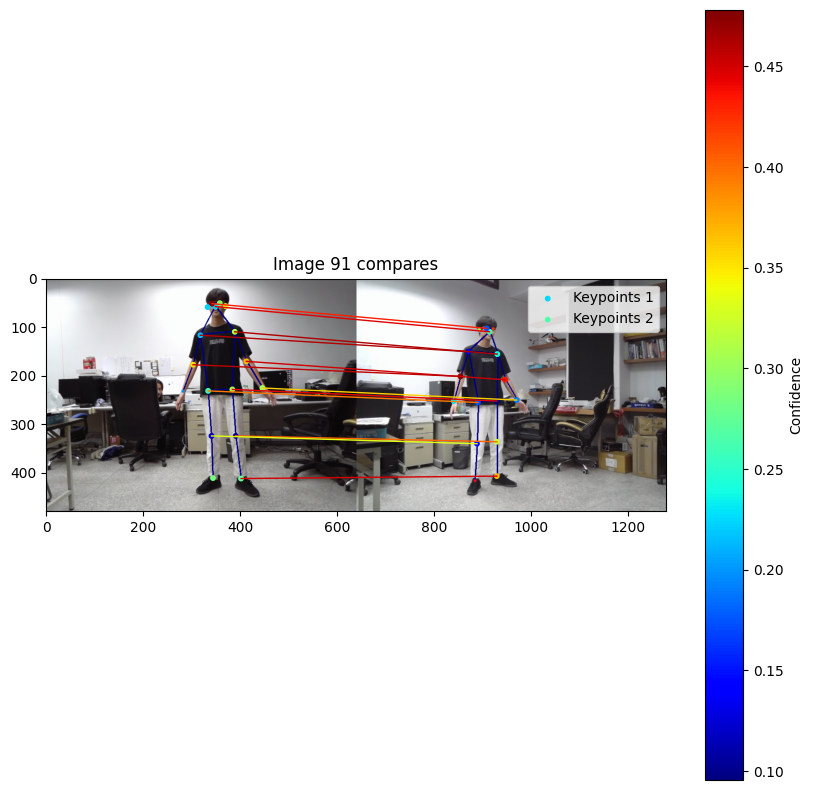

1194.1690427698575
1861.467889908257
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205357_0072.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205357_0072.png: (13, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205357_0072.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205357_0072.png: (256, 13)


13 of keypoints are match


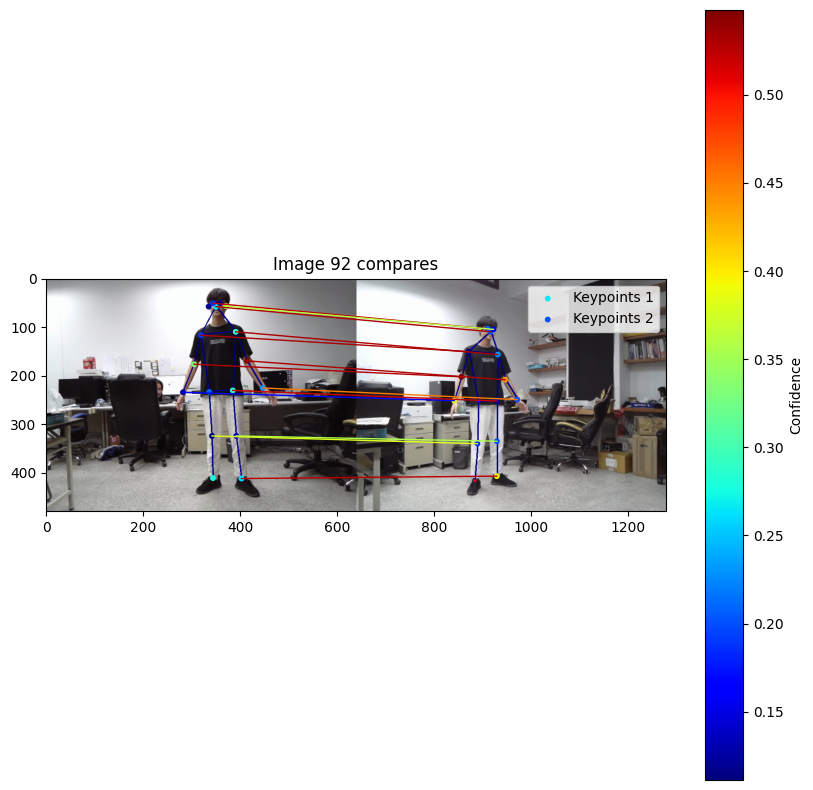

1569.829918032787
2028.168458781362
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205357_0073.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205357_0073.png: (13, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205357_0073.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205357_0073.png: (256, 13)


13 of keypoints are match


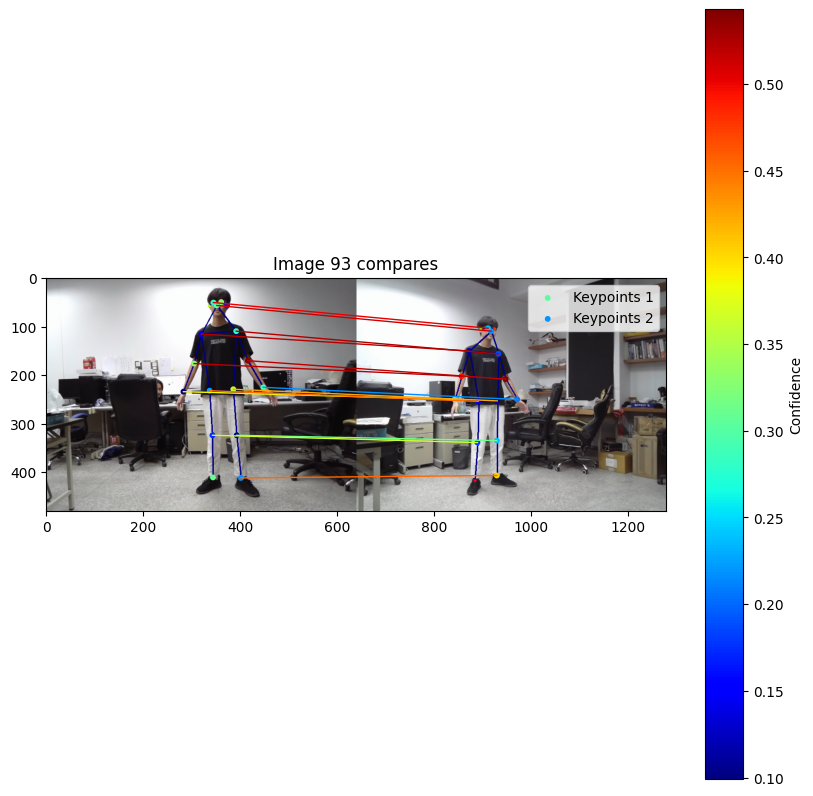

1193.2268907563025
2133.4090056285177
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205357_0074.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205357_0074.png: (13, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205357_0074.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205357_0074.png: (256, 13)


13 of keypoints are match


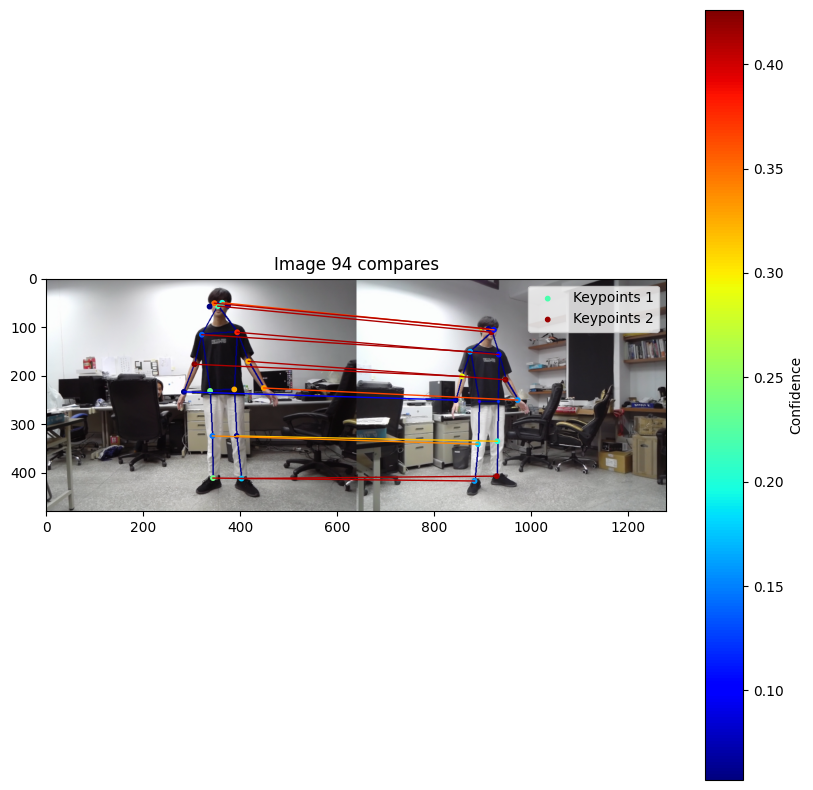

1171.8189300411523
2128.7992351816442
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205357_0075.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205357_0075.png: (14, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205357_0075.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205357_0075.png: (256, 14)


13 of keypoints are match


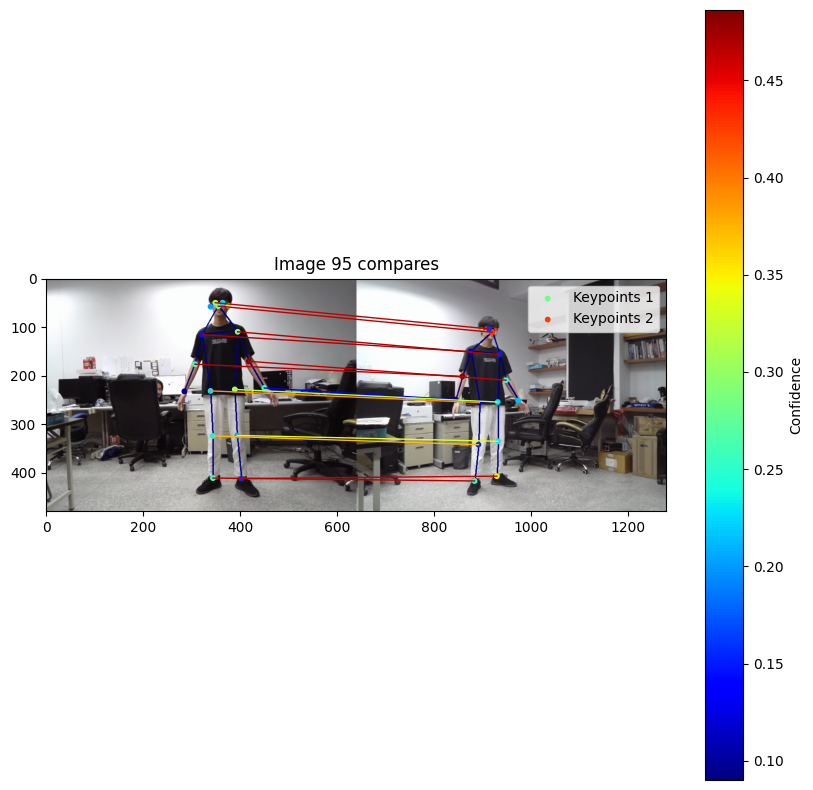

1173.01652892562
1779.876660341556
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205357_0076.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205357_0076.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205357_0076.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205357_0076.png: (256, 15)


15 of keypoints are match


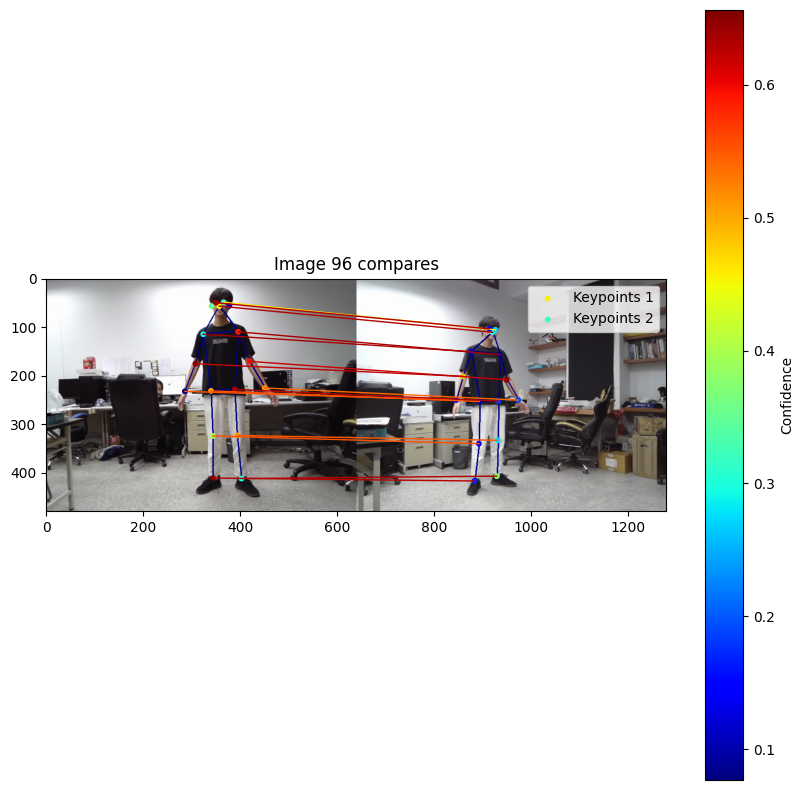

1206.4946695095948
2168.9466192170817
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205357_0077.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205357_0077.png: (12, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205357_0077.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205357_0077.png: (256, 12)


12 of keypoints are match


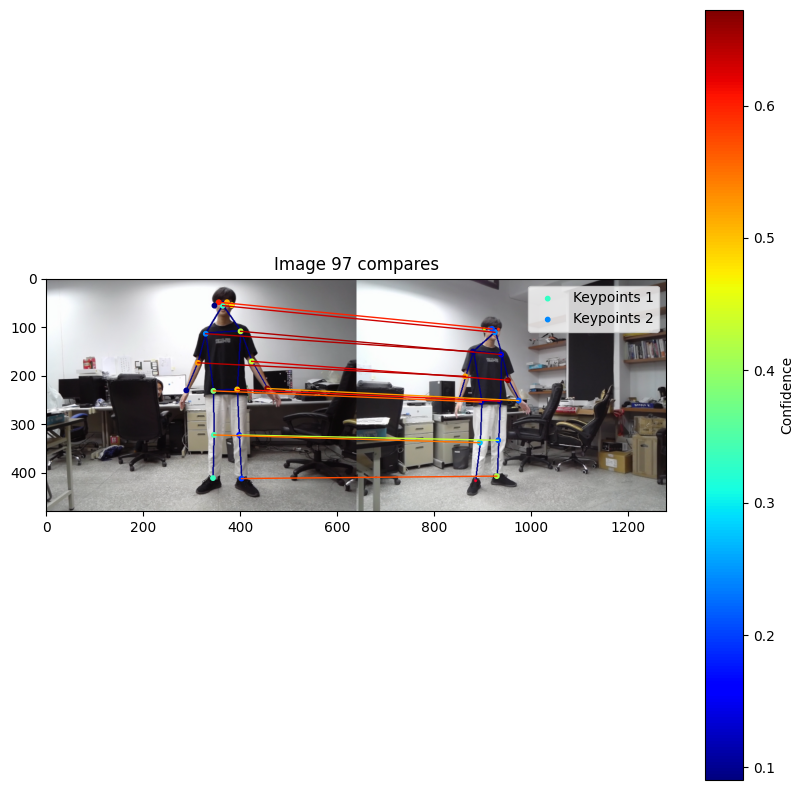

1295.4138655462184
1736.3906542056075
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205357_0078.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205357_0078.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205357_0078.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205357_0078.png: (256, 15)


14 of keypoints are match


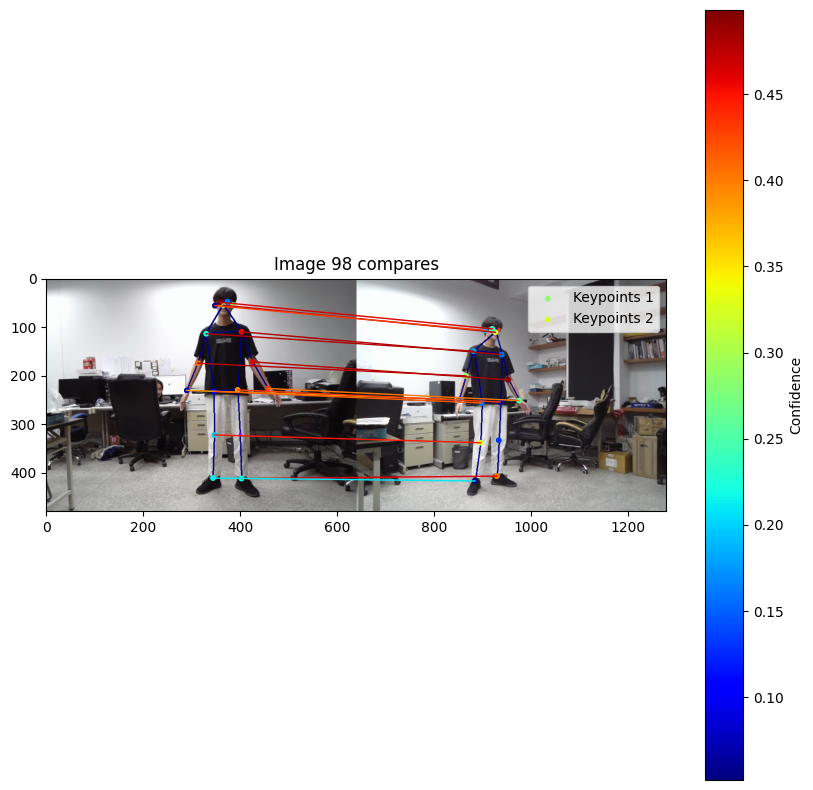

1296.5622317596567
1729.1412844036697
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205357_0079.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205357_0079.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205357_0079.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205357_0079.png: (256, 15)


14 of keypoints are match


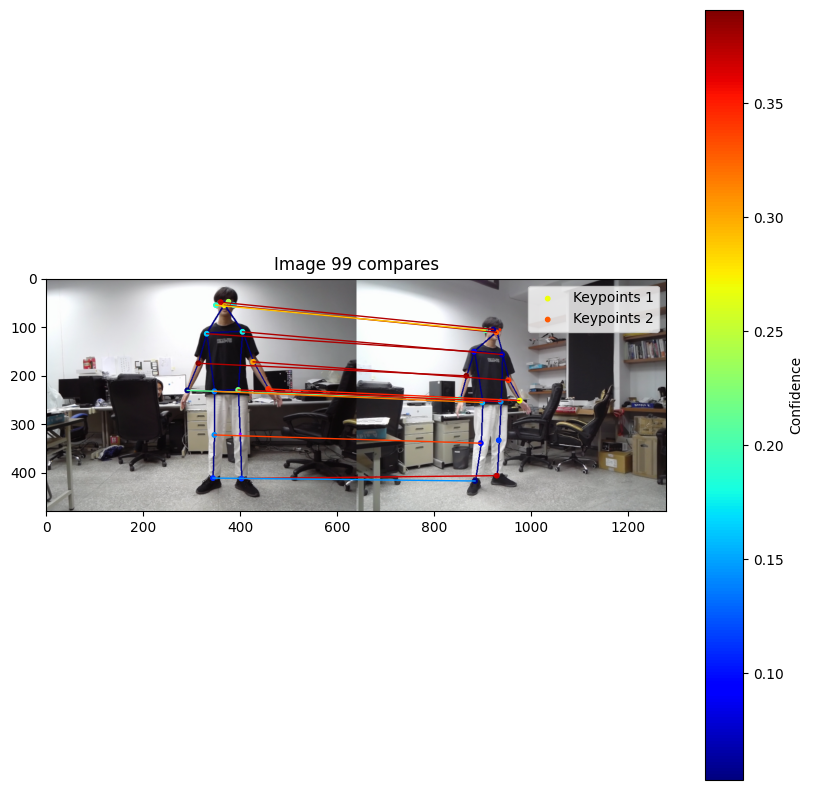

1216.509394572025
1688.4874551971327
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205357_0080.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205357_0080.png: (14, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205357_0080.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205357_0080.png: (256, 14)


14 of keypoints are match


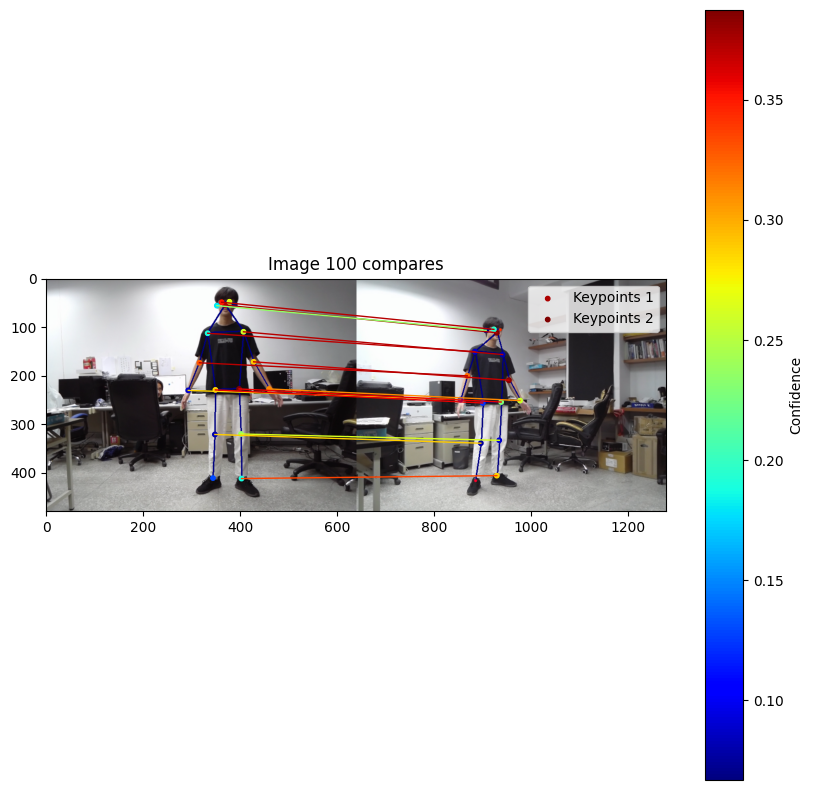

1217.6539278131636
1752.8736059479554
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205357_0081.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205357_0081.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205357_0081.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205357_0081.png: (256, 15)


15 of keypoints are match


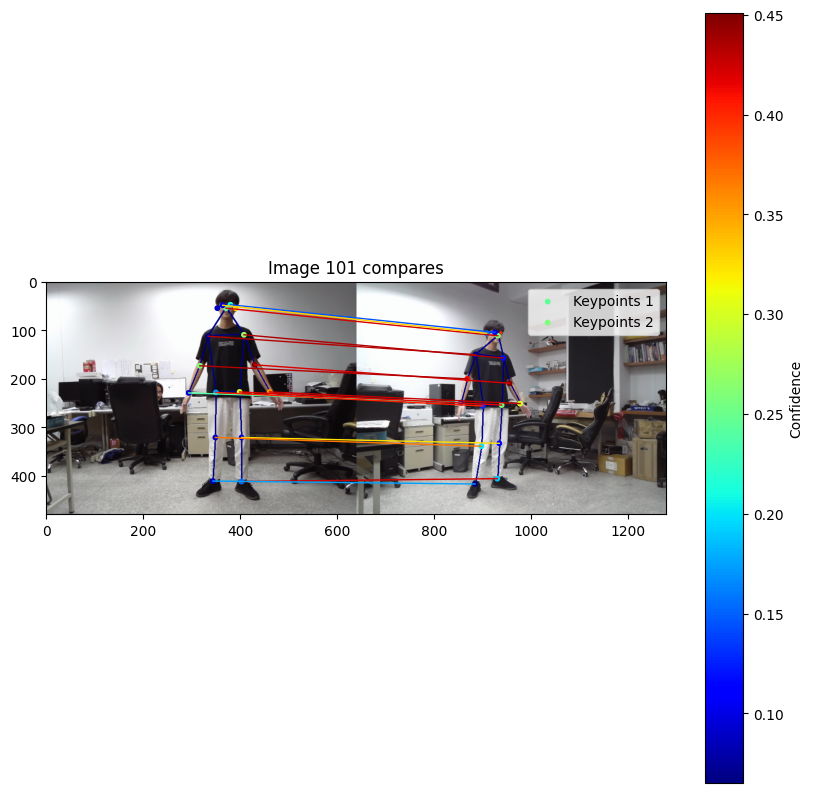

1445.2632696390658
1684.7585585585587
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205357_0082.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205357_0082.png: (14, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205357_0082.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205357_0082.png: (256, 14)


13 of keypoints are match


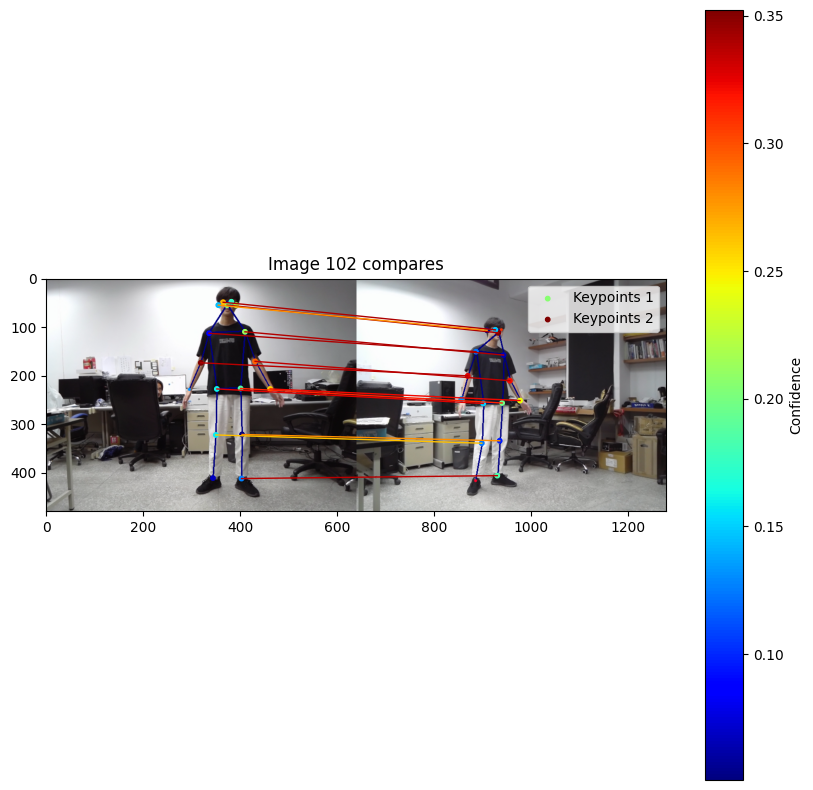

1230.3695198329854
1683.858422939068
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205358_0083.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205358_0083.png: (14, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205358_0083.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205358_0083.png: (256, 14)


14 of keypoints are match


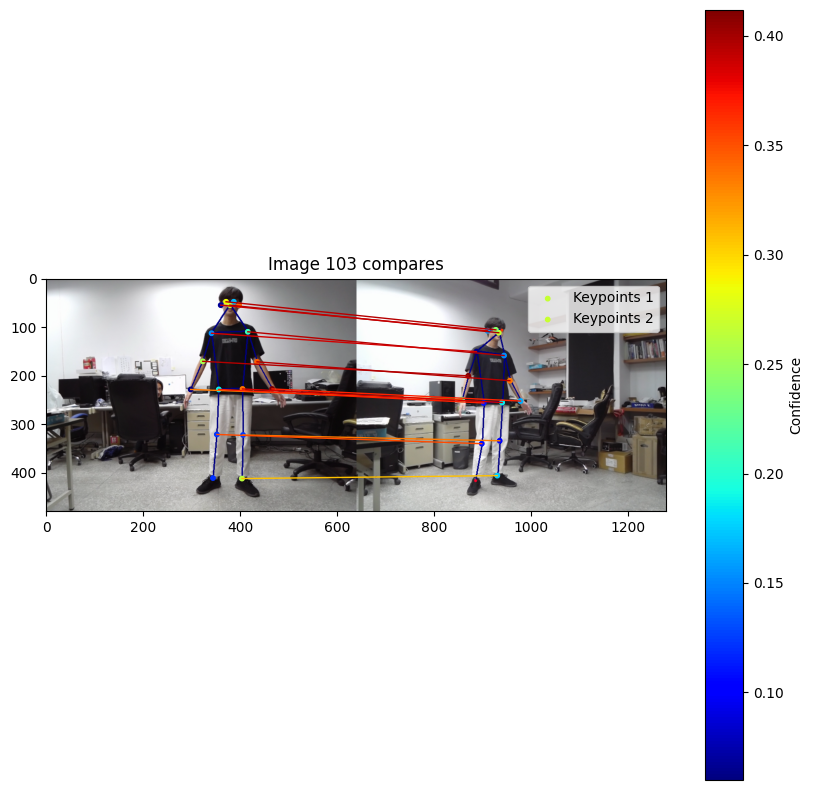

1227.1604938271605
1644.1571428571428
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205358_0084.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205358_0084.png: (14, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205358_0084.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205358_0084.png: (256, 14)


14 of keypoints are match


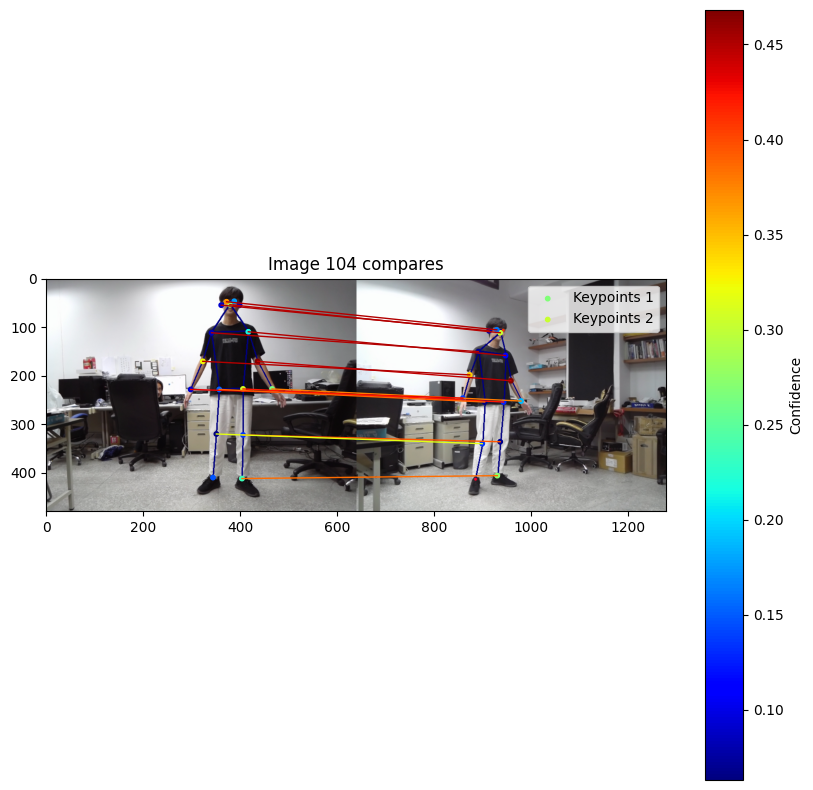

1533.8157389635317
1767.6360153256705
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205358_0085.png: (15, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205358_0085.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205358_0085.png: (256, 15)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205358_0085.png: (256, 15)


13 of keypoints are match


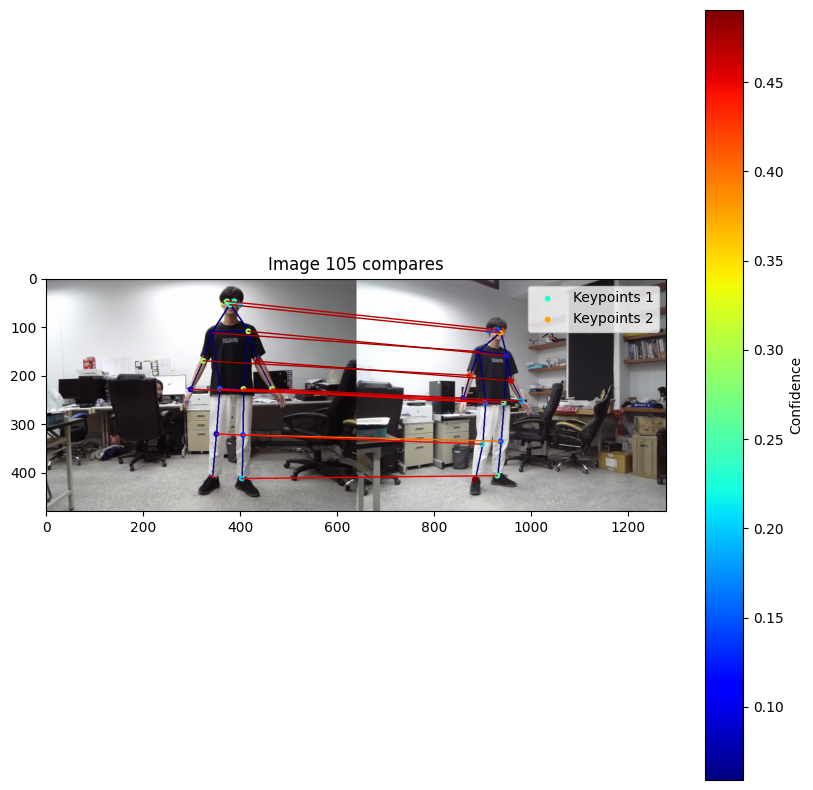

1646.219008264463
1747.7590132827324
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205358_0086.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205358_0086.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205358_0086.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205358_0086.png: (256, 15)


14 of keypoints are match


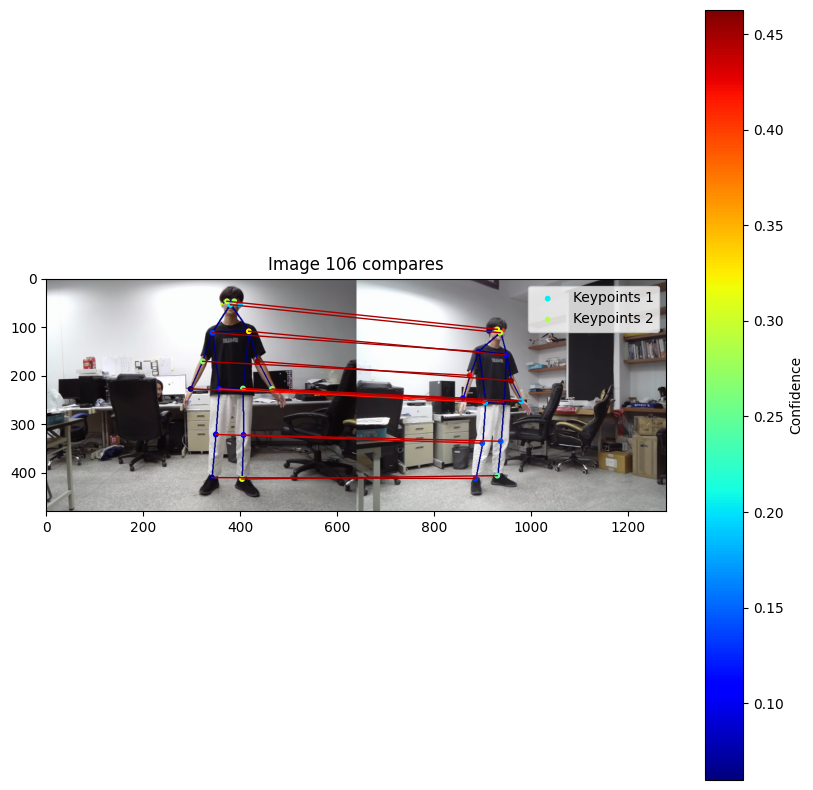

1218.5773195876288
1733.3058161350843
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205358_0087.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205358_0087.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205358_0087.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205358_0087.png: (256, 15)


15 of keypoints are match


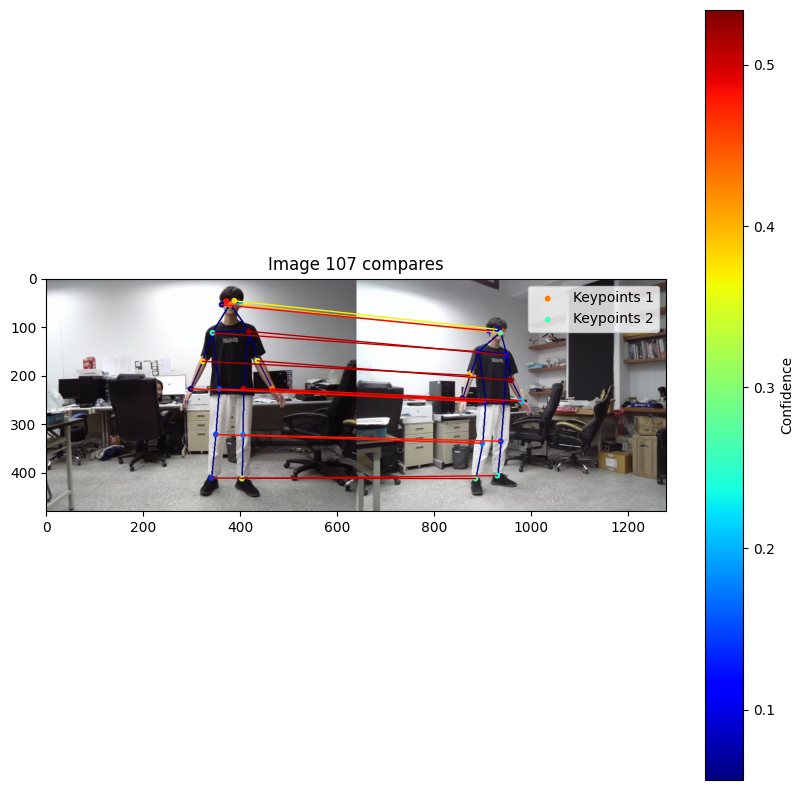

1191.134693877551
1736.1221374045801
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205358_0088.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205358_0088.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205358_0088.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205358_0088.png: (256, 15)


15 of keypoints are match


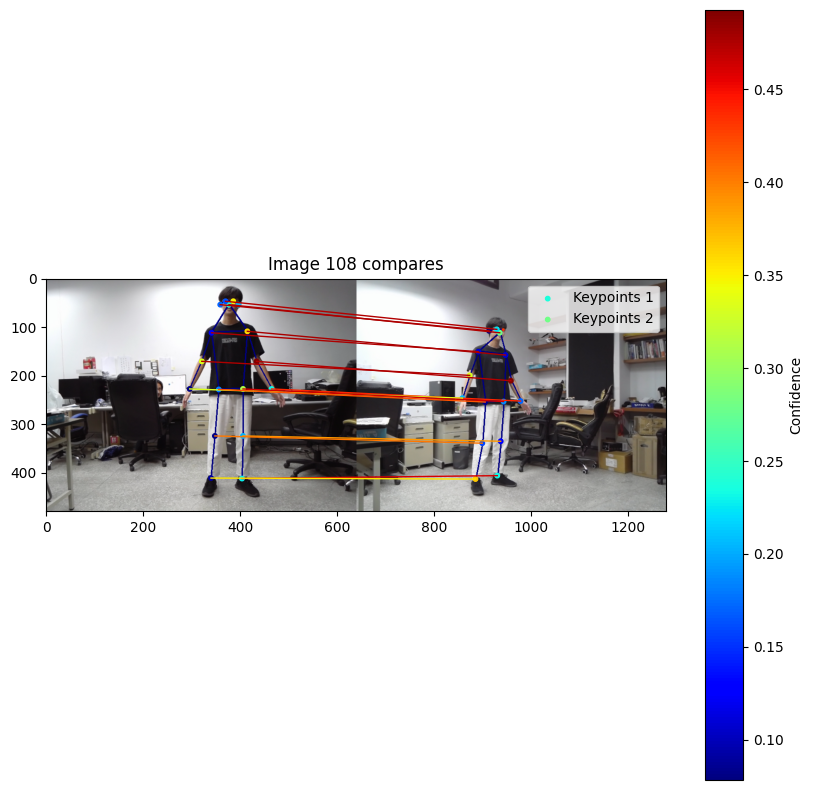

1147.5621301775147
1750.3492366412213
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205358_0089.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205358_0089.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205358_0089.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205358_0089.png: (256, 15)


14 of keypoints are match


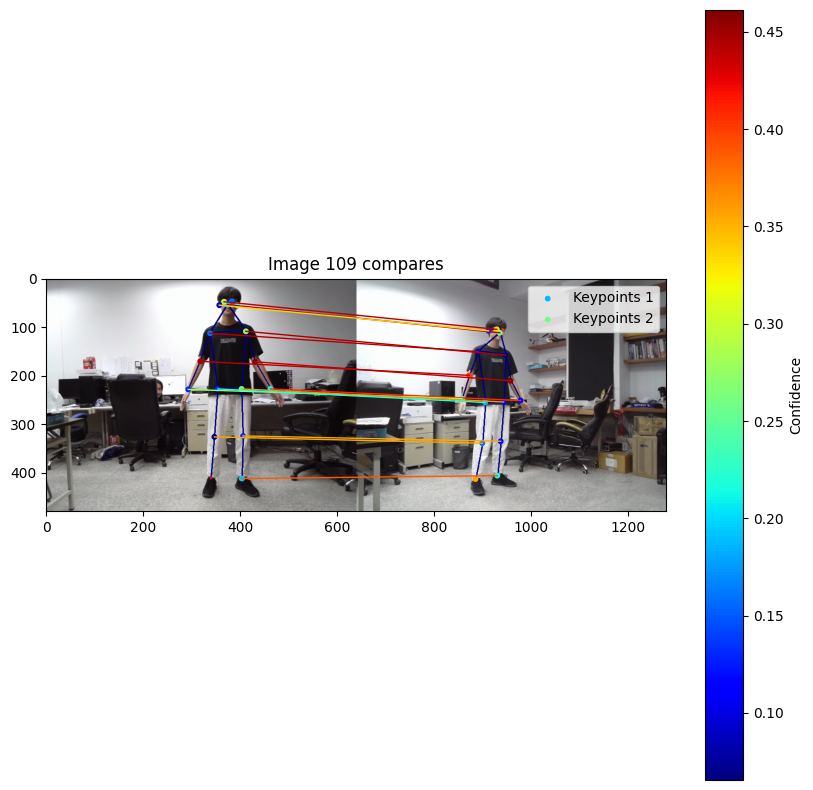

1434.4978632478633
1773.208092485549
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205358_0090.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205358_0090.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205358_0090.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205358_0090.png: (256, 15)


14 of keypoints are match


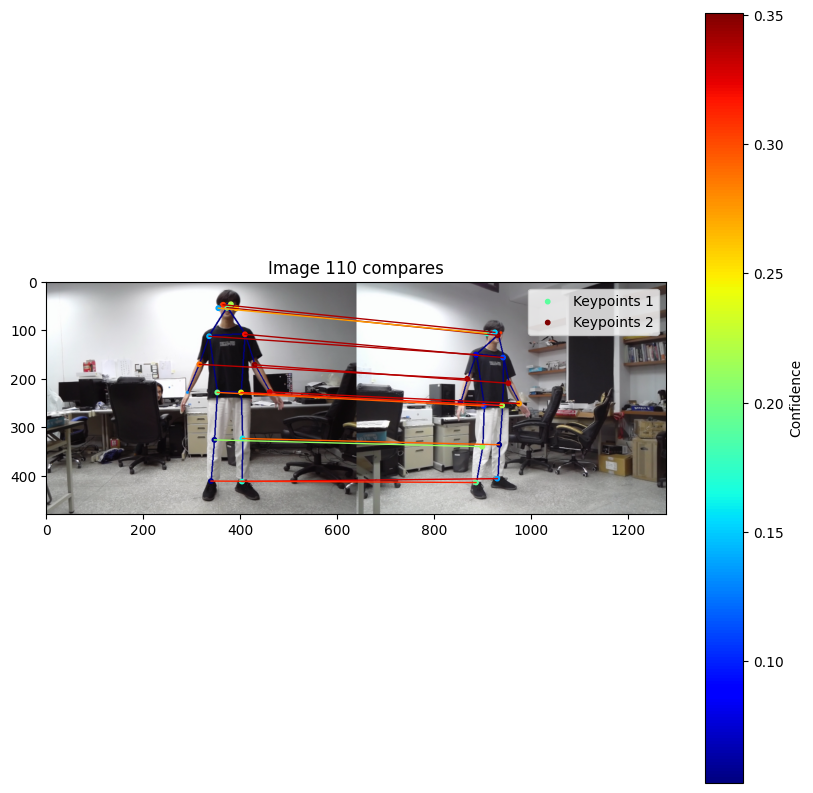

1432.1545064377683
1766.1638418079096
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205358_0091.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205358_0091.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205358_0091.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205358_0091.png: (256, 15)


14 of keypoints are match


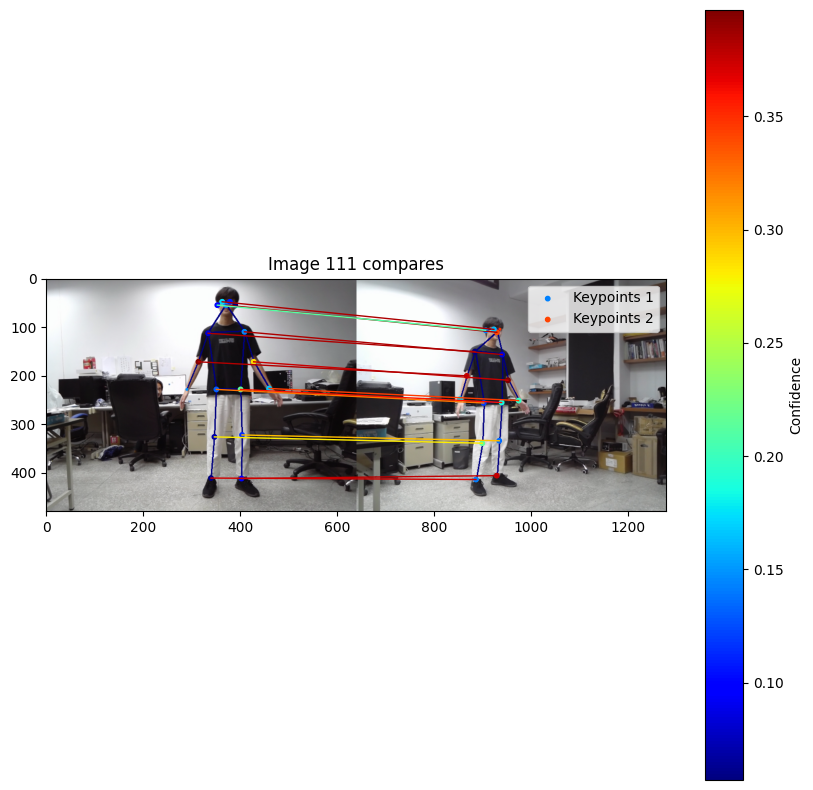

1198.8926315789474
1771.1016635859519
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205358_0092.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205358_0092.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205358_0092.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205358_0092.png: (256, 15)


15 of keypoints are match


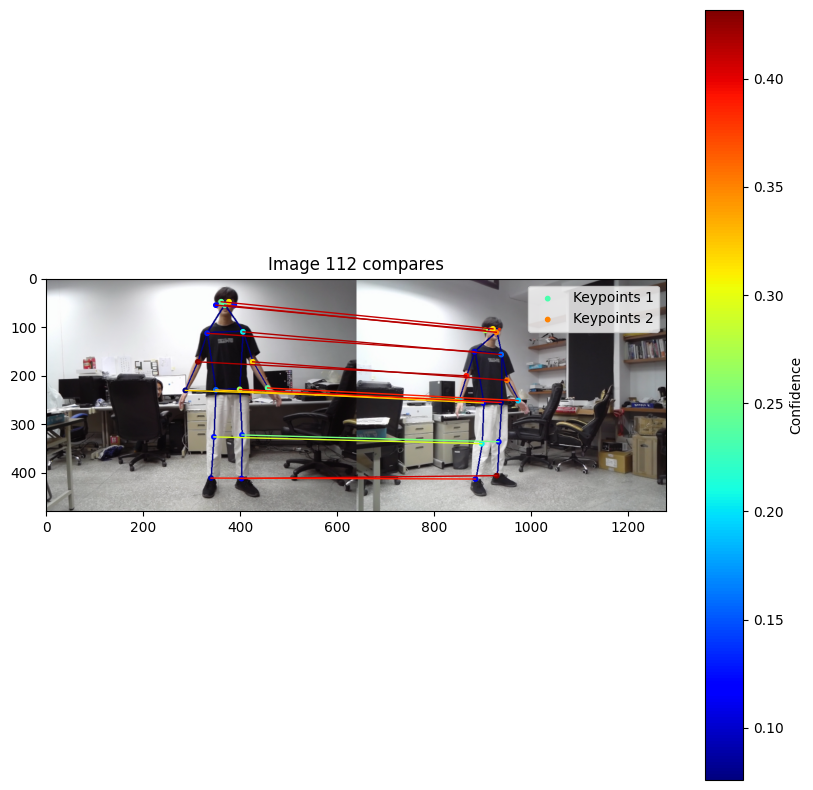

1221.3918629550321
1959.2765151515152
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205358_0093.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205358_0093.png: (14, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205358_0093.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205358_0093.png: (256, 14)


14 of keypoints are match


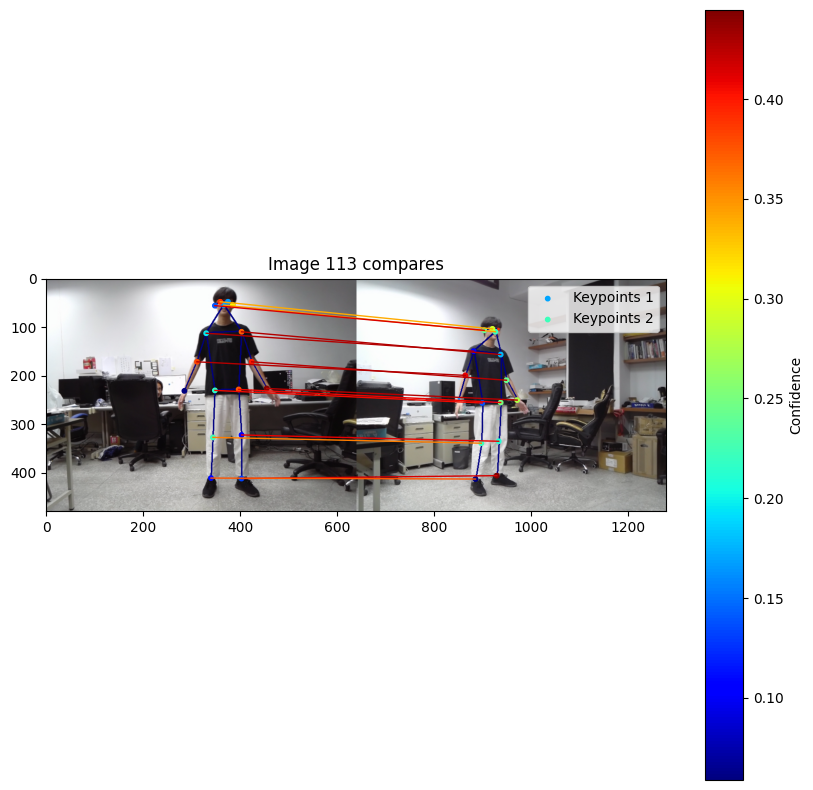

1403.2961373390558
2089.3973880597014
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205358_0094.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205358_0094.png: (14, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205358_0094.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205358_0094.png: (256, 14)


13 of keypoints are match


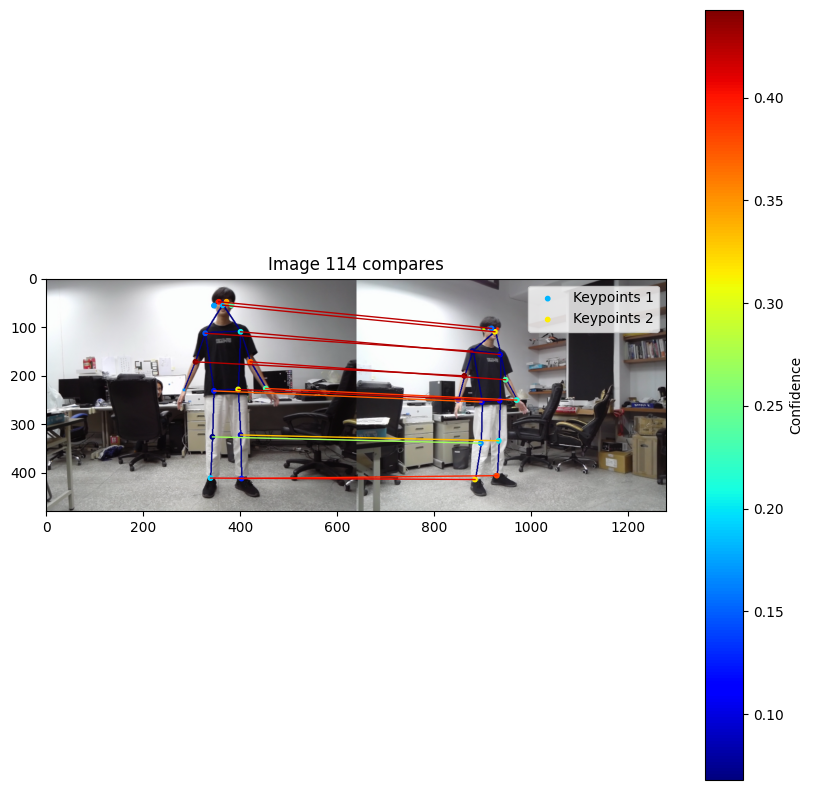

1420.5115789473684
1739.0890538033395
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205358_0095.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205358_0095.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205358_0095.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205358_0095.png: (256, 15)


14 of keypoints are match


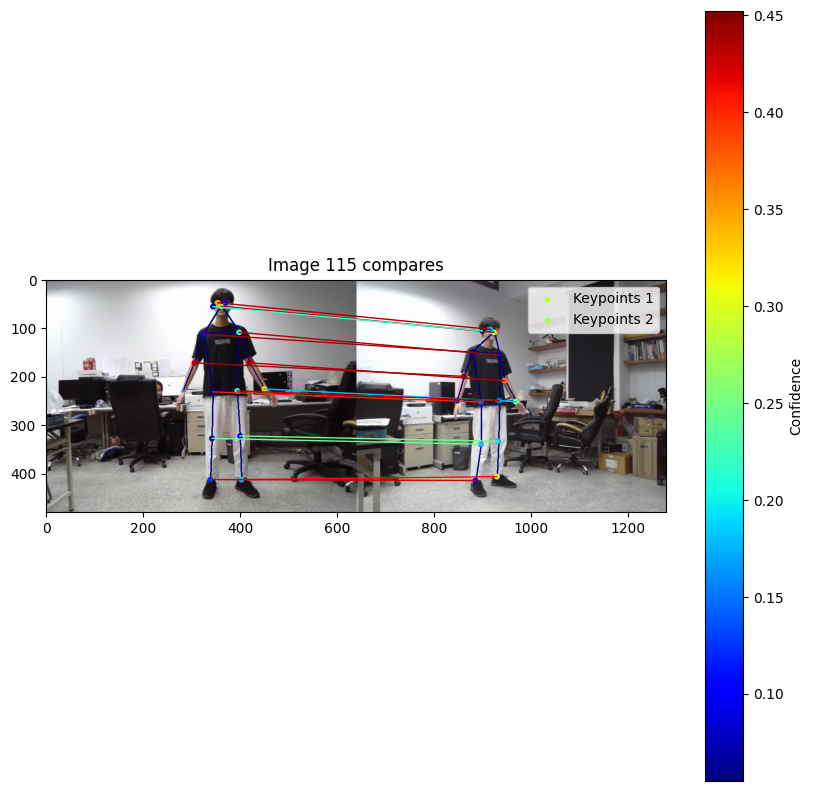

1778.805439330544
2408.0018832391715
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205358_0096.png: (13, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205358_0096.png: (13, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205358_0096.png: (256, 13)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205358_0096.png: (256, 13)


9 of keypoints are match


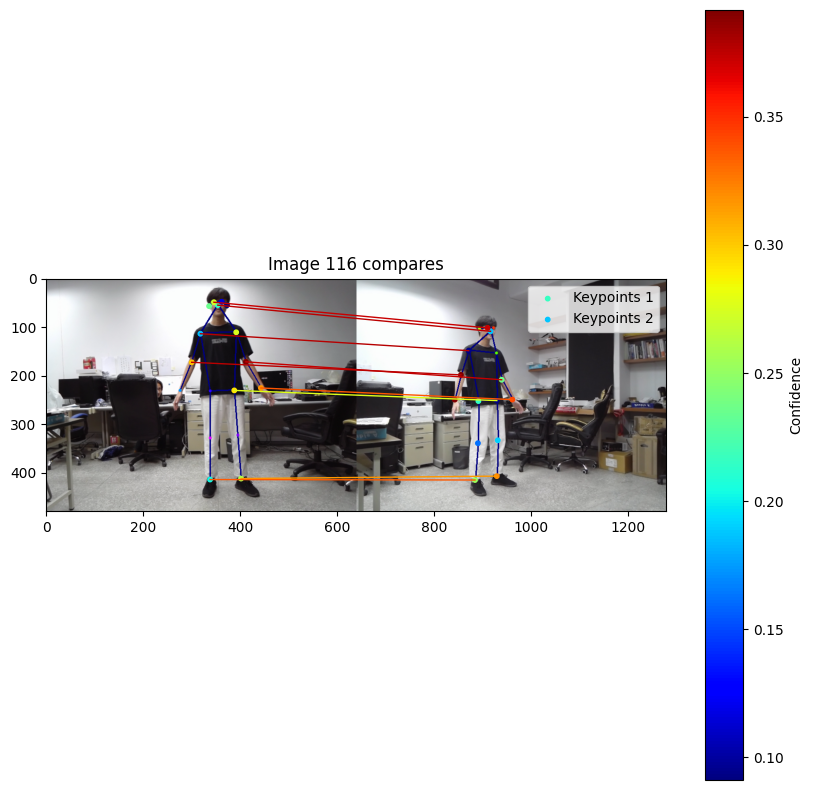

1167.7712550607287
1774.7090239410682
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205358_0097.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205358_0097.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205358_0097.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205358_0097.png: (256, 15)


15 of keypoints are match


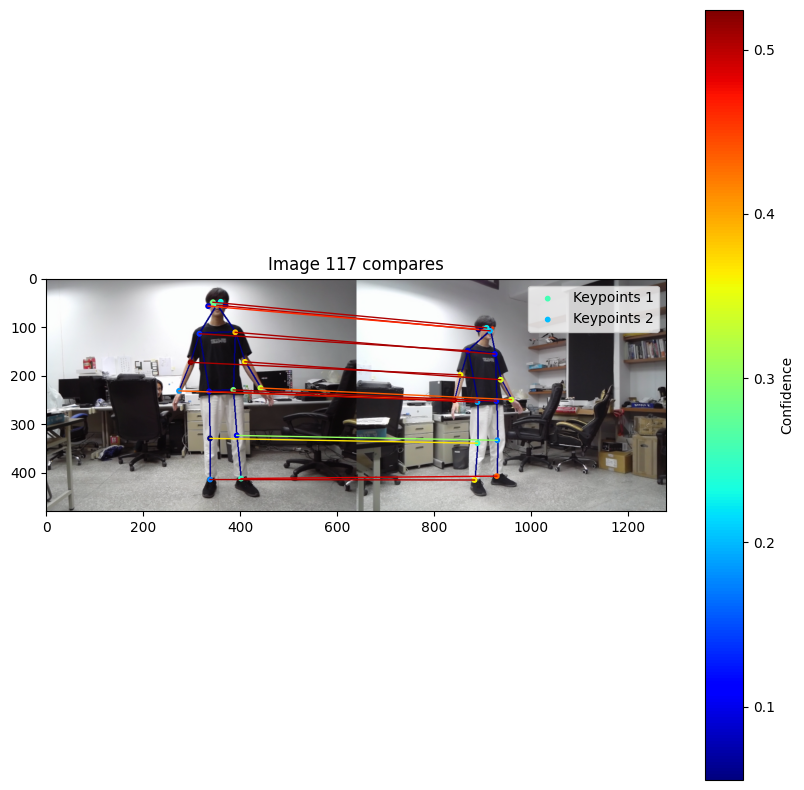

1189.5674044265593
1783.8809073724008
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205358_0098.png: (17, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205358_0098.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205358_0098.png: (256, 17)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205358_0098.png: (256, 15)


14 of keypoints are match


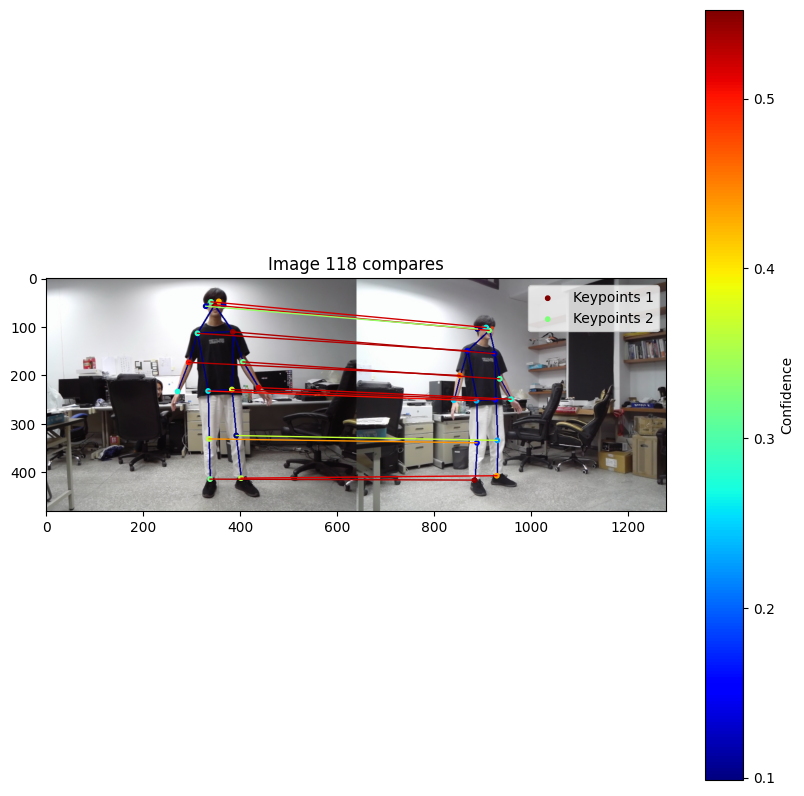

1409.282208588957
1775.8996212121212
filtered_keypoints_1.shape for data\cam1_pose\cam1_20241014_205358_0099.png: (16, 2)
filtered_keypoints_2.shape for data\cam2_pose\cam2_20241014_205358_0099.png: (15, 2)
descriptors_hrt1.shape for data\cam1_pose\cam1_20241014_205358_0099.png: (256, 16)
descriptors_hrt2.shape for data\cam2_pose\cam2_20241014_205358_0099.png: (256, 15)


14 of keypoints are match


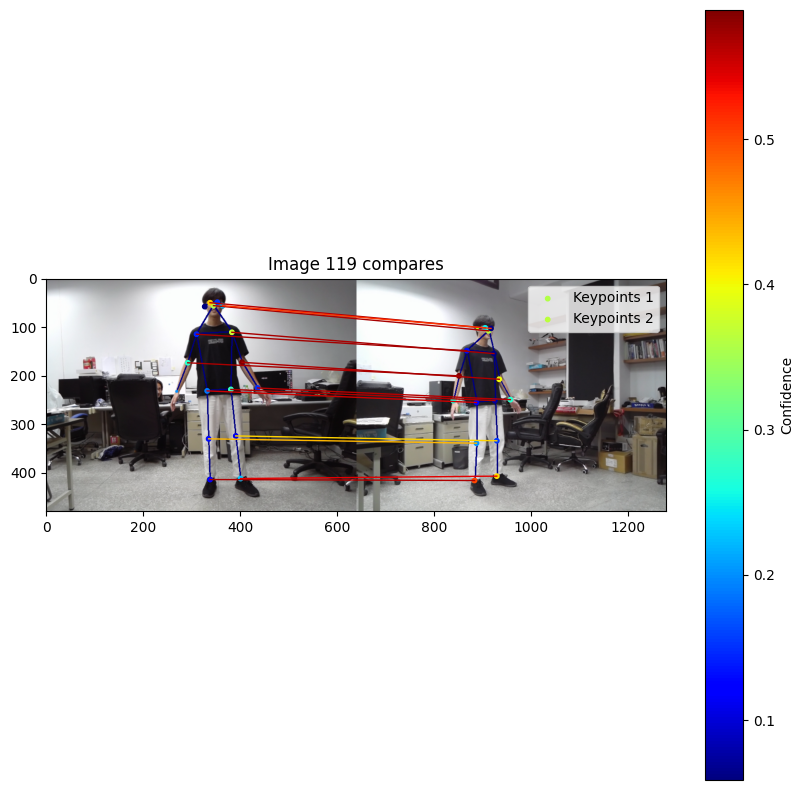

In [51]:
counting_image = 0
#creating a new txt file
f = open(f"{folder_match}.txt", "w")

for line_2 in lines_2:
    matching_line_1 = next((line for line in lines_1 if line[first_index:second_index] == line_2[first_index:second_index]), None)
    if matching_line_1:
        #Create a new txt file storing the joints


        # Use regex to split the address and coordinates
        match1 = re.match(r'([^ ]+) (\[\[.*\]\])', matching_line_1) 
        if match1:
            address1 = match1.group(1)
            hrnet_coor1 = eval(match1.group(2))  # Convert the string of coordinates to a list of lists
        match2 = re.match(r'([^ ]+) (\[\[.*\]\])', line_2)
        if match2:
            address2 = match2.group(1)
            hrnet_coor2 = eval(match2.group(2))  # Convert the string of coordinates to a list of lists
        # print(f"{address1, coordinates1}\n with {address2,coordinates2}")

        superglue1 = superpoint_process(address1) #returns [keypoints, scores, descriptors, image_tensor]
        superglue2 = superpoint_process(address2)
        
        # matching_keypoints and indices
        filtered_keypoints_1, indices_hrt1 = get_matching_keypoints_indices(hrnet_coor1, superglue1[0], tolerance_range=5)
        filtered_keypoints_2, indices_hrt2 = get_matching_keypoints_indices(hrnet_coor2, superglue2[0], tolerance_range=5)

        score_hrt1 = superglue1[1][indices_hrt1]
        score_hrt2 = superglue2[1][indices_hrt2]

        descriptors_hrt1 = superglue1[2][:, indices_hrt1]
        descriptors_hrt2 = superglue2[2][:, indices_hrt2]

        print(f"filtered_keypoints_1.shape for {address1}: {np.array(filtered_keypoints_1).shape}")
        print(f"filtered_keypoints_2.shape for {address2}: {np.array(filtered_keypoints_2).shape}")
        print(f"descriptors_hrt1.shape for {address1}: {descriptors_hrt1.shape}")
        print(f"descriptors_hrt2.shape for {address2}: {descriptors_hrt2.shape}")
        print("\n")
        
        matches, num_matches, confidences = match_features(
            superglue1[3], filtered_keypoints_1, descriptors_hrt1, score_hrt1,
            superglue2[3], filtered_keypoints_2, descriptors_hrt2, score_hrt2,
            superglue
        )

        image1_path = address1
        image1 = cv2.imread(image1_path)
        if image1 is None:
            raise FileNotFoundError(f"Image at {image1_path} could not be loaded.")

        image1_rgb = cv2.cvtColor(image1, cv2.COLOR_BGR2RGB)

        image2_path = address2
        image2 = cv2.imread(image2_path)
        if image2 is None:
            raise FileNotFoundError(f"Image at {image2_path} could not be loaded.")

        image2_rgb = cv2.cvtColor(image2, cv2.COLOR_BGR2RGB)

        print(f'{num_matches} of keypoints are match')
        keypoints_match = return_match_keypoints(filtered_keypoints_1, filtered_keypoints_2, matches,confidences)
        output = f"match keypoints image{counting_image}" + " " + str(keypoints_match) + '"\n'
        f.write(output)

        # Visualize matches
        visualize_matches(image1_rgb, filtered_keypoints_1, image2_rgb, filtered_keypoints_2, matches, score_hrt1, score_hrt2, confidences, counting_image)
        counting_image += 1

#closing txt file
f.close()